In [65]:
import os
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from __future__ import print_function
import pandas as pd
import shutil
import sys
import random
import seaborn as sns
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix


In [66]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [67]:
labels = pd.read_csv(r'/content/drive/MyDrive/charts/charts/charts/train_val.csv')

train_dir =r'/content/drive/MyDrive/charts/charts/charts/train_val'
DR = r"/content/drive/MyDrive/charts/charts/charts/train"
if not os.path.exists(DR):
    os.mkdir(DR)
for filename, class_name in labels.values:
    # Create subdirectory with `class_name`
    if not os.path.exists(DR +"/"+ str(class_name)):
        os.mkdir(DR +"/"+ str(class_name))
    src_path = train_dir + '/'+ str(filename) + '.png'
    dst_path = DR +"/"+ str(class_name) + '/' + str(filename) + '.png'
    try:
        shutil.copy(src_path, dst_path)
        
    except IOError as e:
        print('Unable to copy file {} to {}'
              .format(src_path, dst_path))
    except:
        print('When try copy file {} to {}, unexpected error: {}'
              .format(src_path, dst_path, sys.exc_info()))

In [68]:
data = pd.read_csv(r'/content/drive/MyDrive/charts/charts/charts/train_val.csv')

In [69]:
# set path to parent folder
parent_folder = "/content/drive/MyDrive/charts/charts/charts/train"

# iterate through subfolders and count number of images
for folder in os.listdir(parent_folder):
    folder_path = os.path.join(parent_folder, folder)
    if os.path.isdir(folder_path):
        num_images = len([filename for filename in os.listdir(folder_path) if filename.endswith(".png")])
        print("Folder {} contains {} images".format(folder, num_images))

Folder vbar_categorical contains 200 images
Folder hbar_categorical contains 200 images
Folder line contains 200 images
Folder pie contains 200 images
Folder dot_line contains 200 images


In [70]:
root_dir = '/content/drive/MyDrive/charts/charts/charts/train'
train_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/train'
val_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/val'

# Create the train and val directories
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)

# Define the subfolders
subfolders = ['vbar_categorical', 'hbar_categorical', 'line', 'pie', 'dot_line']

# Create subdirectories in train and val directories
for subfolder in subfolders:
    os.makedirs(os.path.join(train_dir, subfolder), exist_ok=True)
    os.makedirs(os.path.join(val_dir, subfolder), exist_ok=True)

# Split the data into train and val sets
for subfolder in subfolders:
    files = os.listdir(os.path.join(root_dir, subfolder))
    random.shuffle(files)
    train_files = files[:160] # 80% for training
    val_files = files[160:] # 20% for validation
    
    # Copy train files to train directory
    for file_name in train_files:
        src_path = os.path.join(root_dir, subfolder, file_name)
        dst_path = os.path.join(train_dir, subfolder, file_name)
        shutil.copy(src_path, dst_path)
    
    # Copy val files to val directory
    for file_name in val_files:
        src_path = os.path.join(root_dir, subfolder, file_name)
        dst_path = os.path.join(val_dir, subfolder, file_name)
        shutil.copy(src_path, dst_path)


In [71]:
# set path to parent folder
parent_folder = "/content/drive/MyDrive/charts/charts/charts/train_split/train"

# iterate through subfolders and count number of images
for folder in os.listdir(parent_folder):
    folder_path = os.path.join(parent_folder, folder)
    if os.path.isdir(folder_path):
        num_images = len([filename for filename in os.listdir(folder_path) if filename.endswith(".png")])
        print("Folder {} contains {} images".format(folder, num_images))

Folder vbar_categorical contains 160 images
Folder hbar_categorical contains 160 images
Folder line contains 160 images
Folder pie contains 160 images
Folder dot_line contains 160 images


In [72]:
# set path to parent folder
parent_folder = "/content/drive/MyDrive/charts/charts/charts/train_split/val"

# iterate through subfolders and count number of images
for folder in os.listdir(parent_folder):
    folder_path = os.path.join(parent_folder, folder)
    if os.path.isdir(folder_path):
        num_images = len([filename for filename in os.listdir(folder_path) if filename.endswith(".png")])
        print("Folder {} contains {} images".format(folder, num_images))

Folder vbar_categorical contains 40 images
Folder hbar_categorical contains 40 images
Folder line contains 40 images
Folder pie contains 40 images
Folder dot_line contains 40 images


In [73]:
test_dir = '/content/drive/MyDrive/charts/charts/charts/test'

chart_types = {
    0: 'dot_line',
    1: 'hbar_categorical',
    2: 'line',
    3: 'pie',
    4: 'vbar_categorical'

}

def predict_labels(test_dir, model):
    # Get the list of image files in the test directory
    image_files = os.listdir(test_dir)
    num_images = len(image_files)
    
    # Preprocess the images and make predictions on them
    predictions = []
    for i in range(num_images):
        img_path = os.path.join(test_dir, image_files[i])
        img = image.load_img(img_path, target_size=(224, 224))
        img_array = image.img_to_array(img) / 255.0
        img_batch = np.expand_dims(img_array, axis=0)
        prediction = model.predict(img_batch)
        label = np.argmax(prediction)
        print(f"Prediction for {image_files[i]}: {chart_types[label]}")
        # Convert the image to a NumPy array
        img_array = np.array(img)
        # Plot the image using matplotlib
        plt.imshow(img)
        plt.show()
        predictions.append(chart_types[label])
    print(predictions)

In [74]:
# Set the seed for reproducibility
tf.random.set_seed(42)

# Define the data directory paths
train_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/train'
val_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/val'

# Define the parameters for the data generator
batch_size = 32
img_height = 224
img_width = 224

# Create the training data generator
train_data_gen = keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255
)

# Create the validation data generator
val_data_gen = keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255
)

# Generate the training data from the directory
train_data = train_data_gen.flow_from_directory(
    train_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

# Generate the validation data from the directory
val_data = val_data_gen.flow_from_directory(
    val_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

# Define the CNN architecture
model = keras.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(5, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
history = model.fit(
    train_data,
    validation_data=val_data,
    epochs=20
)


Found 800 images belonging to 5 classes.
Found 200 images belonging to 5 classes.
Epoch 1/20
25/25 [==============================] - 4s 120ms/step - loss: 3.3571 - accuracy: 0.4275 - val_loss: 0.4748 - val_accuracy: 0.7850
Epoch 2/20
25/25 [==============================] - 3s 114ms/step - loss: 0.3392 - accuracy: 0.8487 - val_loss: 0.2432 - val_accuracy: 0.9400
Epoch 3/20
25/25 [==============================] - 4s 142ms/step - loss: 0.1757 - accuracy: 0.9438 - val_loss: 0.1455 - val_accuracy: 0.9550
Epoch 4/20
25/25 [==============================] - 3s 139ms/step - loss: 0.0761 - accuracy: 0.9837 - val_loss: 0.0834 - val_accuracy: 0.9750
Epoch 5/20
25/25 [==============================] - 3s 117ms/step - loss: 0.0253 - accuracy: 0.9987 - val_loss: 0.0524 - val_accuracy: 0.9900
Epoch 6/20
25/25 [==============================] - 3s 117ms/step - loss: 0.0108 - accuracy: 0.9987 - val_loss: 0.0358 - val_accuracy: 0.9900
Epoch 7/20
25/25 [==============================] - 3s 115ms/step 

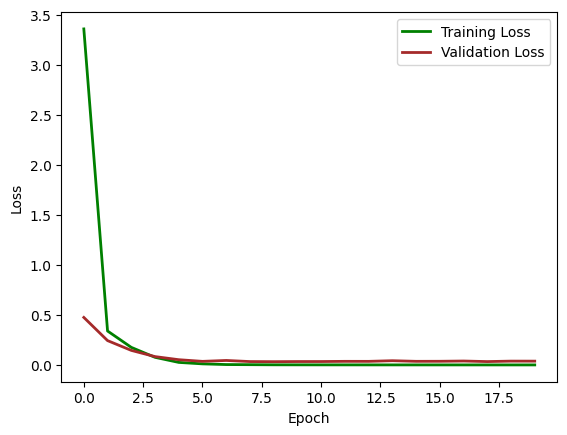

In [76]:
plt.plot(history.history['loss'], label='Training Loss',color='green', linewidth=2)
plt.plot(history.history['val_loss'], label='Validation Loss',color='brown', linewidth=2)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

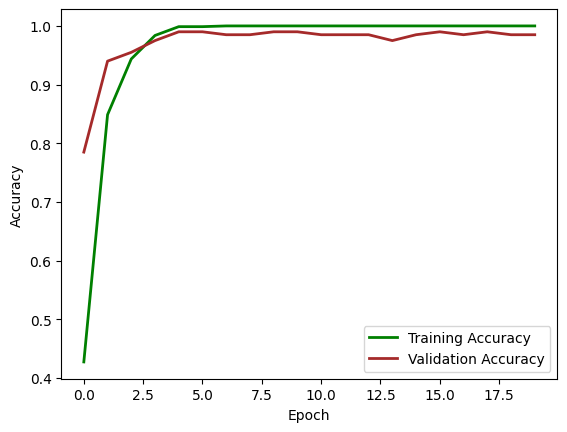

In [77]:
plt.plot(history.history['accuracy'], label='Training Accuracy', color='green', linewidth=2)
plt.plot(history.history['val_accuracy'], label='Validation Accuracy', color='brown', linewidth=2)
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


7/7 [==============================] - 1s 77ms/step
conf_matrix :  

[[34, 3, 3, 0, 0], [0, 36, 0, 2, 2], [0, 0, 38, 1, 1], [0, 0, 4, 36, 0], [0, 0, 1, 4, 35]] 



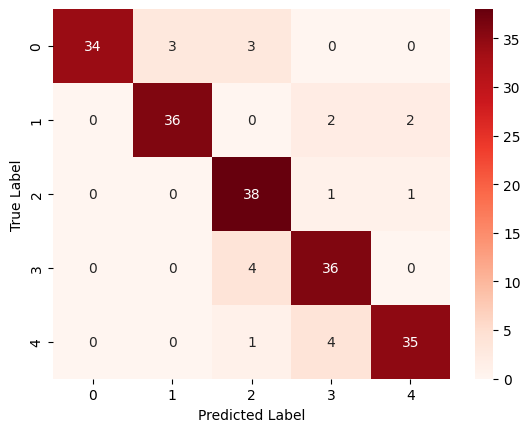

In [79]:
# Evaluate the model on the validation data
val_loss, val_acc = model.evaluate(val_data)

# Predict the labels for the validation data
y_pred = model.predict(val_data)
y_pred_classes = np.argmax(y_pred, axis=1)

# Get the true labels for the validation data
y_true = val_data.classes

# Calculate the confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred_classes)

# Print the confusion matrix
print("conf_matrix : ","\n")
print(conf_matrix,"\n")
sns.heatmap(conf_matrix, annot=True, cmap="Reds", fmt="d")
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


1/1 [==============================] - 0s 69ms/step
Prediction for 963.png: dot_line


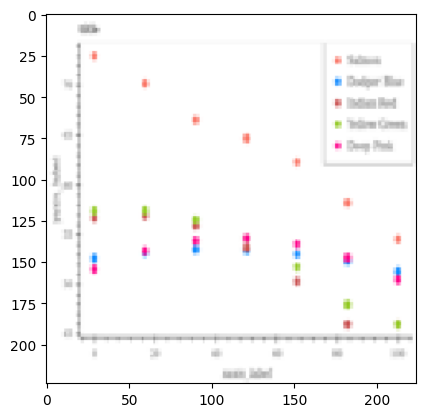

1/1 [==============================] - 0s 25ms/step
Prediction for 883.png: dot_line


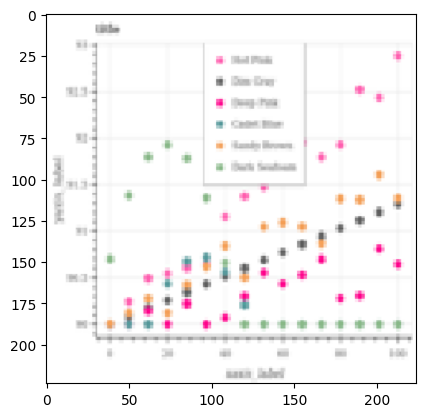

1/1 [==============================] - 0s 21ms/step
Prediction for 856.png: dot_line


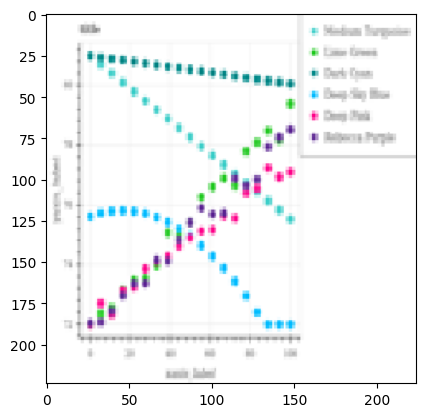

1/1 [==============================] - 0s 19ms/step
Prediction for 908.png: dot_line


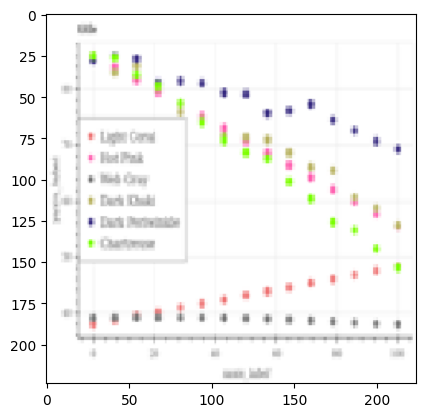

1/1 [==============================] - 0s 21ms/step
Prediction for 812.png: dot_line


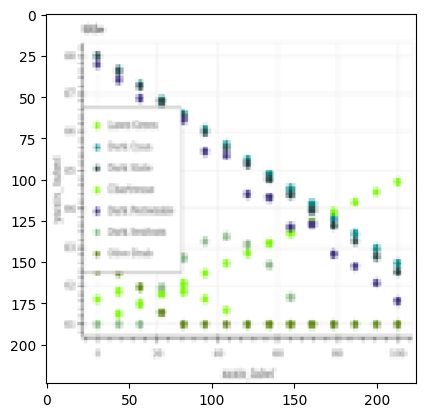

1/1 [==============================] - 0s 20ms/step
Prediction for 815.png: dot_line


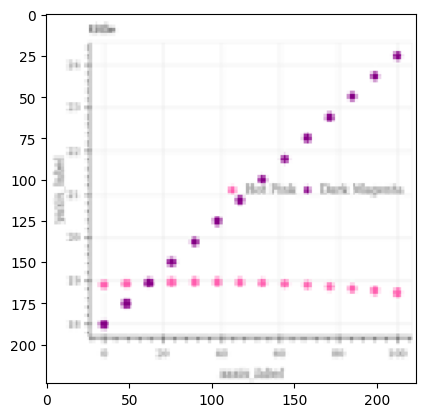

1/1 [==============================] - 0s 21ms/step
Prediction for 869.png: dot_line


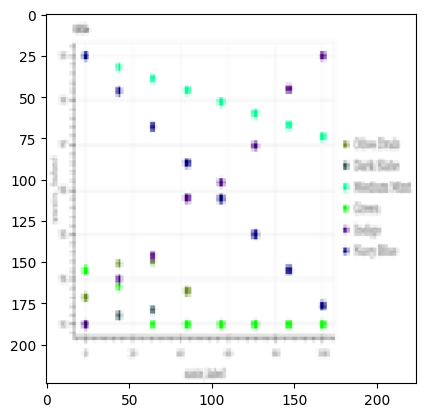

1/1 [==============================] - 0s 21ms/step
Prediction for 800.png: dot_line


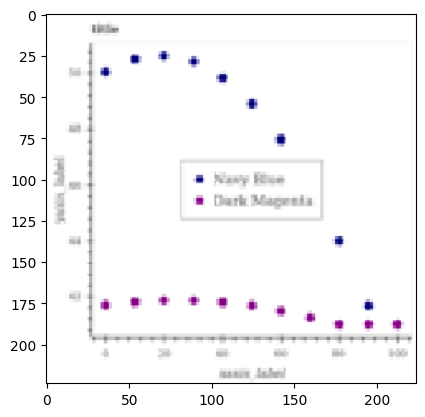

1/1 [==============================] - 0s 21ms/step
Prediction for 871.png: line


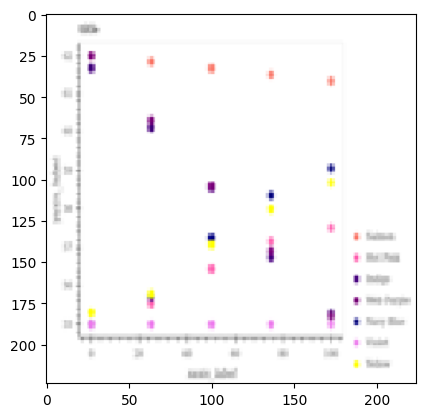

1/1 [==============================] - 0s 20ms/step
Prediction for 958.png: dot_line


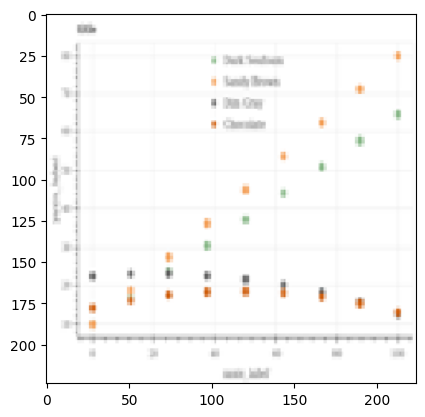

1/1 [==============================] - 0s 19ms/step
Prediction for 804.png: dot_line


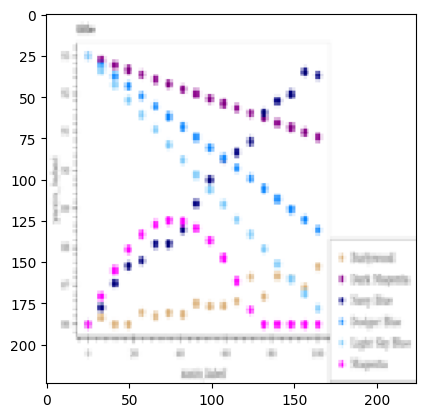

1/1 [==============================] - 0s 21ms/step
Prediction for 867.png: dot_line


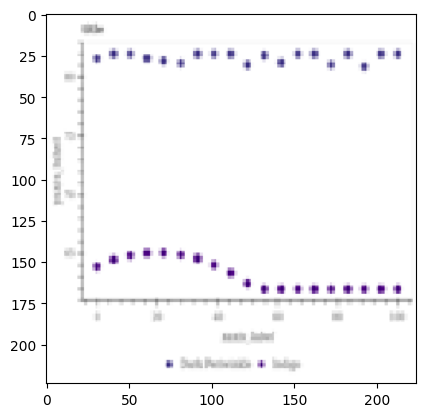

1/1 [==============================] - 0s 21ms/step
Prediction for 982.png: dot_line


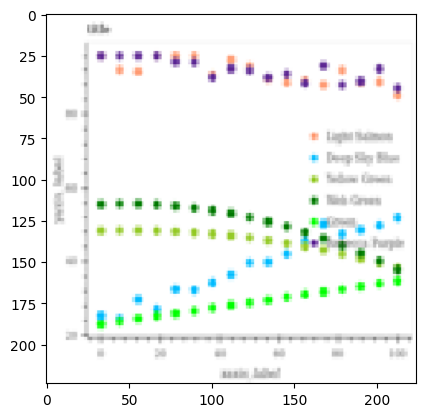

1/1 [==============================] - 0s 23ms/step
Prediction for 820.png: dot_line


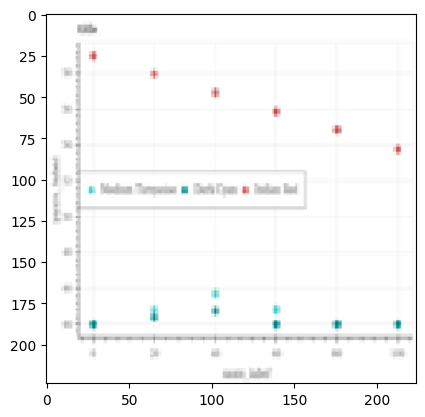

1/1 [==============================] - 0s 22ms/step
Prediction for 847.png: dot_line


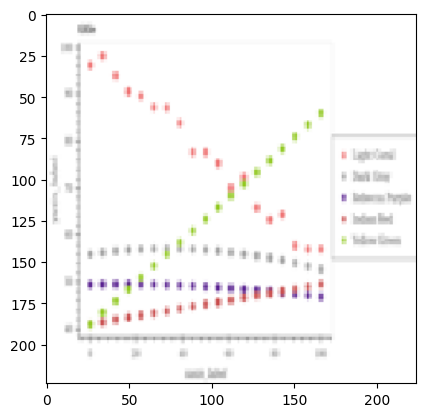

1/1 [==============================] - 0s 21ms/step
Prediction for 975.png: dot_line


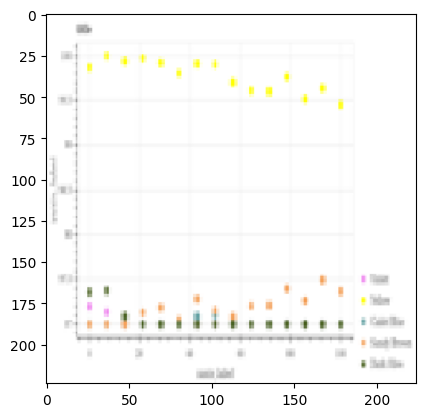

1/1 [==============================] - 0s 26ms/step
Prediction for 827.png: dot_line


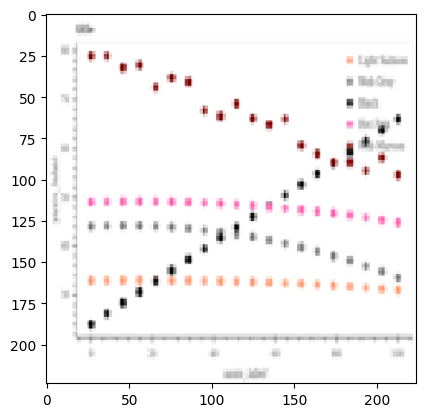

1/1 [==============================] - 0s 25ms/step
Prediction for 805.png: line


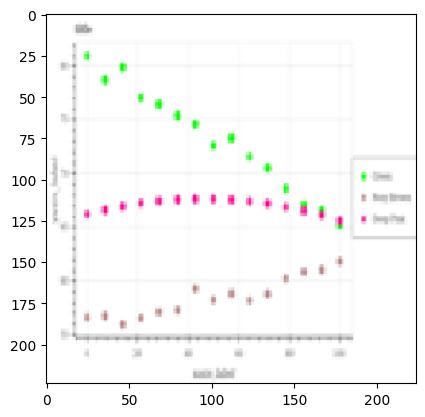

1/1 [==============================] - 0s 20ms/step
Prediction for 943.png: dot_line


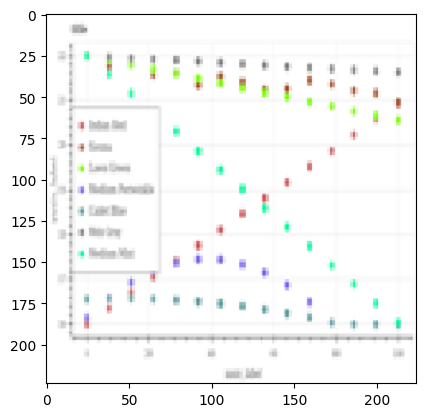

1/1 [==============================] - 0s 19ms/step
Prediction for 844.png: dot_line


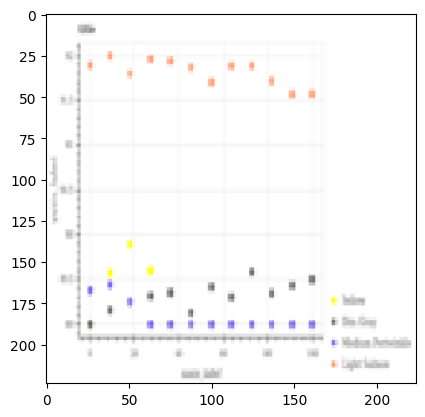

1/1 [==============================] - 0s 19ms/step
Prediction for 934.png: dot_line


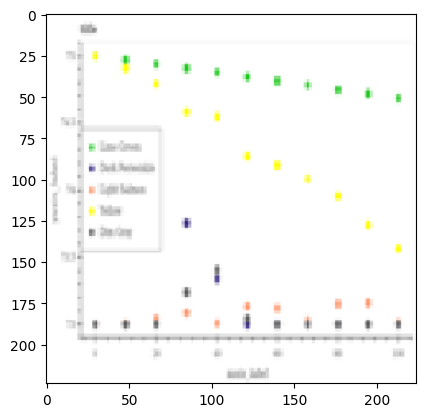

1/1 [==============================] - 0s 30ms/step
Prediction for 998.png: dot_line


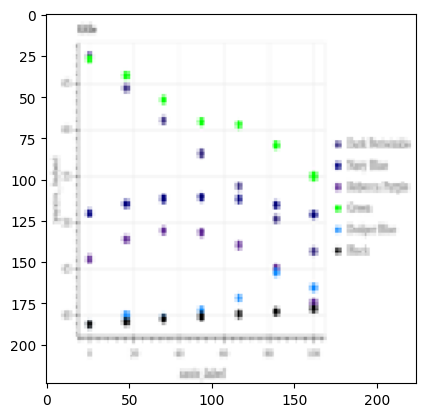

1/1 [==============================] - 0s 31ms/step
Prediction for 966.png: dot_line


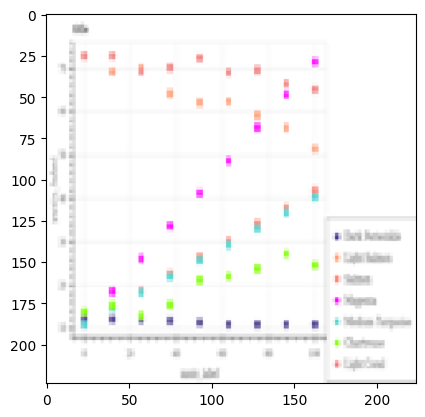

1/1 [==============================] - 0s 38ms/step
Prediction for 988.png: dot_line


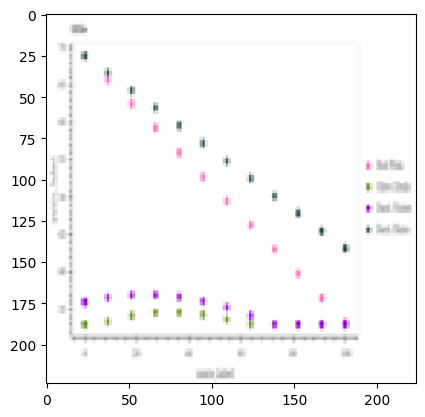

1/1 [==============================] - 0s 28ms/step
Prediction for 801.png: dot_line


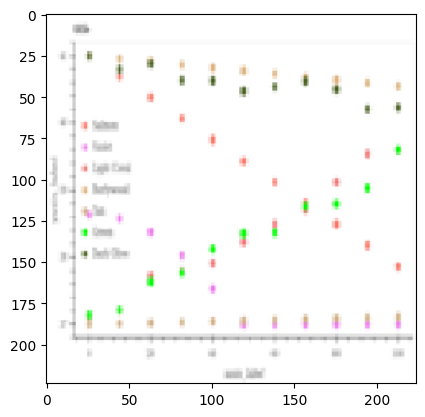

1/1 [==============================] - 0s 30ms/step
Prediction for 907.png: dot_line


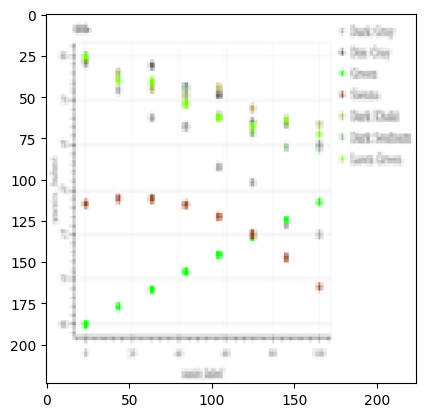

1/1 [==============================] - 0s 34ms/step
Prediction for 846.png: dot_line


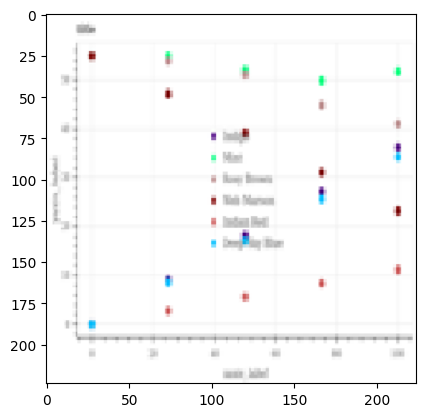

1/1 [==============================] - 0s 29ms/step
Prediction for 976.png: dot_line


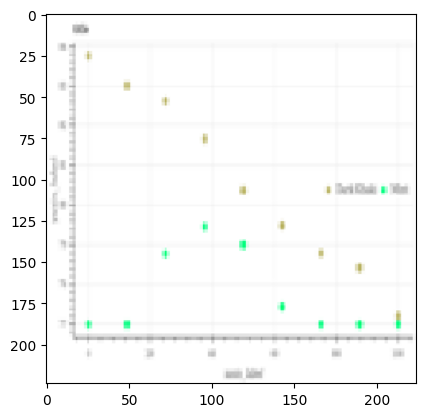

1/1 [==============================] - 0s 30ms/step
Prediction for 873.png: dot_line


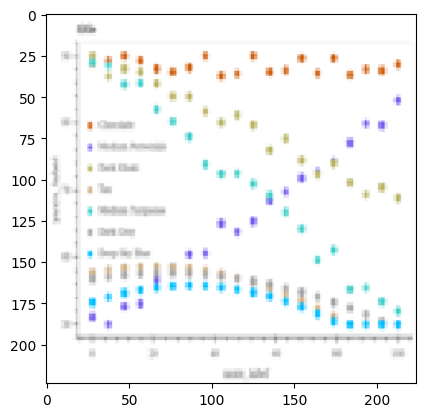

1/1 [==============================] - 0s 31ms/step
Prediction for 969.png: dot_line


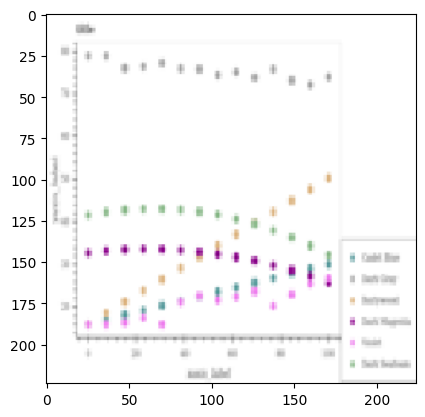

1/1 [==============================] - 0s 27ms/step
Prediction for 973.png: dot_line


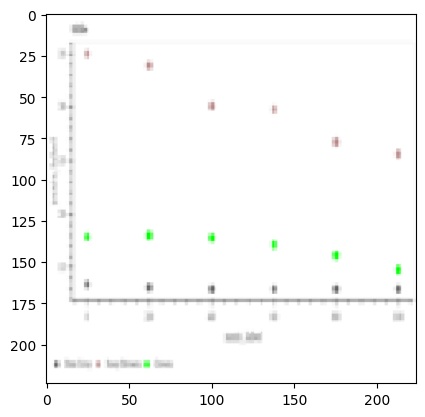

1/1 [==============================] - 0s 28ms/step
Prediction for 876.png: dot_line


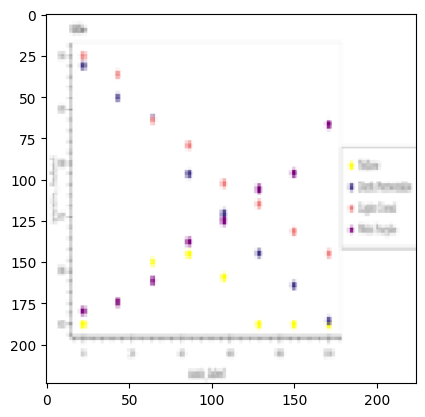

1/1 [==============================] - 0s 30ms/step
Prediction for 902.png: dot_line


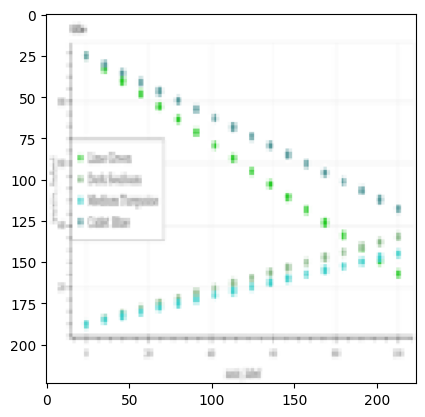

1/1 [==============================] - 0s 21ms/step
Prediction for 951.png: dot_line


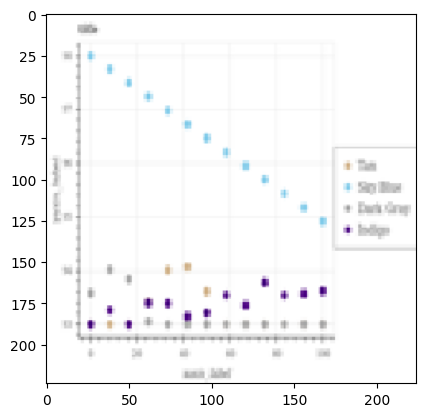

1/1 [==============================] - 0s 19ms/step
Prediction for 851.png: dot_line


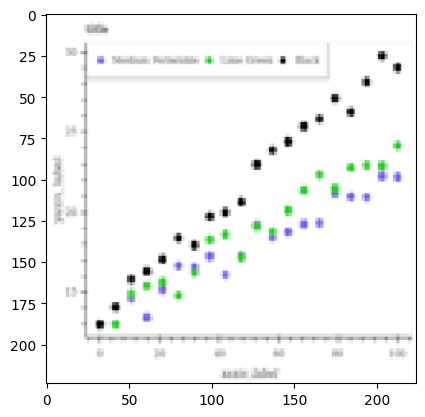

1/1 [==============================] - 0s 27ms/step
Prediction for 933.png: dot_line


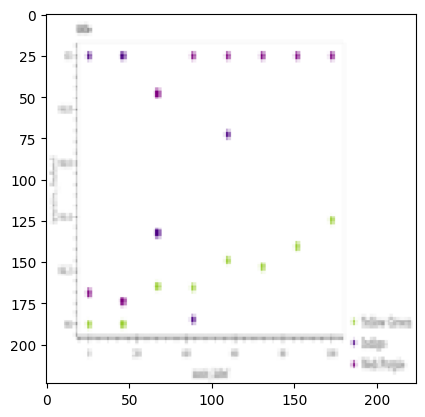

1/1 [==============================] - 0s 33ms/step
Prediction for 928.png: dot_line


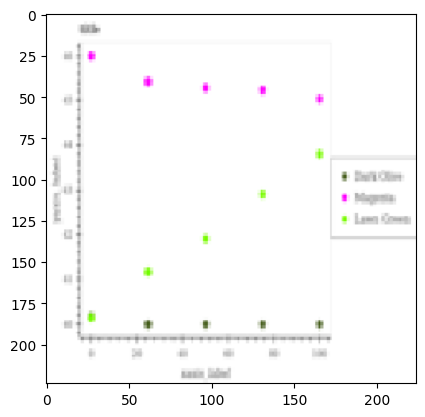

1/1 [==============================] - 0s 115ms/step
Prediction for 921.png: dot_line


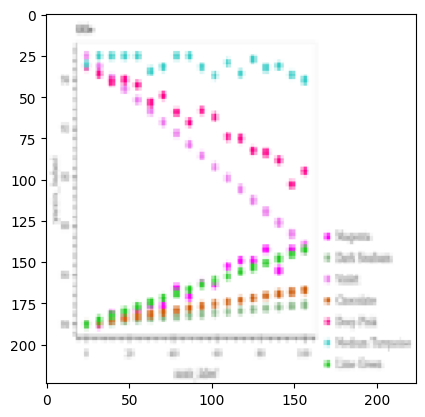

1/1 [==============================] - 0s 35ms/step
Prediction for 939.png: line


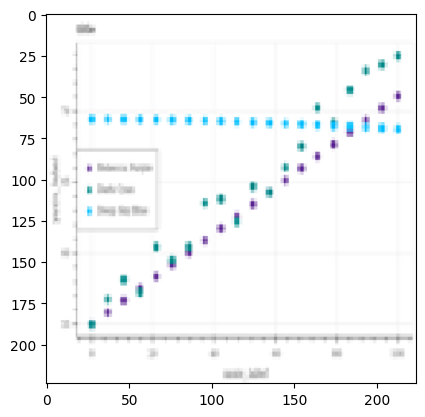

1/1 [==============================] - 0s 19ms/step
Prediction for 888.png: dot_line


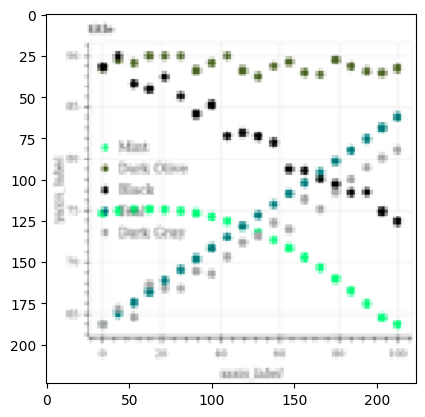

['dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'dot_line', 'line', 'dot_line']


In [80]:
dot_line = '/content/drive/MyDrive/charts/charts/charts/train_split/val/dot_line'
predict_labels(dot_line, model)

1/1 [==============================] - 0s 21ms/step
Prediction for 307.png: hbar_categorical


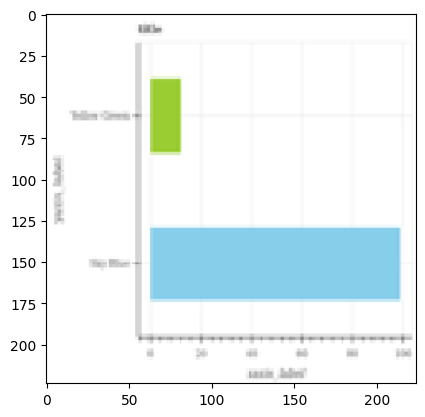

1/1 [==============================] - 0s 21ms/step
Prediction for 211.png: hbar_categorical


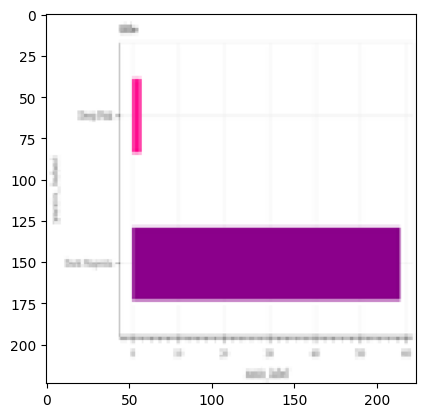

1/1 [==============================] - 0s 19ms/step
Prediction for 330.png: hbar_categorical


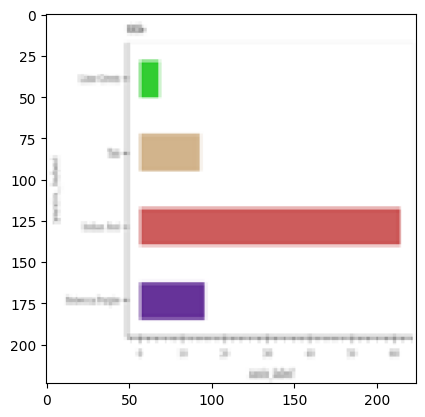

1/1 [==============================] - 0s 19ms/step
Prediction for 264.png: hbar_categorical


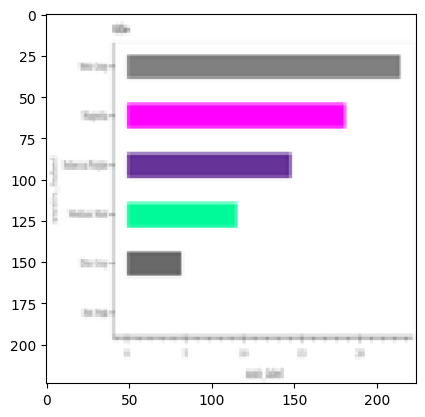

1/1 [==============================] - 0s 19ms/step
Prediction for 295.png: hbar_categorical


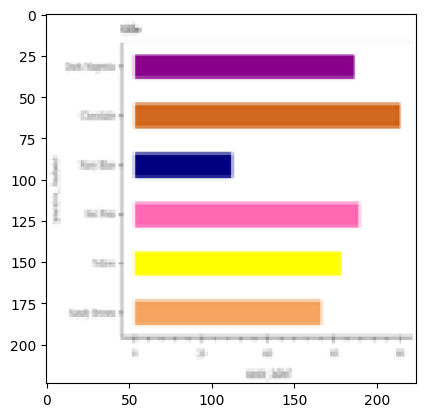

1/1 [==============================] - 0s 22ms/step
Prediction for 260.png: hbar_categorical


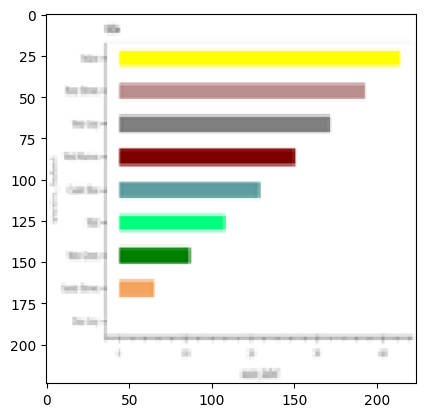

1/1 [==============================] - 0s 19ms/step
Prediction for 226.png: hbar_categorical


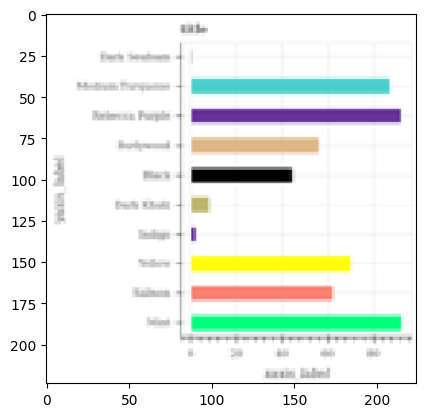

1/1 [==============================] - 0s 21ms/step
Prediction for 236.png: hbar_categorical


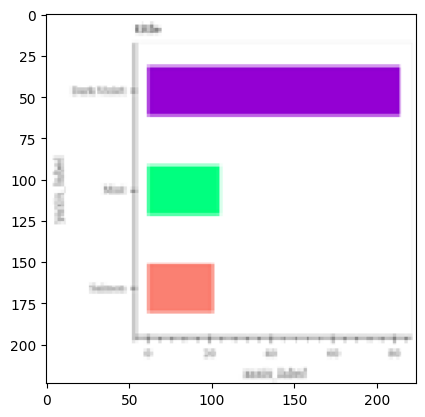

1/1 [==============================] - 0s 23ms/step
Prediction for 339.png: hbar_categorical


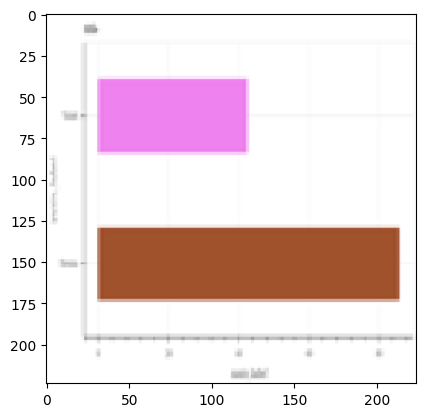

1/1 [==============================] - 0s 21ms/step
Prediction for 296.png: hbar_categorical


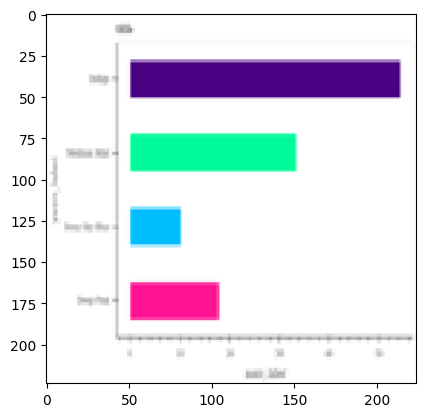

1/1 [==============================] - 0s 19ms/step
Prediction for 371.png: hbar_categorical


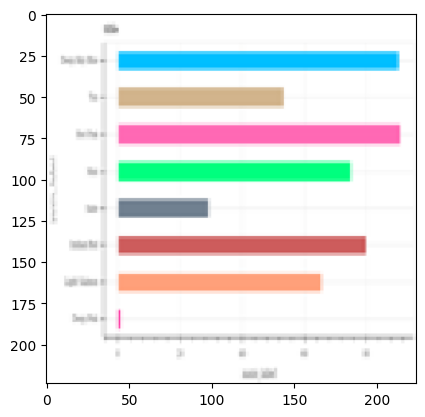

1/1 [==============================] - 0s 19ms/step
Prediction for 284.png: hbar_categorical


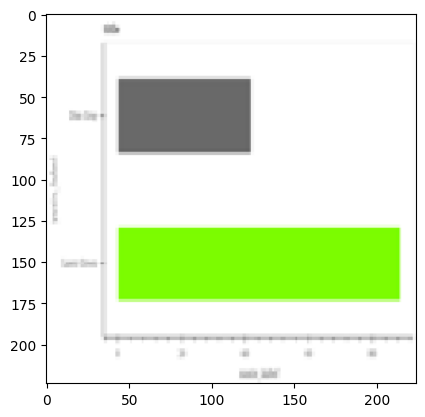

1/1 [==============================] - 0s 22ms/step
Prediction for 293.png: hbar_categorical


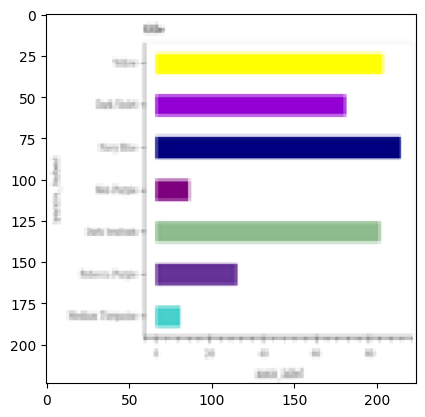

1/1 [==============================] - 0s 21ms/step
Prediction for 306.png: hbar_categorical


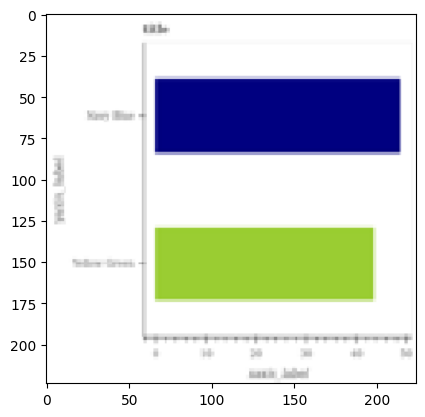

1/1 [==============================] - 0s 28ms/step
Prediction for 319.png: hbar_categorical


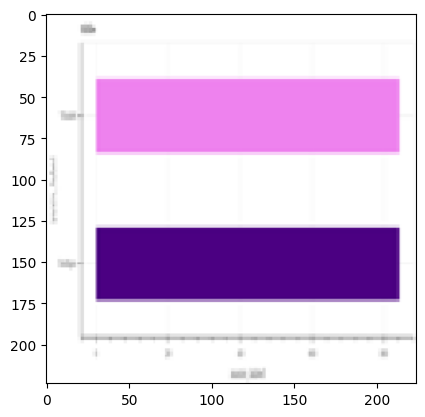

1/1 [==============================] - 0s 26ms/step
Prediction for 396.png: hbar_categorical


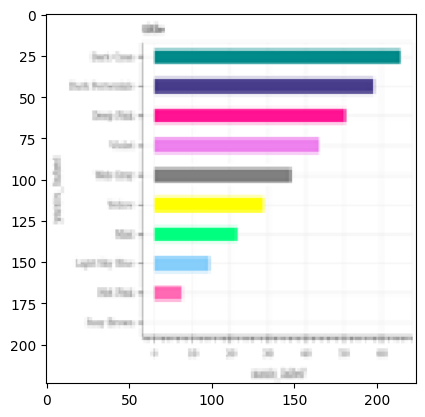

1/1 [==============================] - 0s 28ms/step
Prediction for 212.png: hbar_categorical


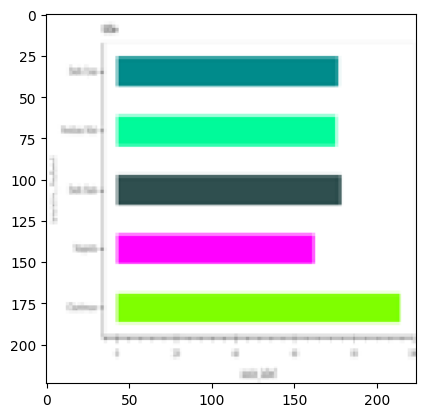

1/1 [==============================] - 0s 46ms/step
Prediction for 238.png: hbar_categorical


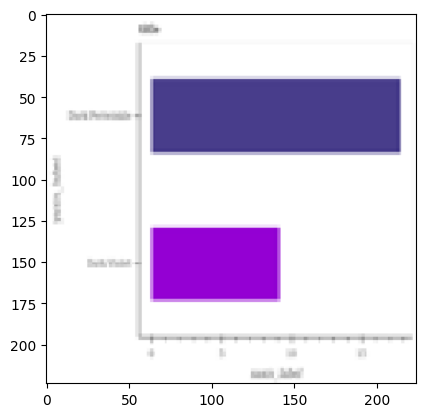

1/1 [==============================] - 0s 29ms/step
Prediction for 287.png: hbar_categorical


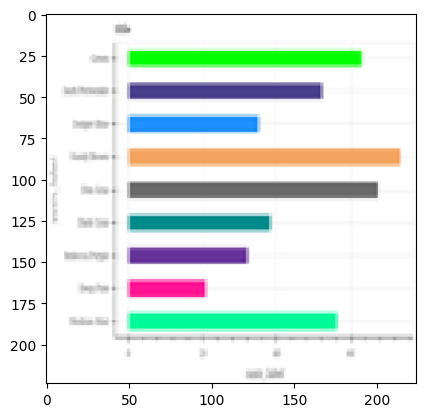

1/1 [==============================] - 0s 28ms/step
Prediction for 308.png: hbar_categorical


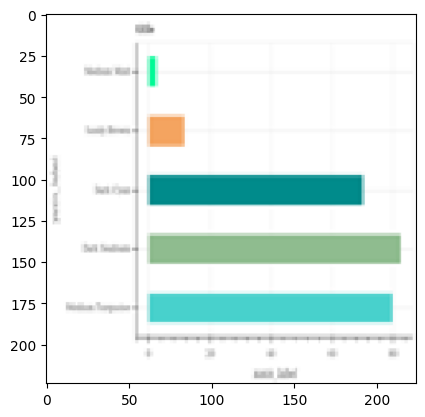

1/1 [==============================] - 0s 28ms/step
Prediction for 202.png: hbar_categorical


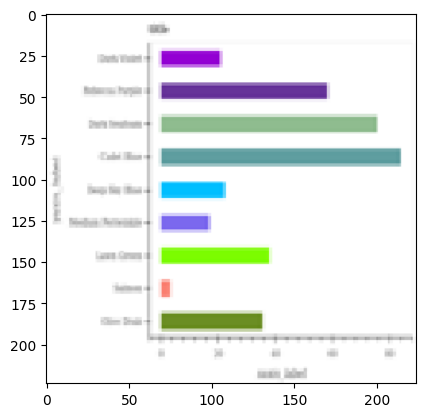

1/1 [==============================] - 0s 34ms/step
Prediction for 318.png: hbar_categorical


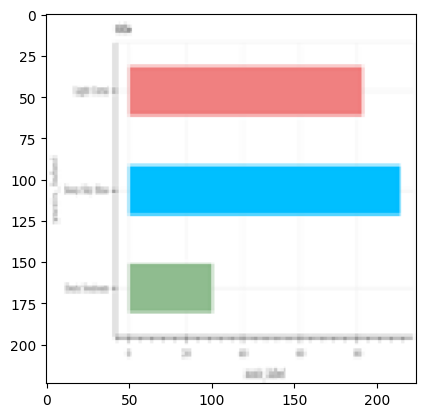

1/1 [==============================] - 0s 31ms/step
Prediction for 235.png: hbar_categorical


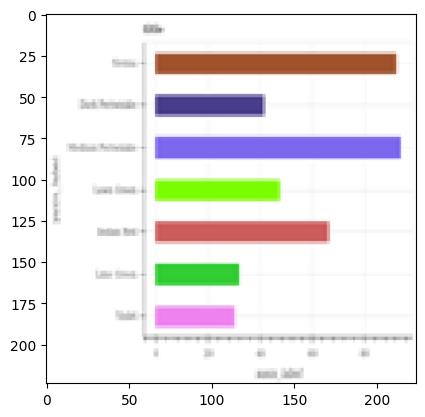

1/1 [==============================] - 0s 22ms/step
Prediction for 288.png: hbar_categorical


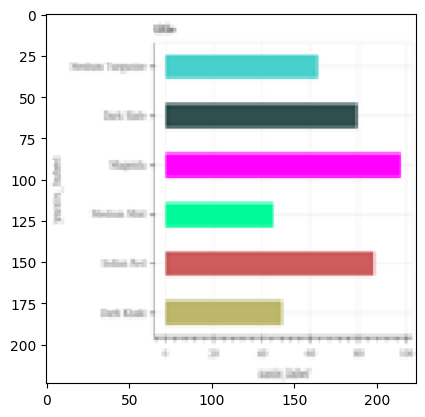

1/1 [==============================] - 0s 19ms/step
Prediction for 385.png: hbar_categorical


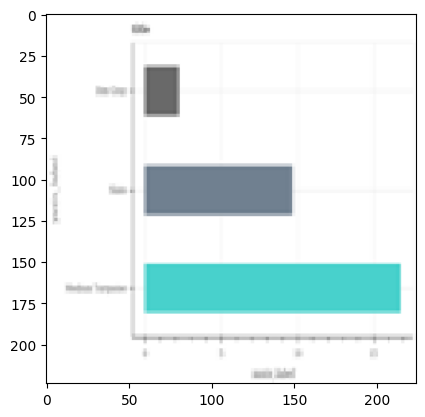

1/1 [==============================] - 0s 26ms/step
Prediction for 361.png: hbar_categorical


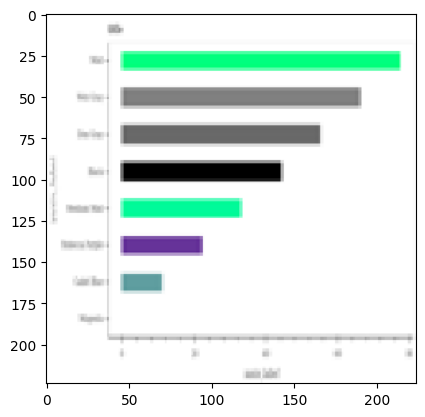

1/1 [==============================] - 0s 22ms/step
Prediction for 221.png: hbar_categorical


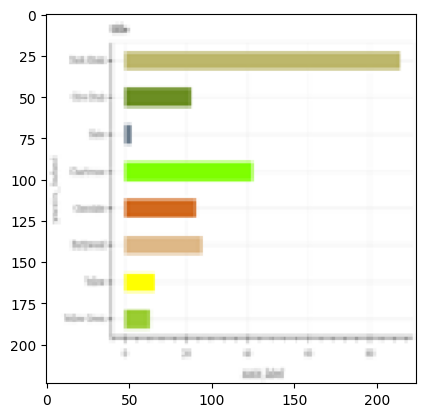

1/1 [==============================] - 0s 22ms/step
Prediction for 259.png: hbar_categorical


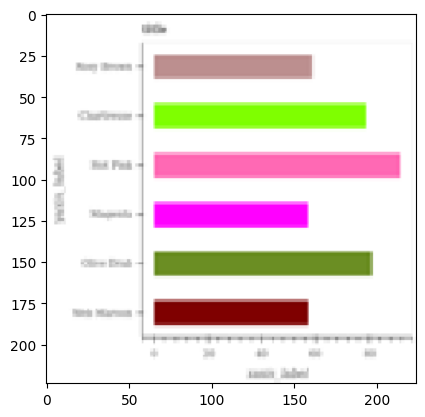

1/1 [==============================] - 0s 20ms/step
Prediction for 210.png: hbar_categorical


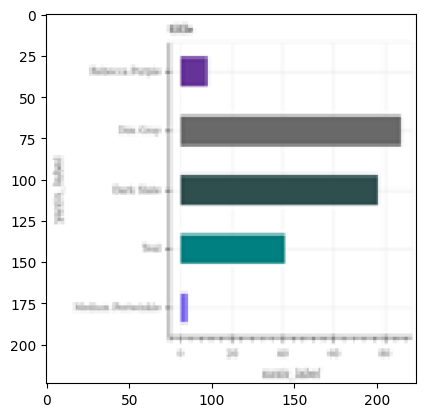

1/1 [==============================] - 0s 25ms/step
Prediction for 327.png: hbar_categorical


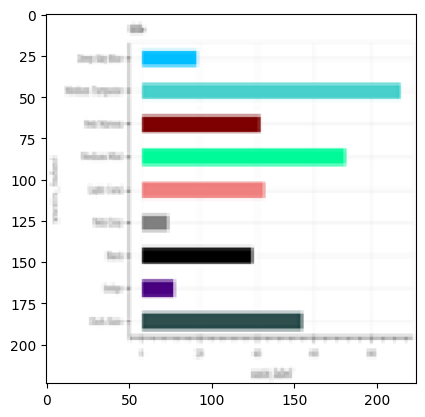

1/1 [==============================] - 0s 22ms/step
Prediction for 205.png: hbar_categorical


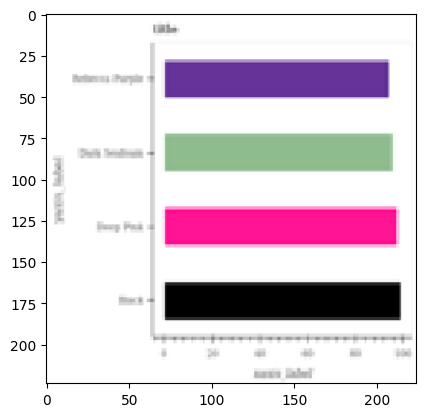

1/1 [==============================] - 0s 20ms/step
Prediction for 301.png: hbar_categorical


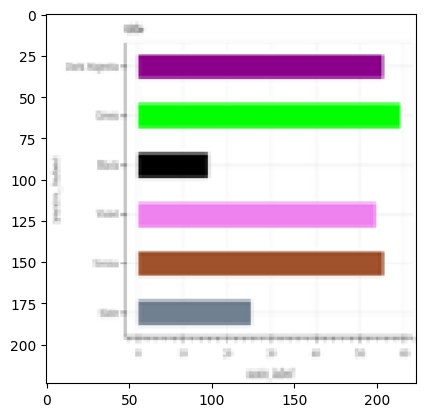

1/1 [==============================] - 0s 20ms/step
Prediction for 340.png: hbar_categorical


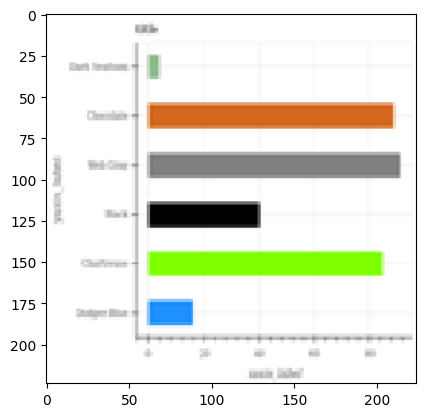

1/1 [==============================] - 0s 18ms/step
Prediction for 268.png: hbar_categorical


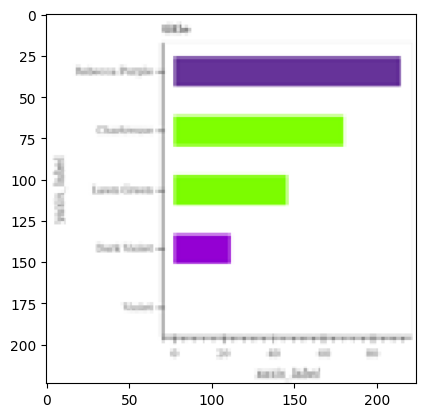

1/1 [==============================] - 0s 21ms/step
Prediction for 294.png: hbar_categorical


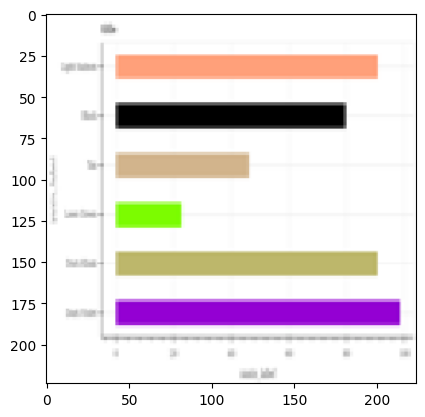

1/1 [==============================] - 0s 23ms/step
Prediction for 299.png: hbar_categorical


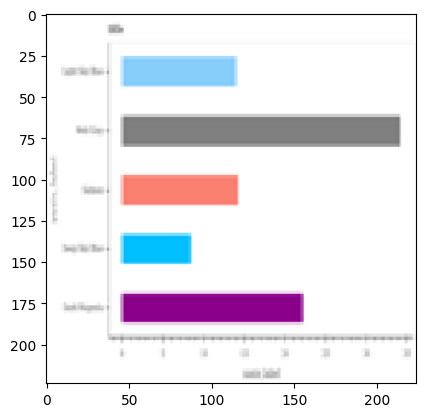

1/1 [==============================] - 0s 20ms/step
Prediction for 272.png: hbar_categorical


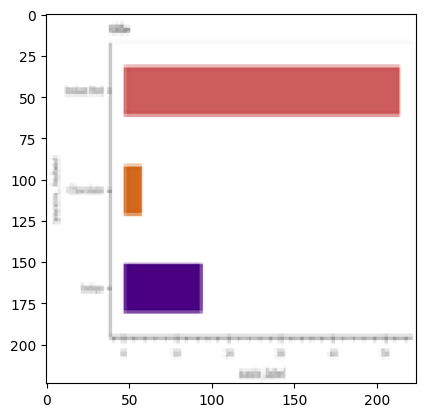

1/1 [==============================] - 0s 19ms/step
Prediction for 220.png: hbar_categorical


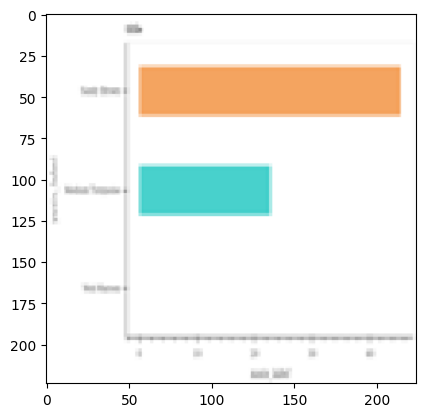

1/1 [==============================] - 0s 20ms/step
Prediction for 222.png: hbar_categorical


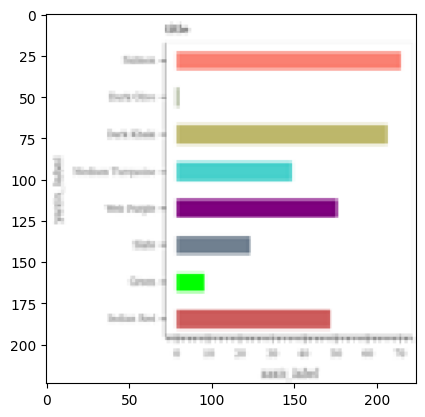

1/1 [==============================] - 0s 20ms/step
Prediction for 313.png: hbar_categorical


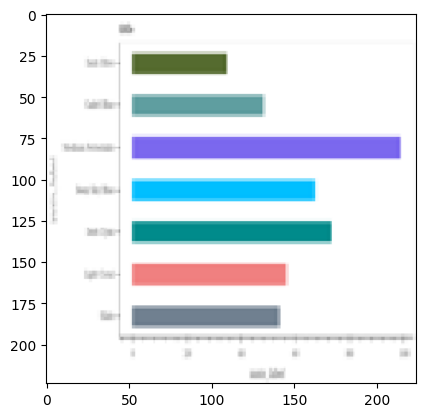

['hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical', 'hbar_categorical']


In [81]:
hbar_categorical = '/content/drive/MyDrive/charts/charts/charts/train_split/val/hbar_categorical'
predict_labels(hbar_categorical, model)

1/1 [==============================] - 0s 23ms/step
Prediction for 442.png: line


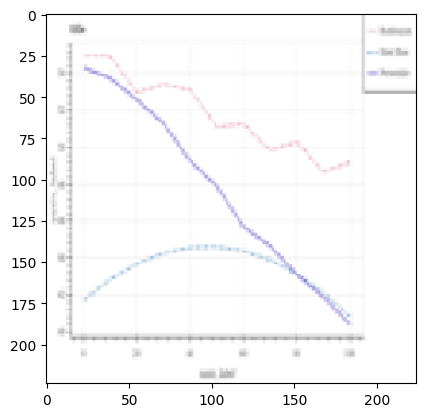

1/1 [==============================] - 0s 21ms/step
Prediction for 597.png: line


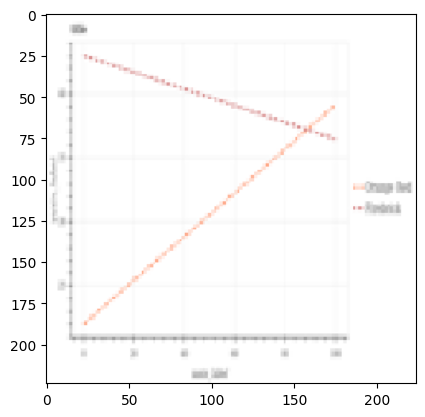

1/1 [==============================] - 0s 20ms/step
Prediction for 569.png: line


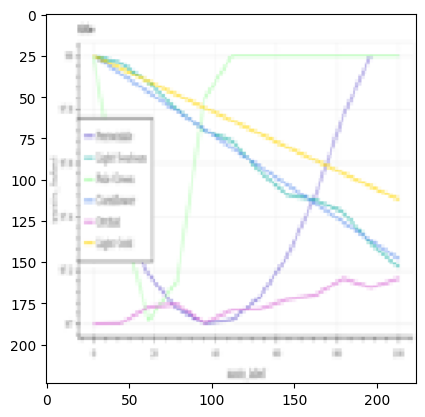

1/1 [==============================] - 0s 22ms/step
Prediction for 518.png: line


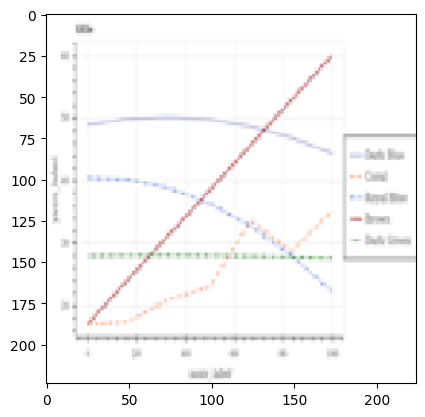

1/1 [==============================] - 0s 18ms/step
Prediction for 487.png: line


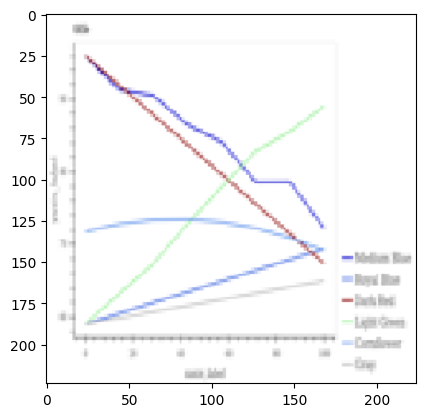

1/1 [==============================] - 0s 22ms/step
Prediction for 405.png: line


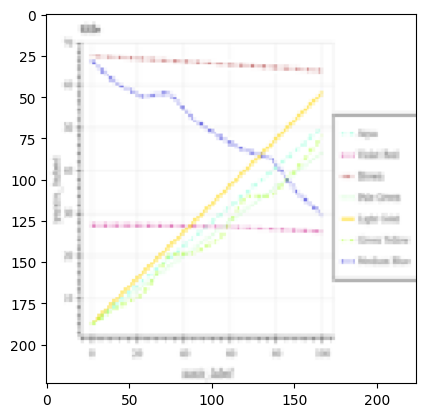

1/1 [==============================] - 0s 20ms/step
Prediction for 544.png: line


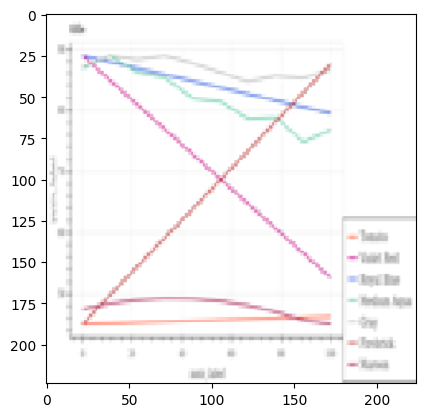

1/1 [==============================] - 0s 18ms/step
Prediction for 524.png: line


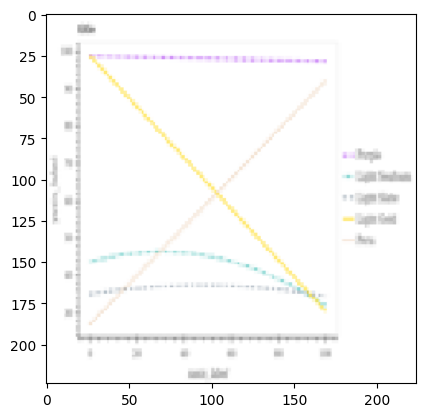

1/1 [==============================] - 0s 19ms/step
Prediction for 546.png: line


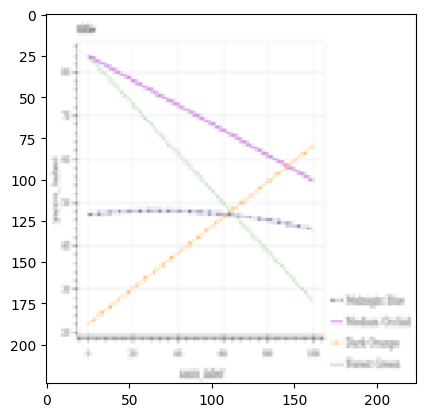

1/1 [==============================] - 0s 21ms/step
Prediction for 512.png: line


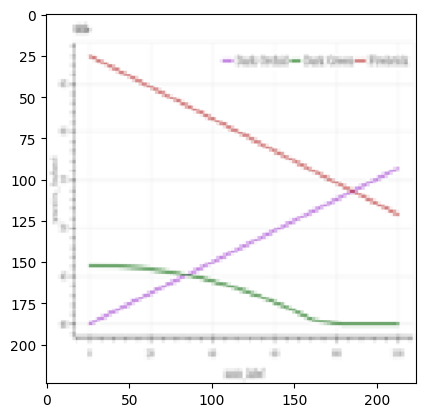

1/1 [==============================] - 0s 23ms/step
Prediction for 499.png: line


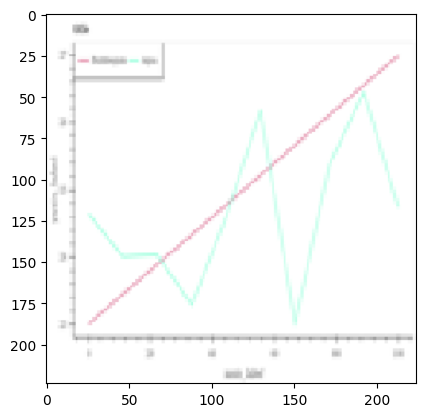

1/1 [==============================] - 0s 18ms/step
Prediction for 565.png: line


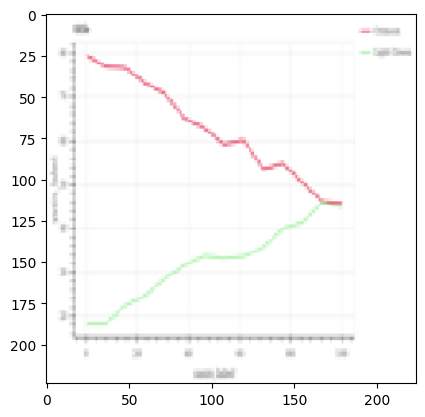

1/1 [==============================] - 0s 20ms/step
Prediction for 403.png: line


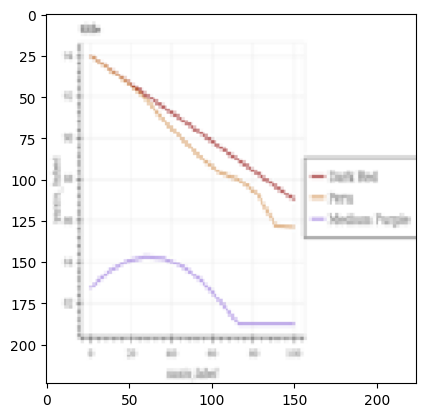

1/1 [==============================] - 0s 18ms/step
Prediction for 424.png: line


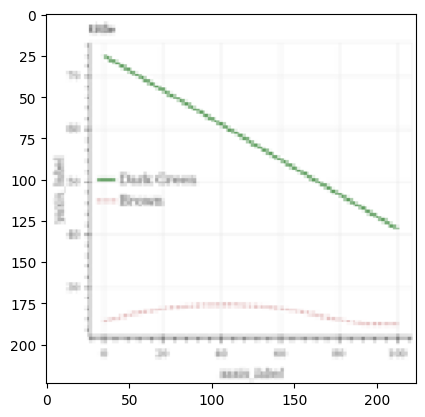

1/1 [==============================] - 0s 21ms/step
Prediction for 521.png: line


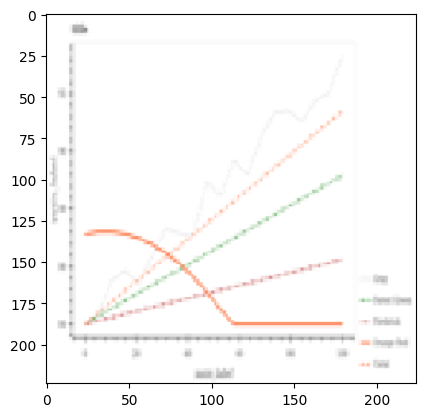

1/1 [==============================] - 0s 21ms/step
Prediction for 471.png: line


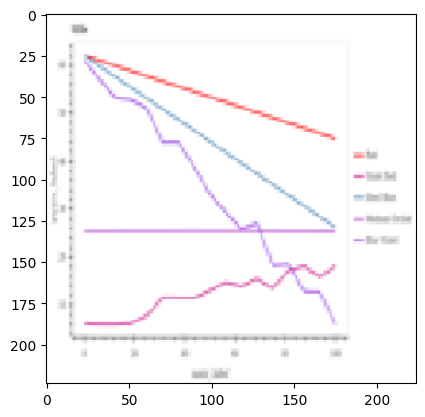

1/1 [==============================] - 0s 18ms/step
Prediction for 448.png: line


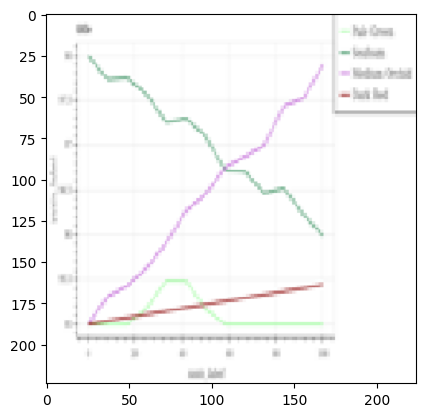

1/1 [==============================] - 0s 21ms/step
Prediction for 400.png: line


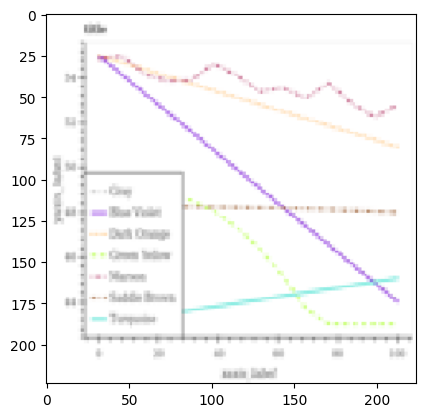

1/1 [==============================] - 0s 17ms/step
Prediction for 562.png: line


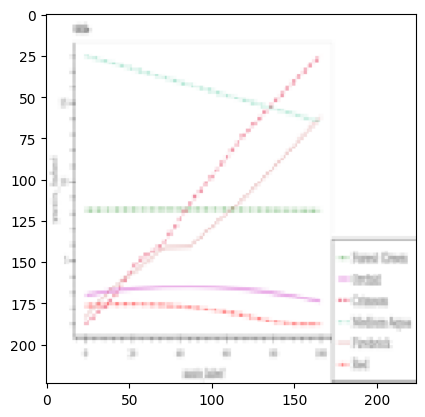

1/1 [==============================] - 0s 20ms/step
Prediction for 453.png: line


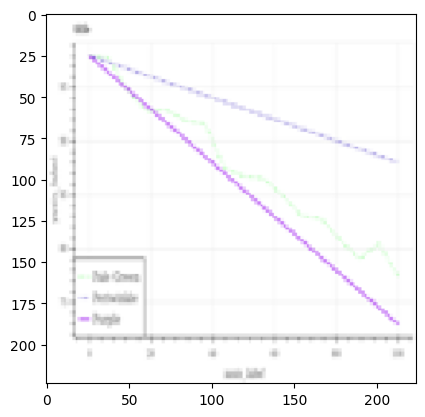

1/1 [==============================] - 0s 20ms/step
Prediction for 559.png: line


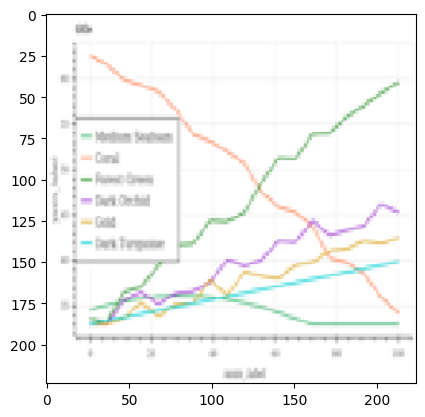

1/1 [==============================] - 0s 29ms/step
Prediction for 530.png: line


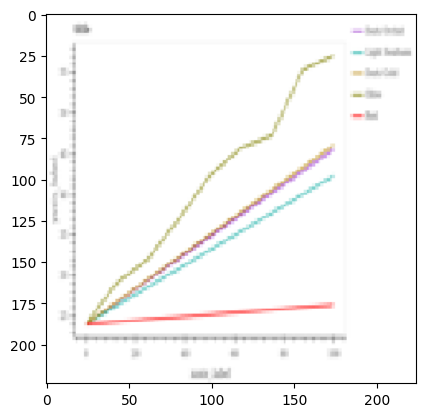

1/1 [==============================] - 0s 40ms/step
Prediction for 412.png: line


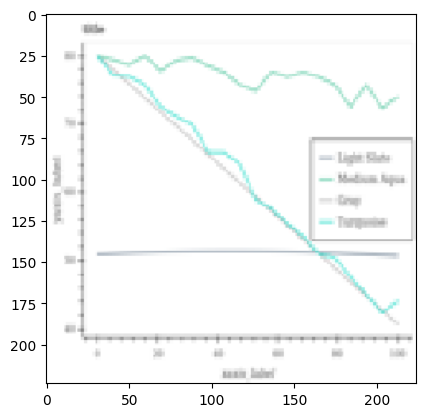

1/1 [==============================] - 0s 27ms/step
Prediction for 550.png: line


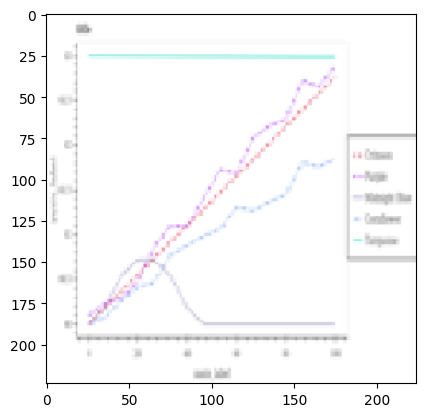

1/1 [==============================] - 0s 27ms/step
Prediction for 447.png: line


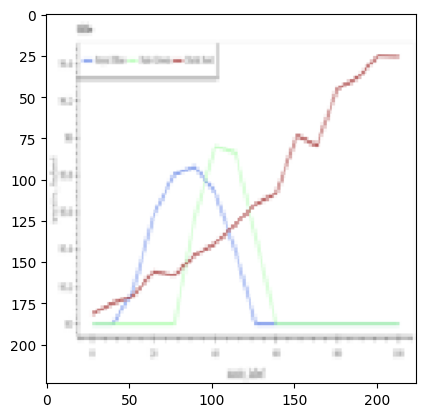

1/1 [==============================] - 0s 28ms/step
Prediction for 527.png: line


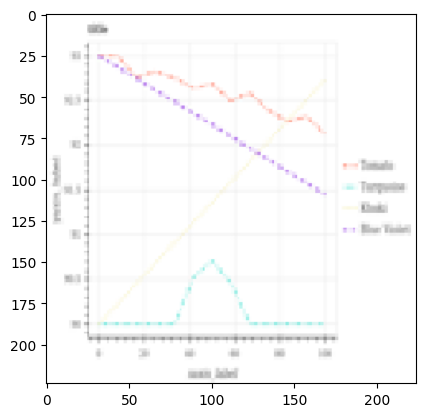

1/1 [==============================] - 0s 27ms/step
Prediction for 449.png: line


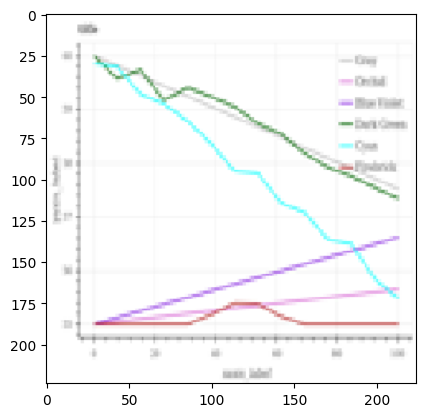

1/1 [==============================] - 0s 32ms/step
Prediction for 451.png: line


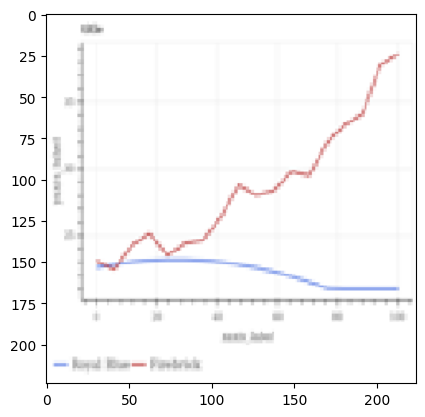

1/1 [==============================] - 0s 26ms/step
Prediction for 591.png: line


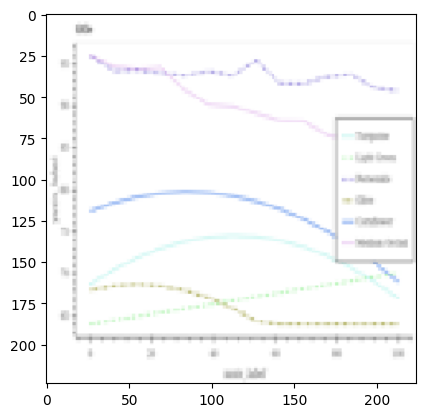

1/1 [==============================] - 0s 26ms/step
Prediction for 495.png: line


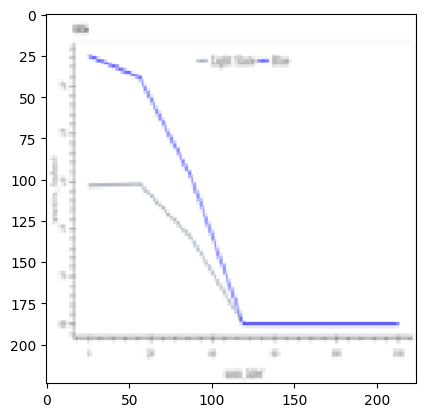

1/1 [==============================] - 0s 39ms/step
Prediction for 576.png: line


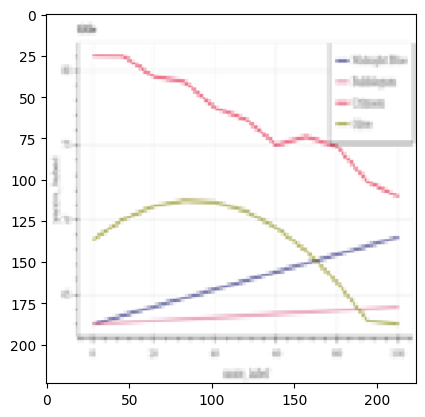

1/1 [==============================] - 0s 27ms/step
Prediction for 533.png: line


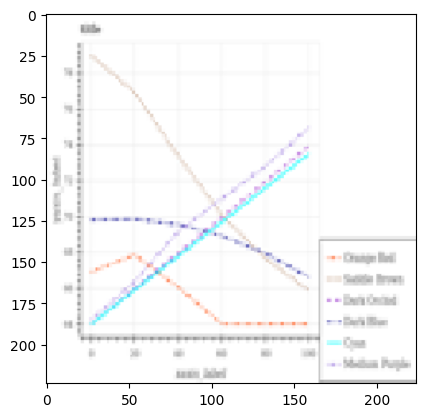

1/1 [==============================] - 0s 30ms/step
Prediction for 496.png: line


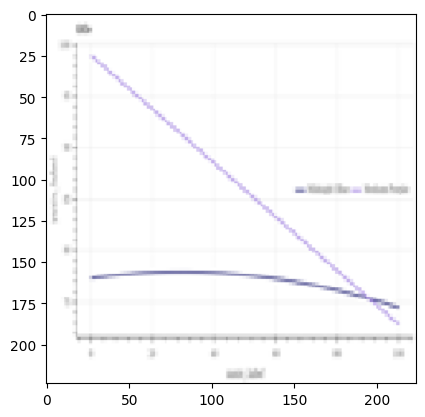

1/1 [==============================] - 0s 23ms/step
Prediction for 420.png: line


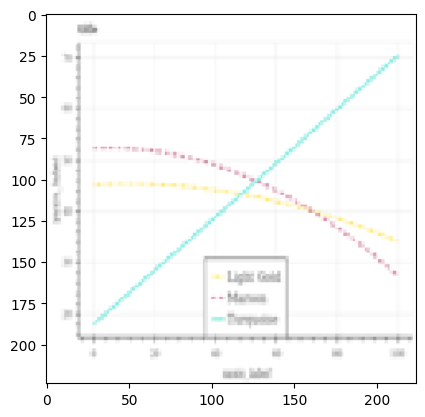

1/1 [==============================] - 0s 21ms/step
Prediction for 486.png: line


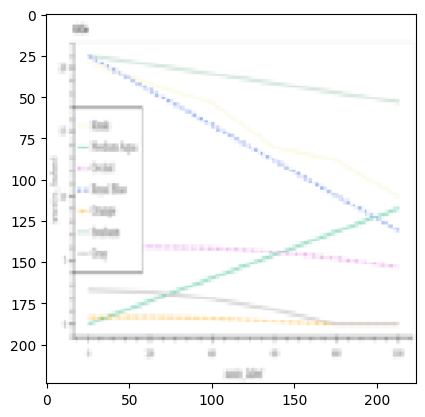

1/1 [==============================] - 0s 22ms/step
Prediction for 481.png: line


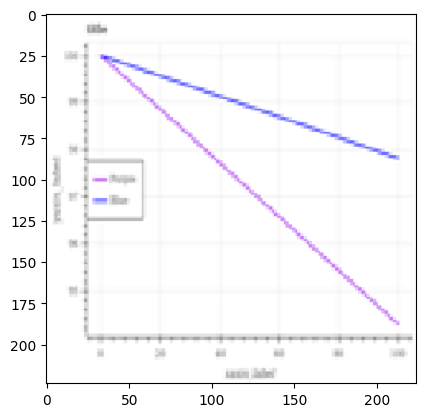

1/1 [==============================] - 0s 18ms/step
Prediction for 508.png: line


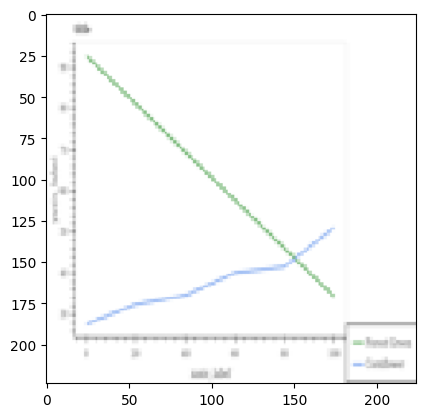

1/1 [==============================] - 0s 20ms/step
Prediction for 459.png: line


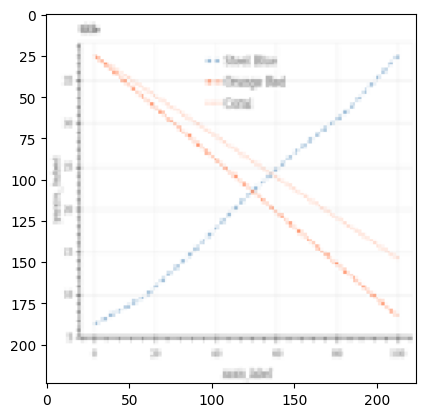

1/1 [==============================] - 0s 19ms/step
Prediction for 556.png: line


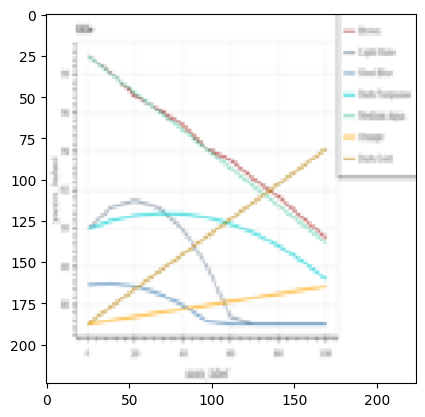

1/1 [==============================] - 0s 23ms/step
Prediction for 555.png: line


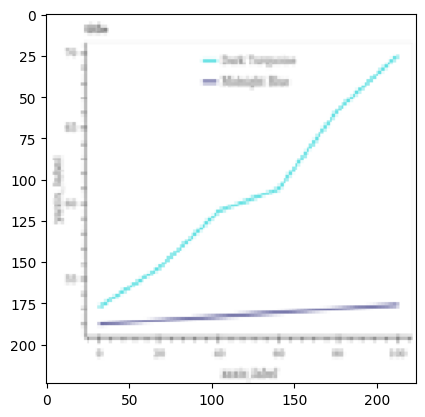

['line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line', 'line']


In [82]:
line = '/content/drive/MyDrive/charts/charts/charts/train_split/val/line'
predict_labels(line, model)

1/1 [==============================] - 0s 24ms/step
Prediction for 649.png: pie


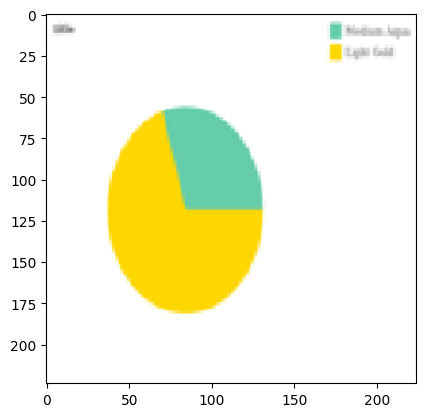

1/1 [==============================] - 0s 23ms/step
Prediction for 741.png: pie


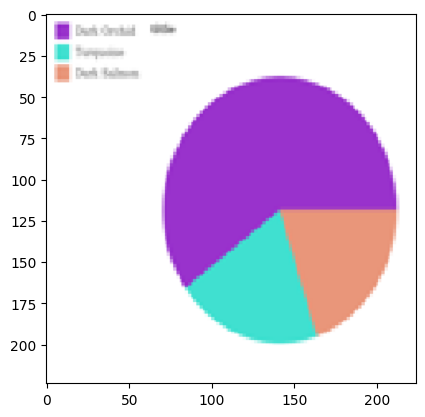

1/1 [==============================] - 0s 21ms/step
Prediction for 757.png: pie


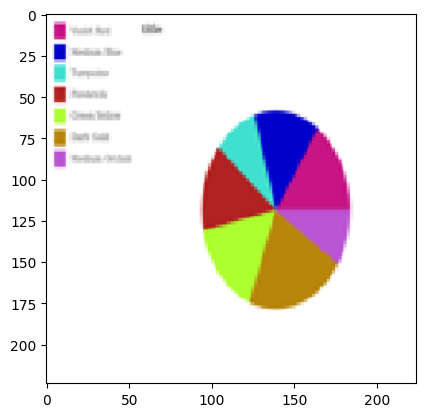

1/1 [==============================] - 0s 21ms/step
Prediction for 729.png: pie


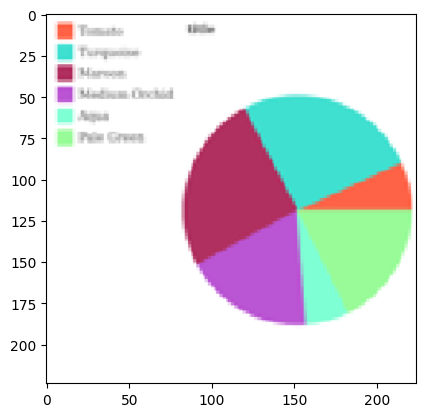

1/1 [==============================] - 0s 19ms/step
Prediction for 718.png: pie


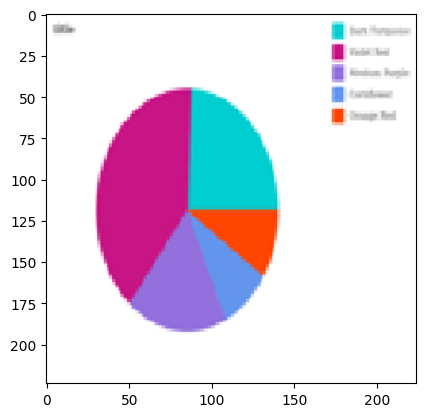

1/1 [==============================] - 0s 20ms/step
Prediction for 752.png: pie


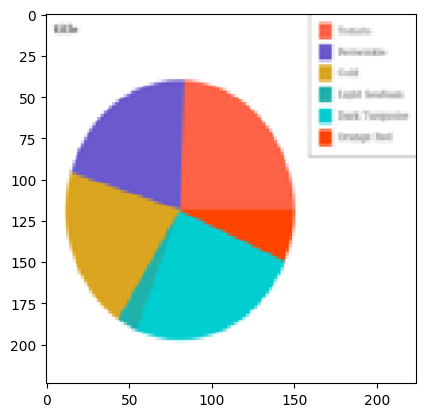

1/1 [==============================] - 0s 20ms/step
Prediction for 785.png: pie


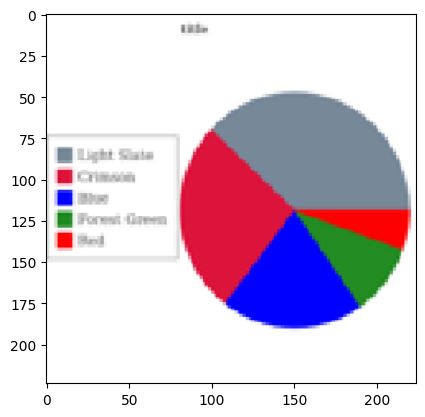

1/1 [==============================] - 0s 21ms/step
Prediction for 619.png: pie


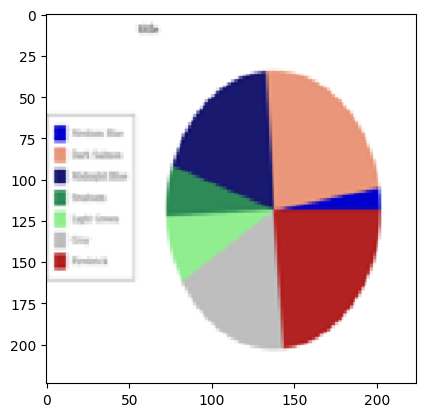

1/1 [==============================] - 0s 21ms/step
Prediction for 766.png: pie


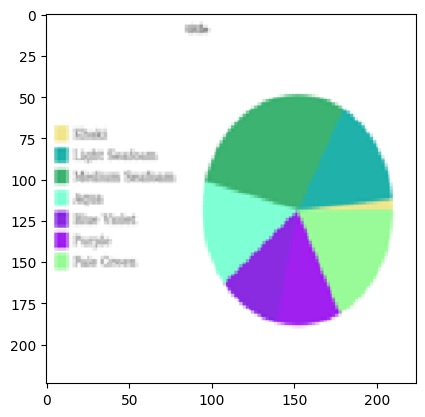

1/1 [==============================] - 0s 23ms/step
Prediction for 720.png: pie


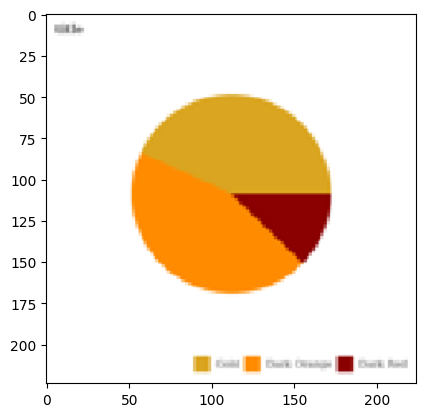

1/1 [==============================] - 0s 20ms/step
Prediction for 732.png: pie


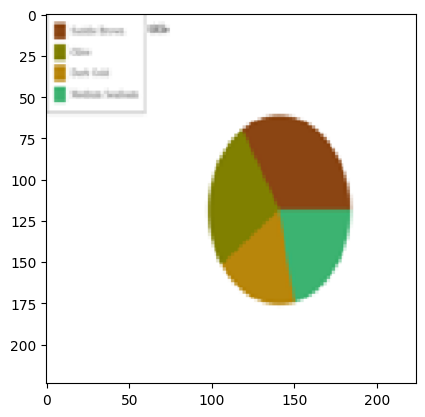

1/1 [==============================] - 0s 20ms/step
Prediction for 644.png: pie


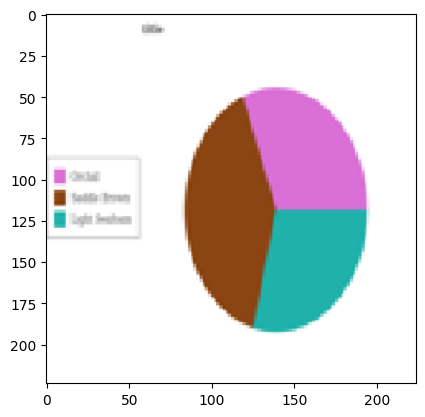

1/1 [==============================] - 0s 27ms/step
Prediction for 792.png: pie


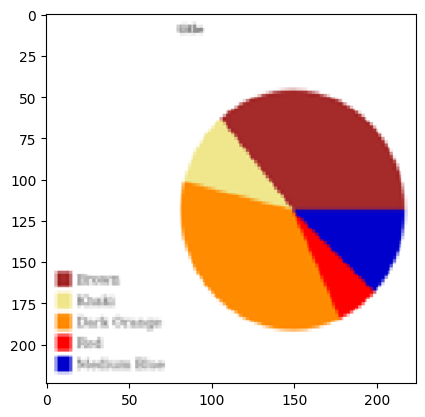

1/1 [==============================] - 0s 19ms/step
Prediction for 740.png: pie


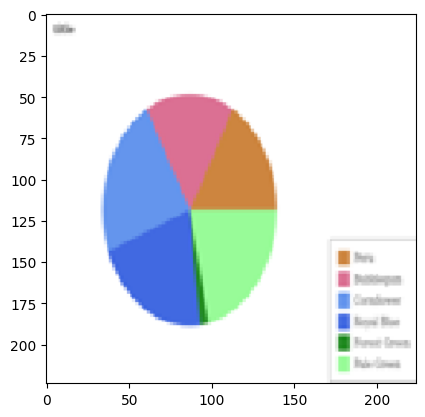

1/1 [==============================] - 0s 26ms/step
Prediction for 650.png: pie


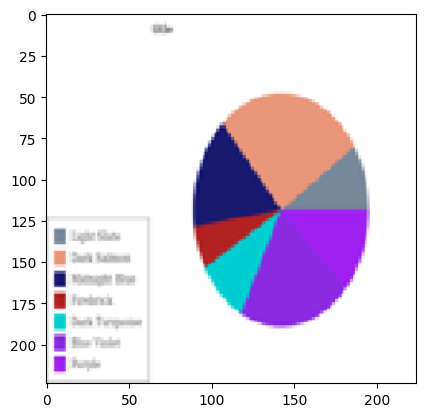

1/1 [==============================] - 0s 20ms/step
Prediction for 764.png: pie


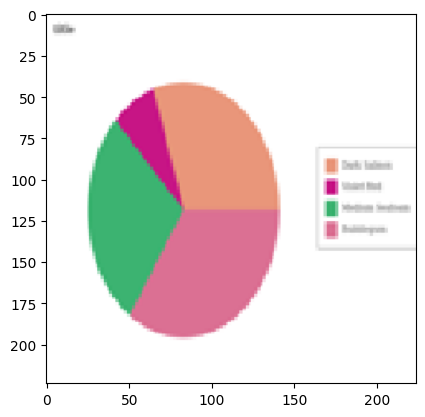

1/1 [==============================] - 0s 21ms/step
Prediction for 629.png: pie


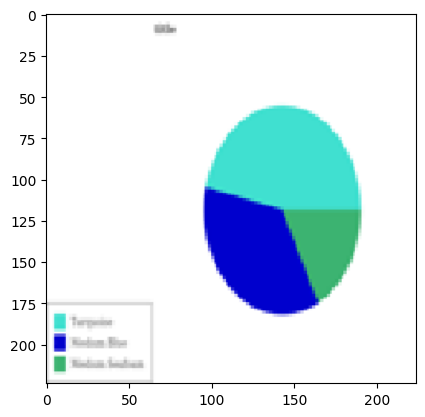

1/1 [==============================] - 0s 22ms/step
Prediction for 749.png: pie


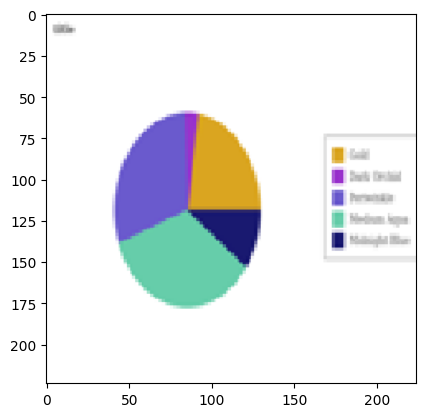

1/1 [==============================] - 0s 18ms/step
Prediction for 797.png: pie


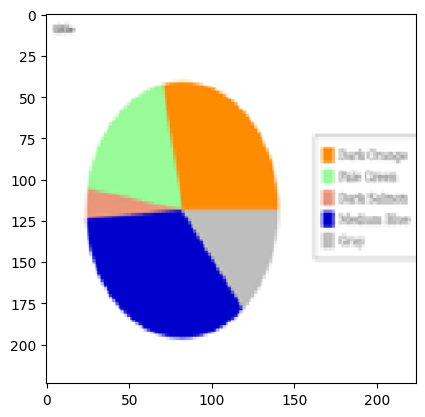

1/1 [==============================] - 0s 18ms/step
Prediction for 771.png: pie


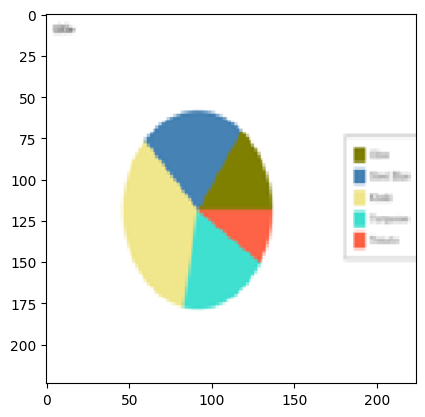

1/1 [==============================] - 0s 20ms/step
Prediction for 642.png: pie


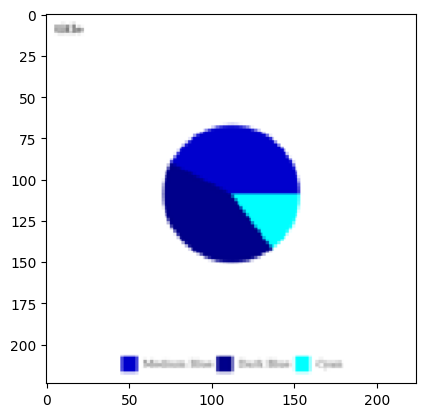

1/1 [==============================] - 0s 19ms/step
Prediction for 663.png: pie


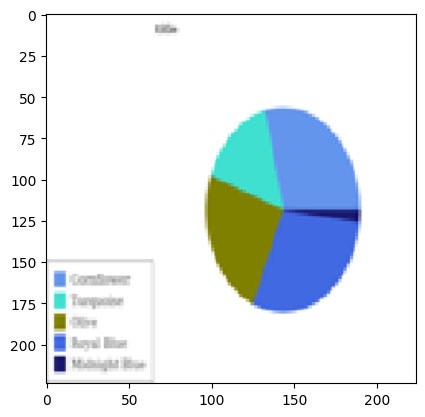

1/1 [==============================] - 0s 20ms/step
Prediction for 636.png: pie


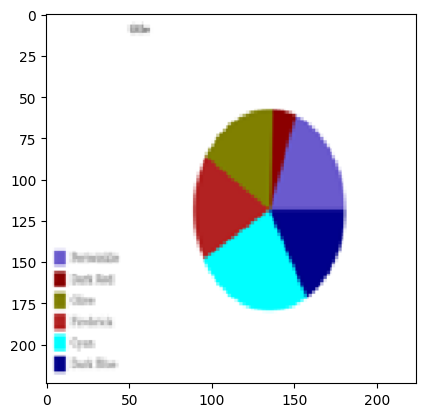

1/1 [==============================] - 0s 19ms/step
Prediction for 703.png: pie


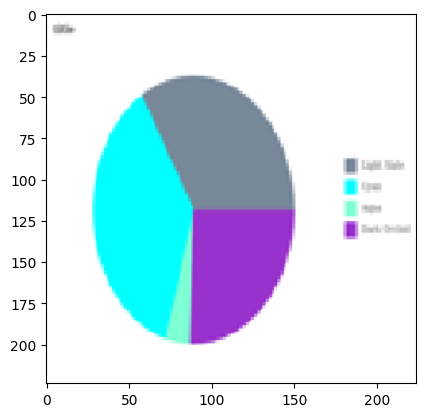

1/1 [==============================] - 0s 20ms/step
Prediction for 610.png: pie


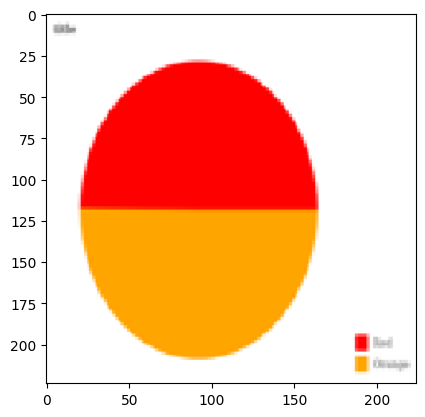

1/1 [==============================] - 0s 18ms/step
Prediction for 616.png: pie


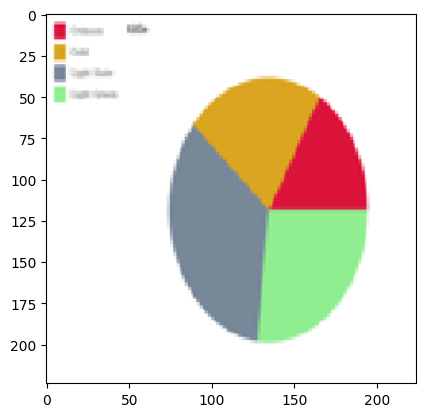

1/1 [==============================] - 0s 24ms/step
Prediction for 746.png: pie


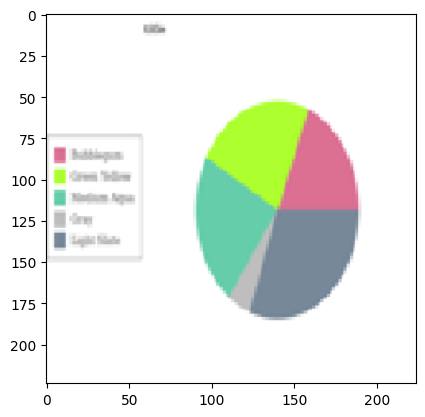

1/1 [==============================] - 0s 20ms/step
Prediction for 728.png: pie


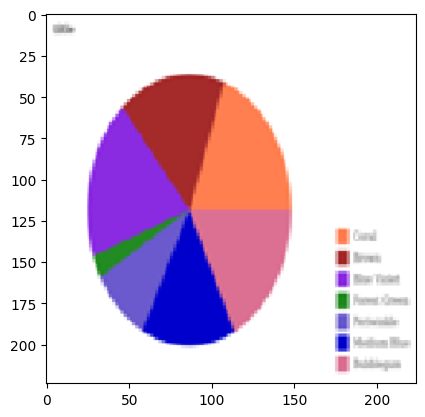

1/1 [==============================] - 0s 19ms/step
Prediction for 613.png: pie


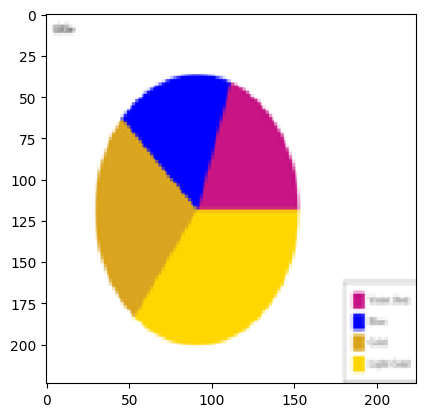

1/1 [==============================] - 0s 28ms/step
Prediction for 692.png: pie


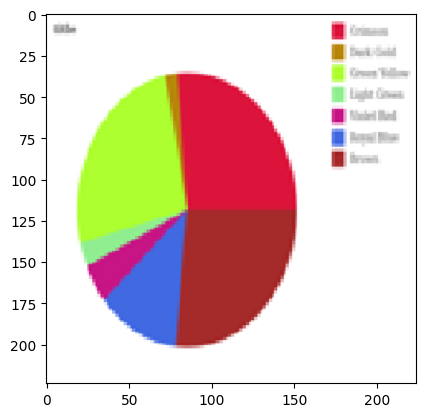

1/1 [==============================] - 0s 38ms/step
Prediction for 786.png: pie


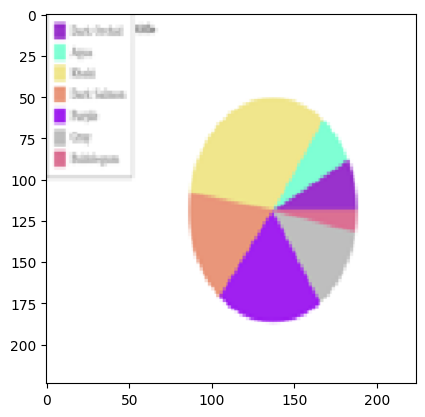

1/1 [==============================] - 0s 27ms/step
Prediction for 620.png: pie


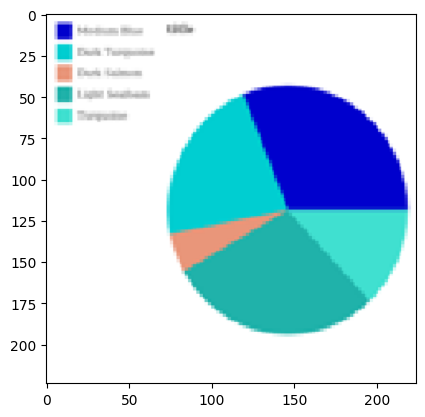

1/1 [==============================] - 0s 26ms/step
Prediction for 778.png: pie


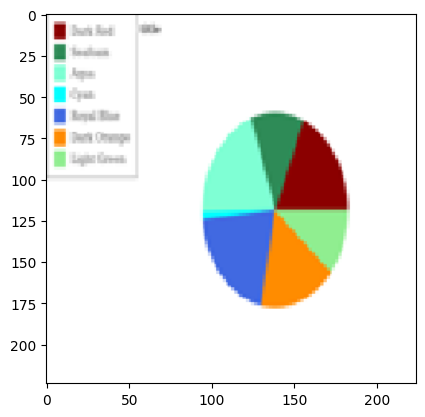

1/1 [==============================] - 0s 27ms/step
Prediction for 704.png: pie


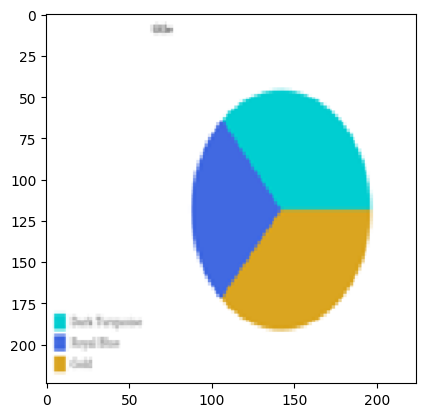

1/1 [==============================] - 0s 30ms/step
Prediction for 686.png: pie


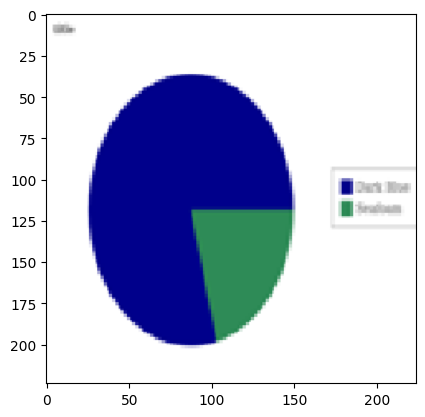

1/1 [==============================] - 0s 26ms/step
Prediction for 772.png: pie


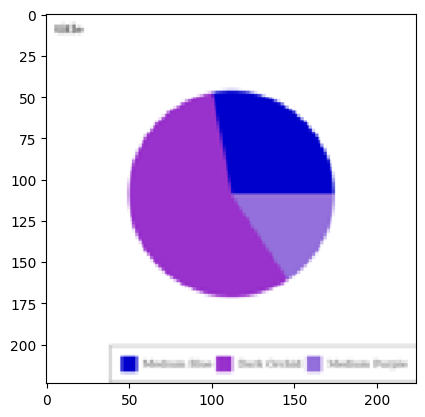

1/1 [==============================] - 0s 26ms/step
Prediction for 615.png: pie


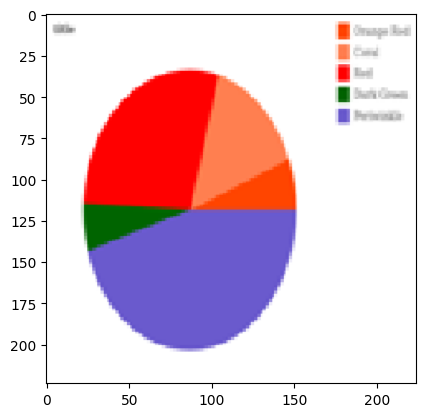

1/1 [==============================] - 0s 27ms/step
Prediction for 632.png: pie


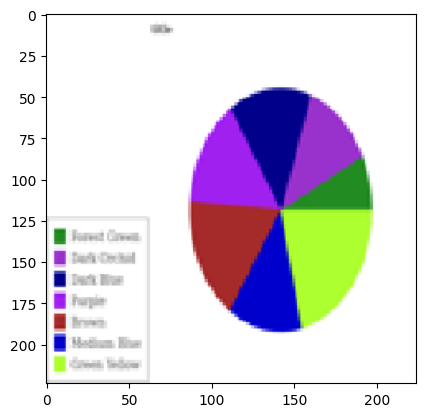

1/1 [==============================] - 0s 29ms/step
Prediction for 700.png: pie


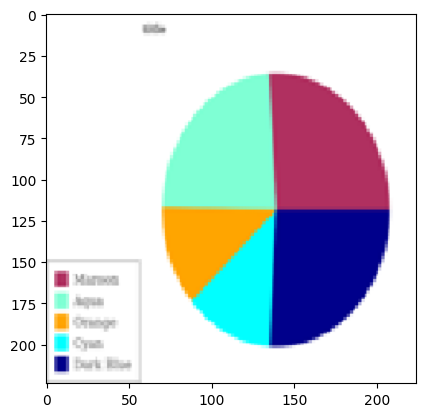

1/1 [==============================] - 0s 31ms/step
Prediction for 676.png: pie


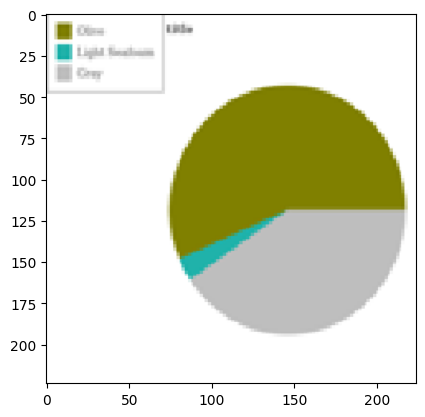

['pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie', 'pie']


In [83]:
pie = '/content/drive/MyDrive/charts/charts/charts/train_split/val/pie'
predict_labels(pie, model)

1/1 [==============================] - 0s 27ms/step
Prediction for 114.png: vbar_categorical


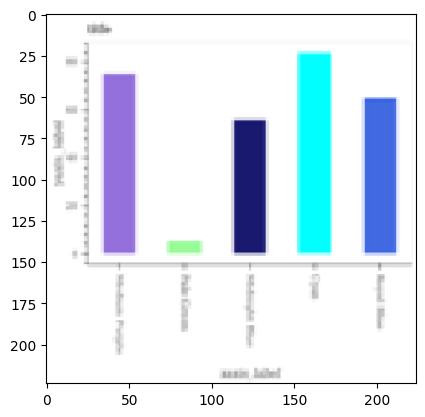

1/1 [==============================] - 0s 18ms/step
Prediction for 98.png: vbar_categorical


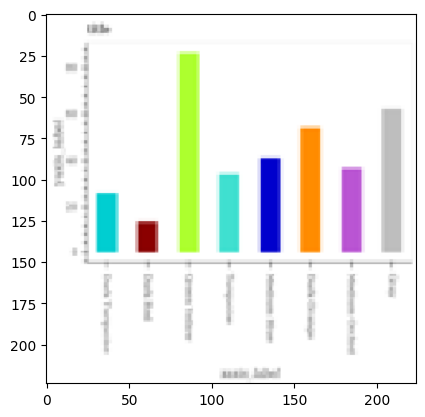

1/1 [==============================] - 0s 19ms/step
Prediction for 132.png: vbar_categorical


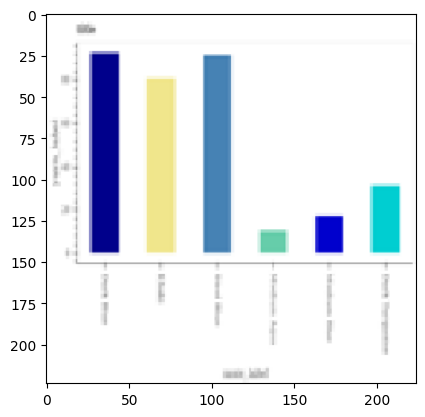

1/1 [==============================] - 0s 19ms/step
Prediction for 166.png: vbar_categorical


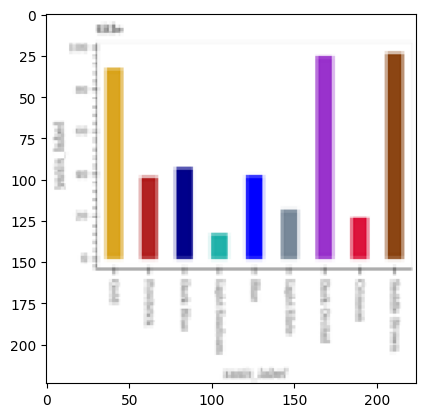

1/1 [==============================] - 0s 20ms/step
Prediction for 118.png: vbar_categorical


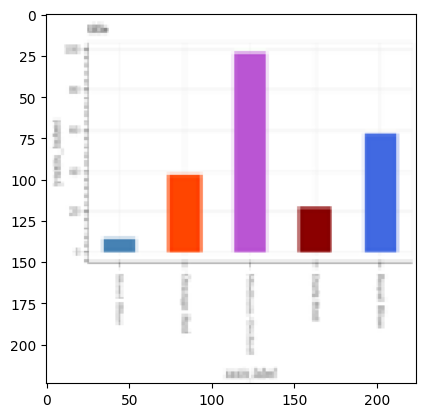

1/1 [==============================] - 0s 19ms/step
Prediction for 81.png: vbar_categorical


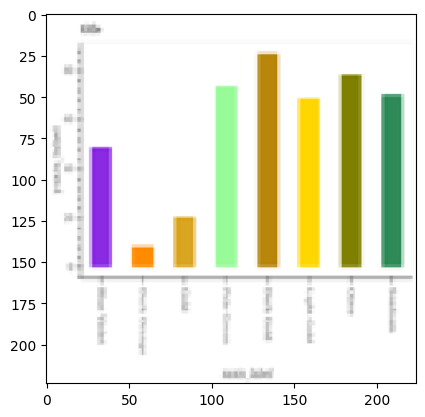

1/1 [==============================] - 0s 18ms/step
Prediction for 76.png: vbar_categorical


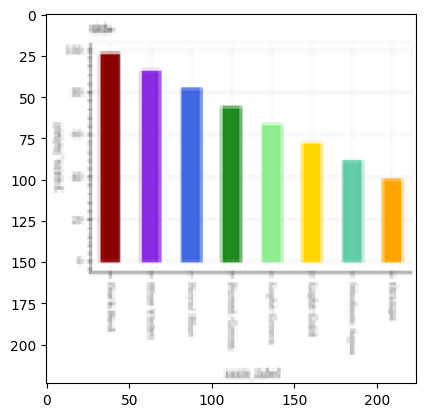

1/1 [==============================] - 0s 20ms/step
Prediction for 183.png: vbar_categorical


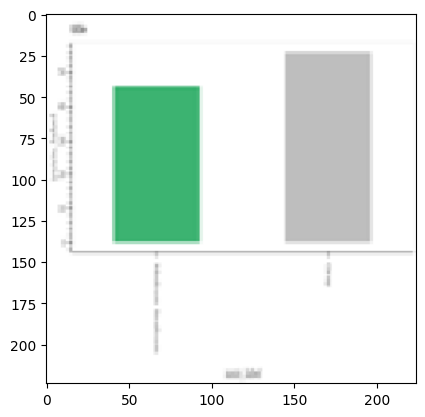

1/1 [==============================] - 0s 20ms/step
Prediction for 80.png: vbar_categorical


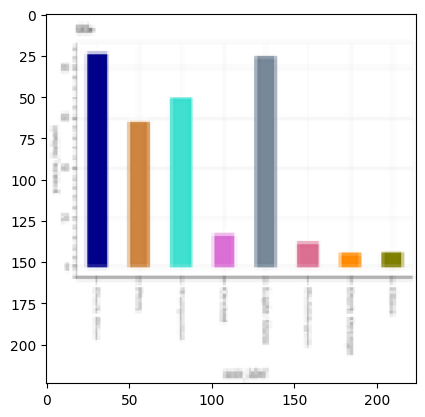

1/1 [==============================] - 0s 21ms/step
Prediction for 96.png: vbar_categorical


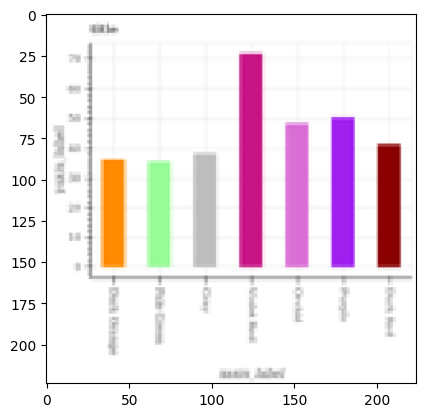

1/1 [==============================] - 0s 18ms/step
Prediction for 84.png: vbar_categorical


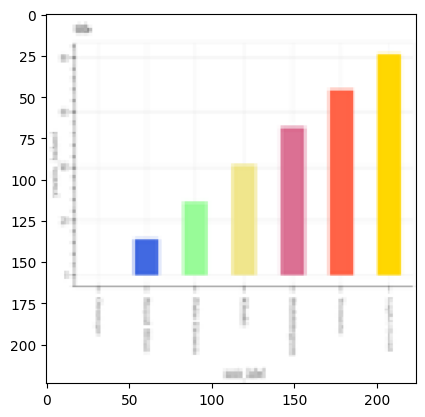

1/1 [==============================] - 0s 18ms/step
Prediction for 104.png: vbar_categorical


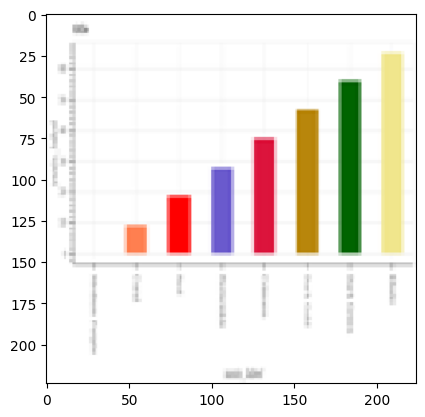

1/1 [==============================] - 0s 20ms/step
Prediction for 175.png: vbar_categorical


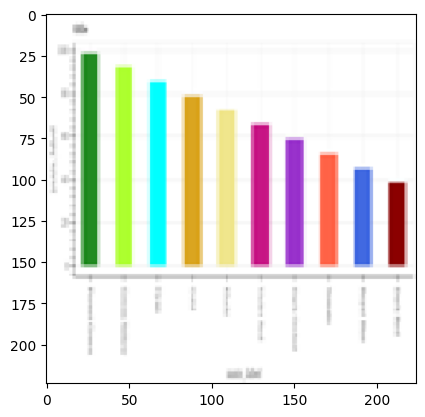

1/1 [==============================] - 0s 24ms/step
Prediction for 125.png: vbar_categorical


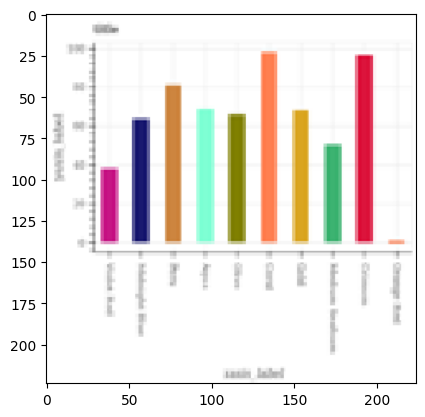

1/1 [==============================] - 0s 19ms/step
Prediction for 66.png: vbar_categorical


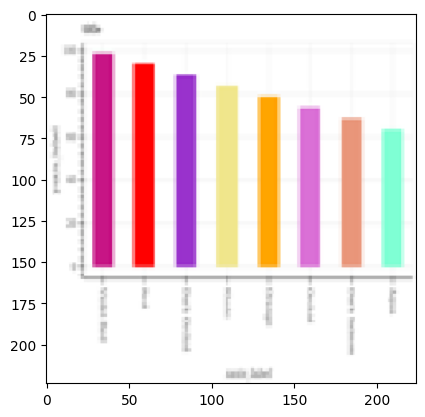

1/1 [==============================] - 0s 18ms/step
Prediction for 48.png: vbar_categorical


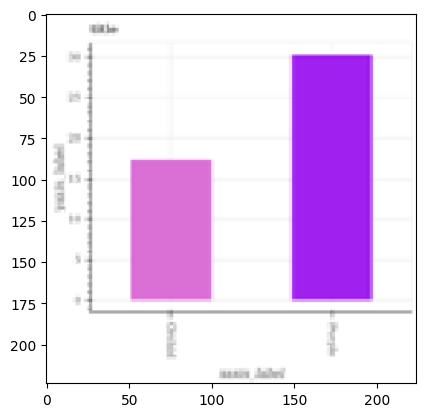

1/1 [==============================] - 0s 21ms/step
Prediction for 196.png: vbar_categorical


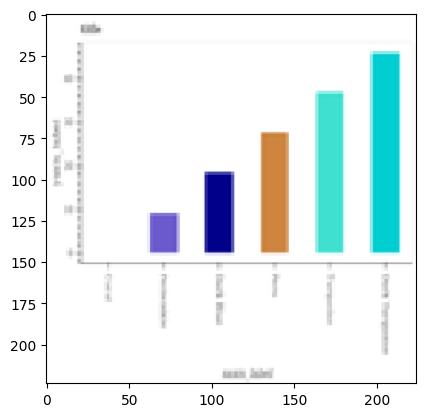

1/1 [==============================] - 0s 20ms/step
Prediction for 50.png: vbar_categorical


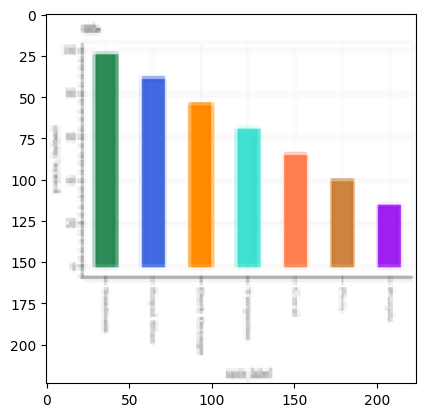

1/1 [==============================] - 0s 19ms/step
Prediction for 43.png: vbar_categorical


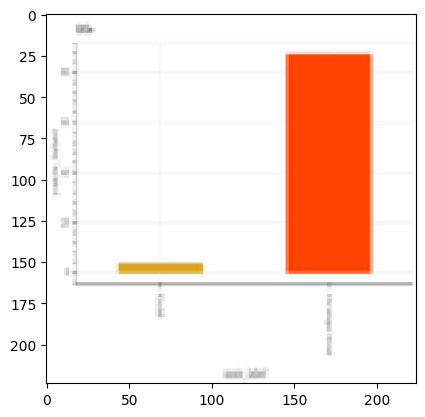

1/1 [==============================] - 0s 19ms/step
Prediction for 68.png: vbar_categorical


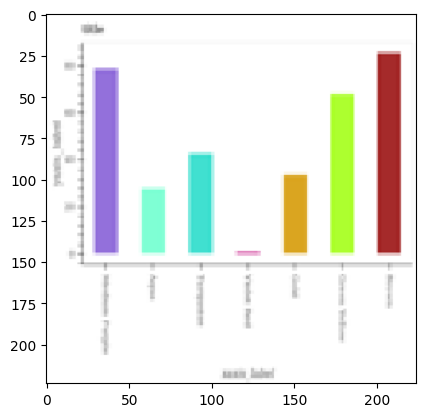

1/1 [==============================] - 0s 20ms/step
Prediction for 164.png: vbar_categorical


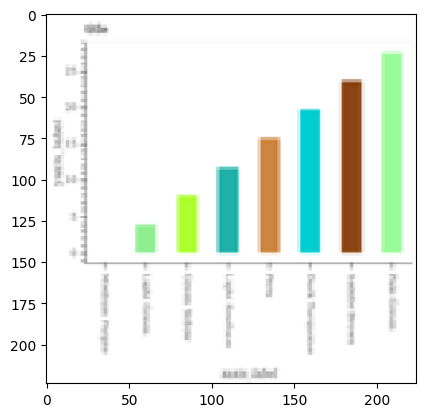

1/1 [==============================] - 0s 21ms/step
Prediction for 151.png: vbar_categorical


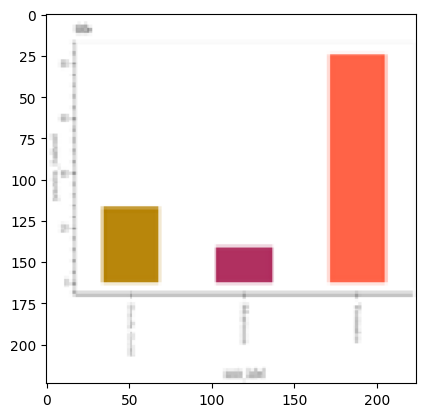

1/1 [==============================] - 0s 25ms/step
Prediction for 186.png: vbar_categorical


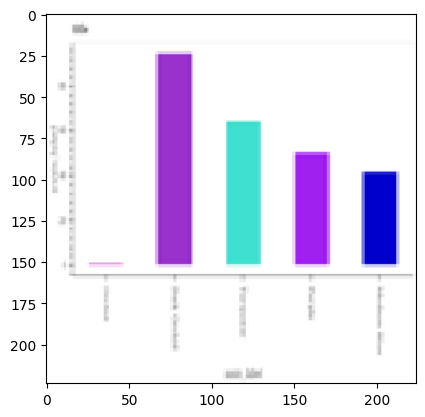

1/1 [==============================] - 0s 18ms/step
Prediction for 97.png: vbar_categorical


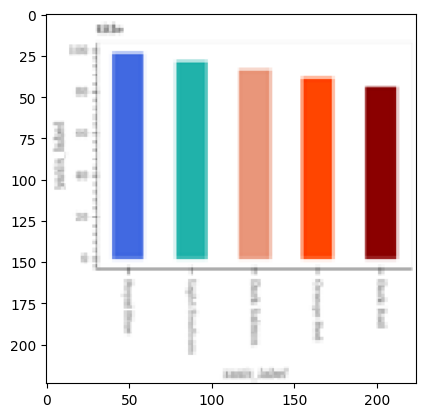

1/1 [==============================] - 0s 18ms/step
Prediction for 199.png: vbar_categorical


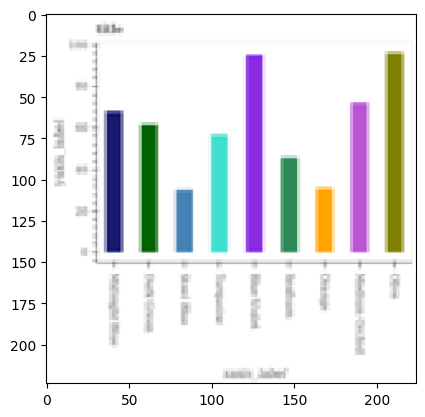

1/1 [==============================] - 0s 20ms/step
Prediction for 135.png: vbar_categorical


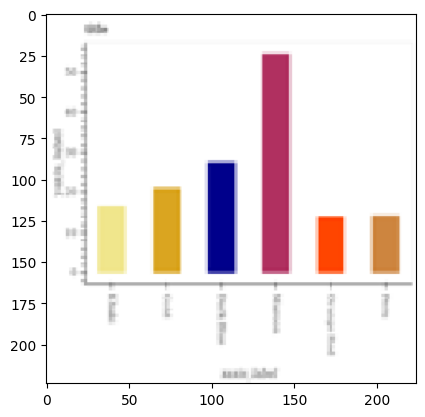

1/1 [==============================] - 0s 18ms/step
Prediction for 40.png: vbar_categorical


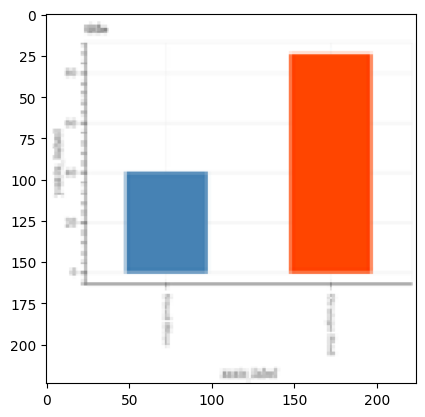

1/1 [==============================] - 0s 21ms/step
Prediction for 141.png: vbar_categorical


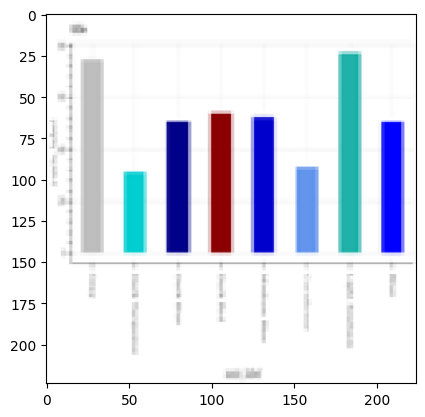

1/1 [==============================] - 0s 25ms/step
Prediction for 122.png: vbar_categorical


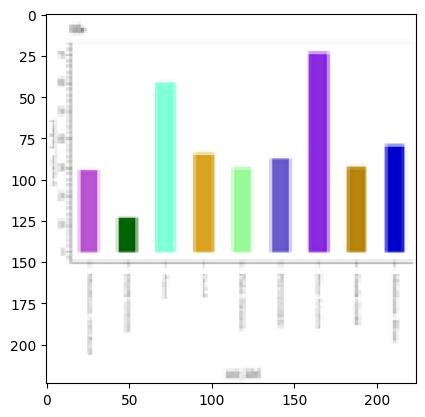

1/1 [==============================] - 0s 21ms/step
Prediction for 147.png: vbar_categorical


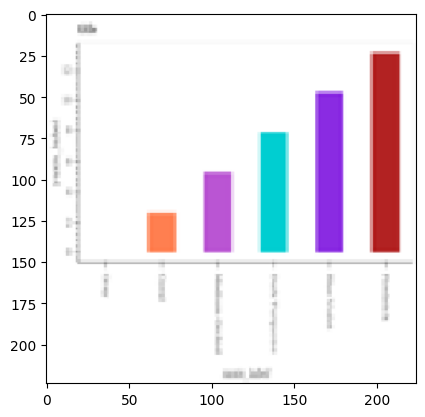

1/1 [==============================] - 0s 21ms/step
Prediction for 14.png: vbar_categorical


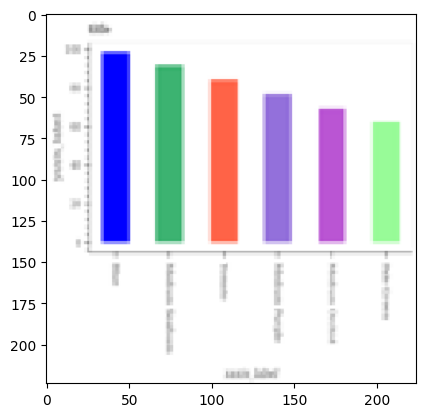

1/1 [==============================] - 0s 20ms/step
Prediction for 54.png: vbar_categorical


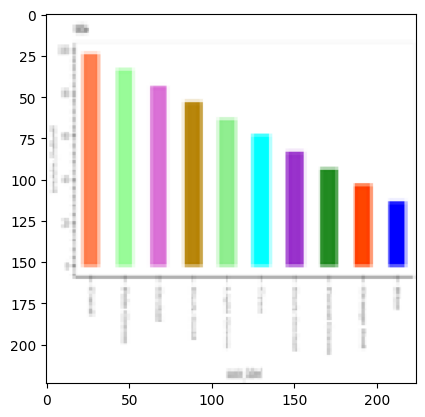

1/1 [==============================] - 0s 23ms/step
Prediction for 18.png: vbar_categorical


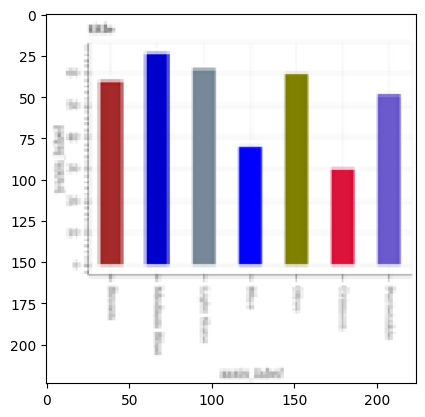

1/1 [==============================] - 0s 21ms/step
Prediction for 130.png: vbar_categorical


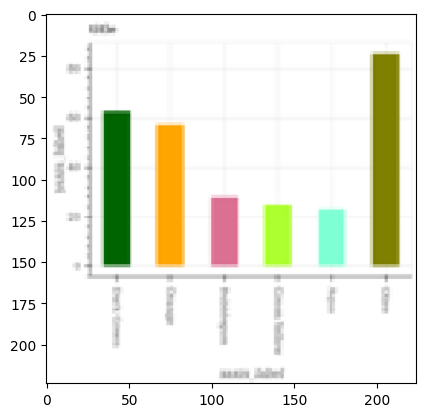

1/1 [==============================] - 0s 20ms/step
Prediction for 170.png: vbar_categorical


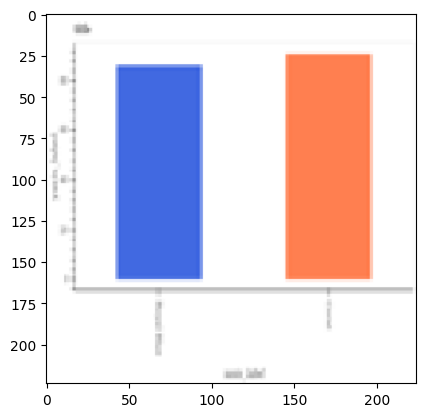

1/1 [==============================] - 0s 24ms/step
Prediction for 93.png: vbar_categorical


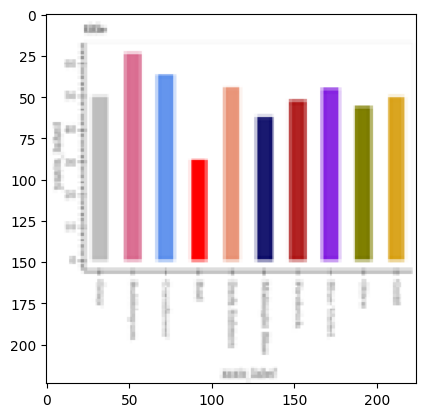

1/1 [==============================] - 0s 27ms/step
Prediction for 124.png: vbar_categorical


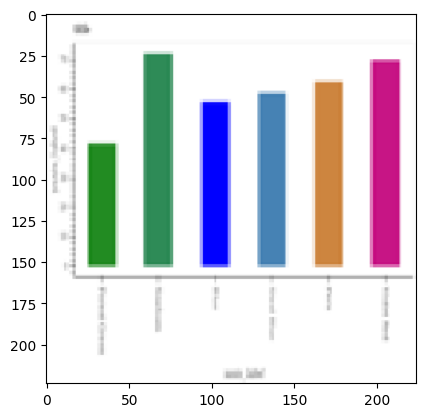

1/1 [==============================] - 0s 22ms/step
Prediction for 120.png: vbar_categorical


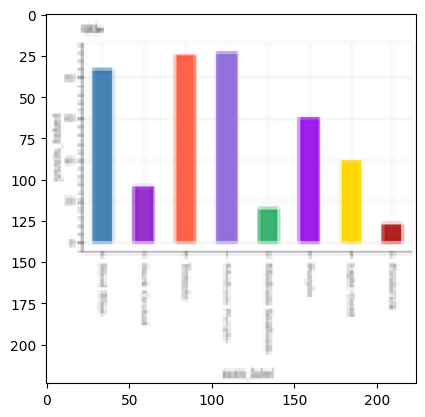

1/1 [==============================] - 0s 27ms/step
Prediction for 10.png: vbar_categorical


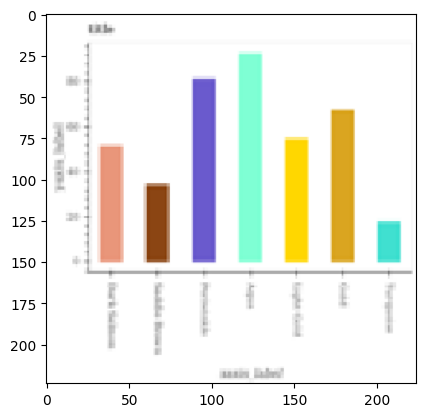

1/1 [==============================] - 0s 32ms/step
Prediction for 83.png: vbar_categorical


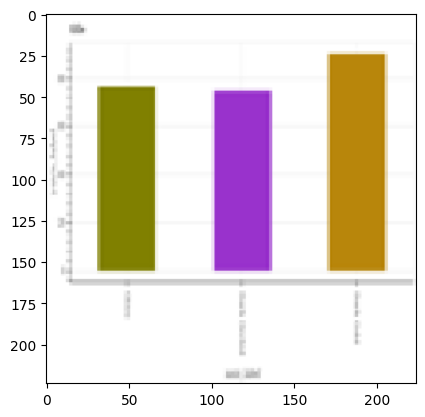

['vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical', 'vbar_categorical']


In [84]:
vbar_categorical = '/content/drive/MyDrive/charts/charts/charts/train_split/val/vbar_categorical'
predict_labels(vbar_categorical, model)

7/7 [==============================] - 1s 95ms/step - loss: 0.0379 - accuracy: 0.9850
Validation Accuracy: 0.9850000143051147
1/1 [==============================] - 0s 30ms/step
Prediction for 4.png: line


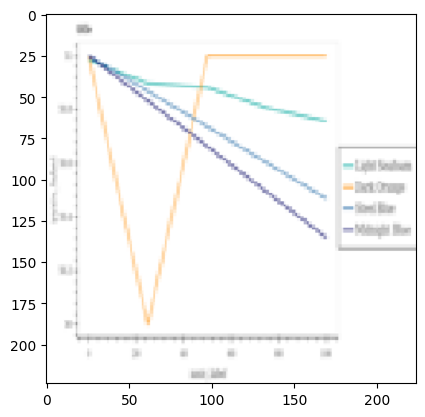

1/1 [==============================] - 0s 27ms/step
Prediction for 5.png: line


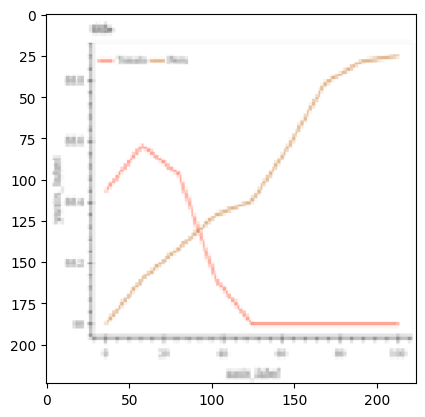

1/1 [==============================] - 0s 31ms/step
Prediction for 33.png: hbar_categorical


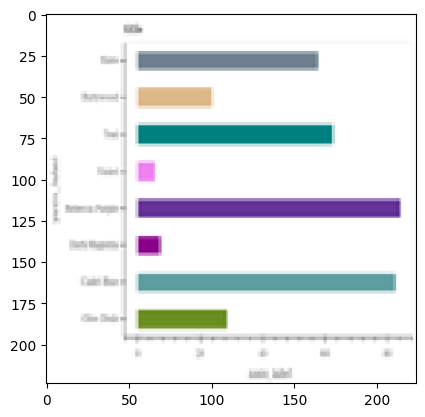

1/1 [==============================] - 0s 27ms/step
Prediction for 38.png: vbar_categorical


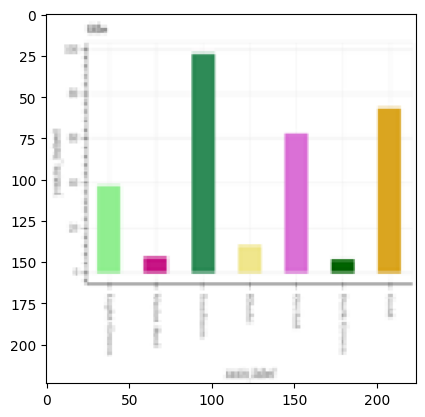

1/1 [==============================] - 0s 29ms/step
Prediction for 40.png: dot_line


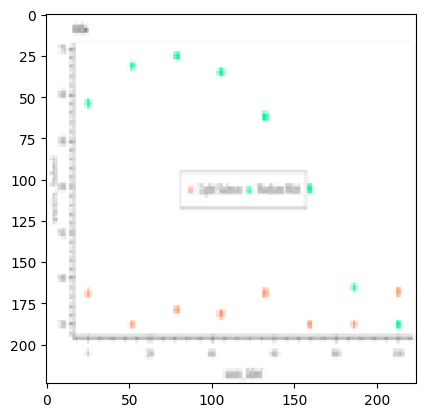

1/1 [==============================] - 0s 29ms/step
Prediction for 48.png: pie


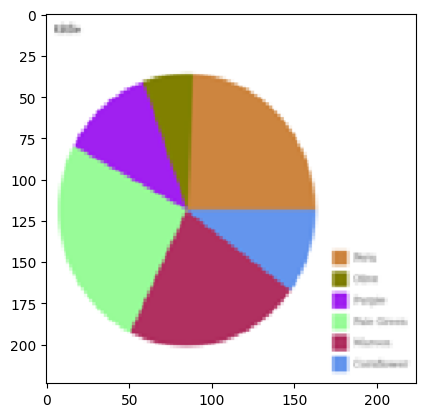

1/1 [==============================] - 0s 19ms/step
Prediction for 9.png: line


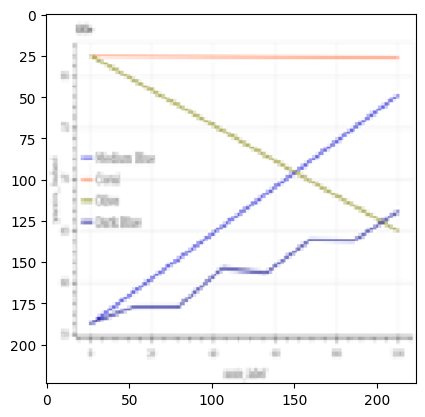

1/1 [==============================] - 0s 18ms/step
Prediction for 41.png: vbar_categorical


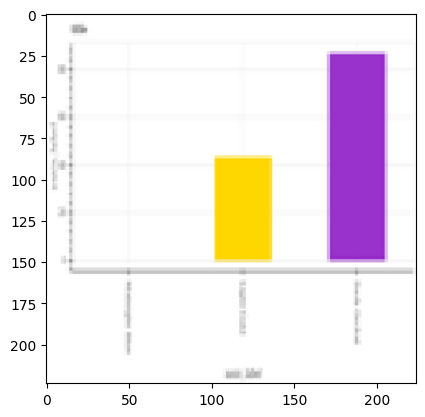

1/1 [==============================] - 0s 19ms/step
Prediction for 8.png: line


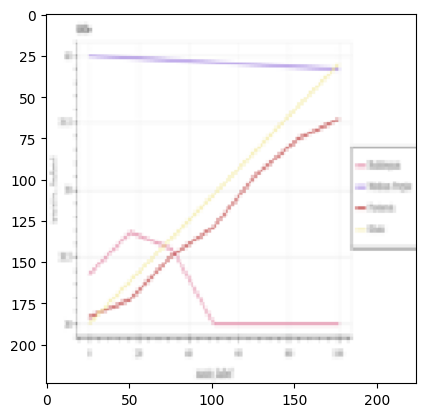

1/1 [==============================] - 0s 19ms/step
Prediction for 6.png: vbar_categorical


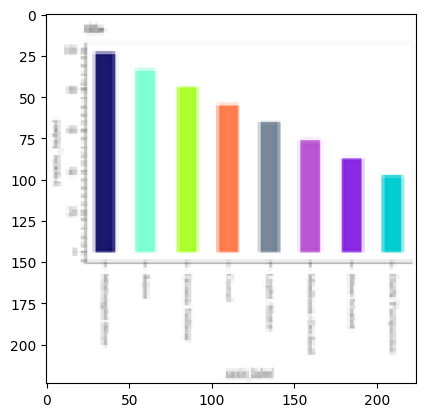

1/1 [==============================] - 0s 20ms/step
Prediction for 39.png: dot_line


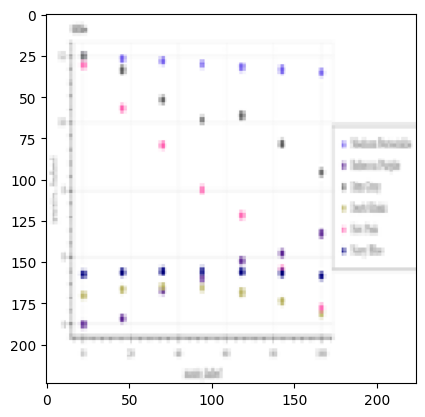

1/1 [==============================] - 0s 21ms/step
Prediction for 49.png: line


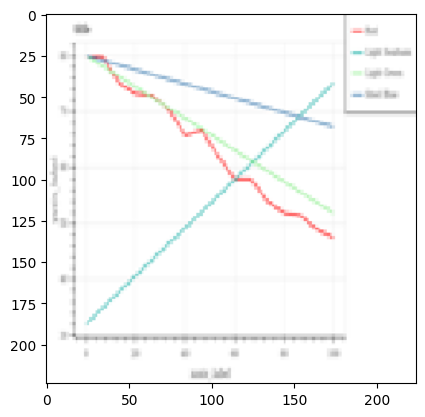

1/1 [==============================] - 0s 21ms/step
Prediction for 47.png: pie


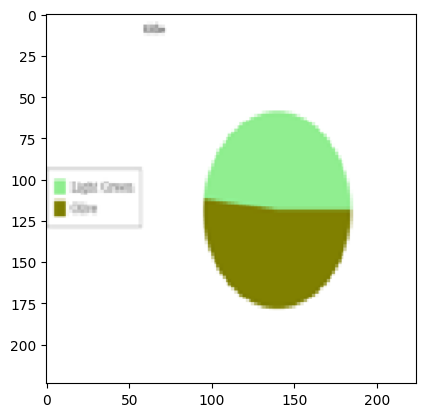

1/1 [==============================] - 0s 20ms/step
Prediction for 37.png: dot_line


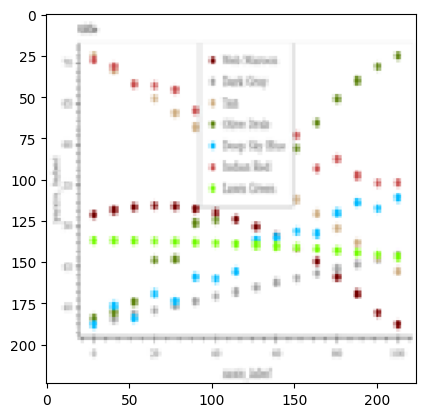

1/1 [==============================] - 0s 18ms/step
Prediction for 46.png: line


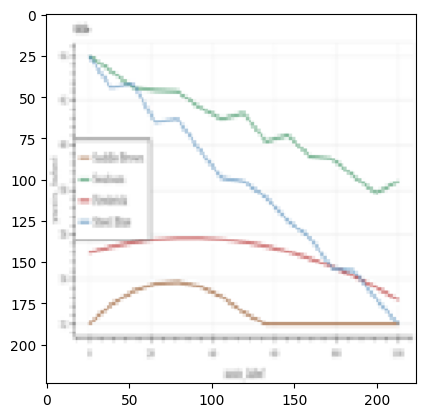

1/1 [==============================] - 0s 18ms/step
Prediction for 43.png: hbar_categorical


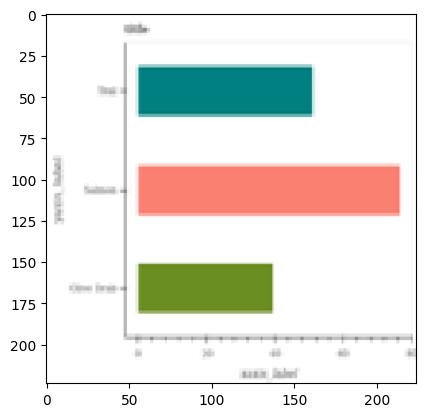

1/1 [==============================] - 0s 21ms/step
Prediction for 36.png: vbar_categorical


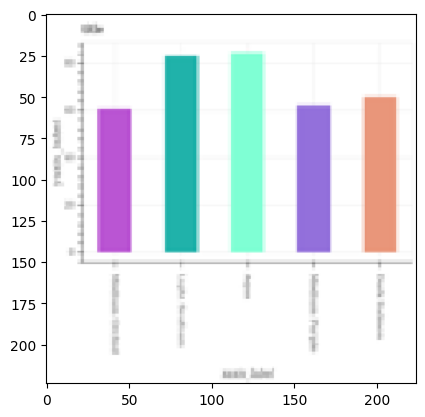

1/1 [==============================] - 0s 18ms/step
Prediction for 7.png: vbar_categorical


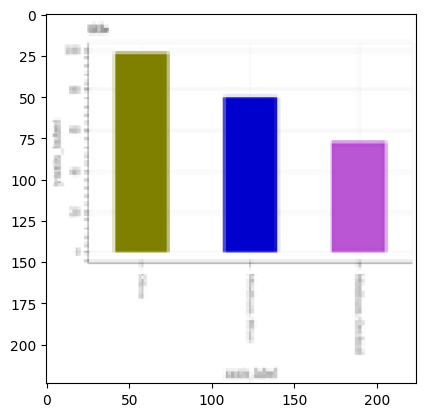

1/1 [==============================] - 0s 19ms/step
Prediction for 42.png: pie


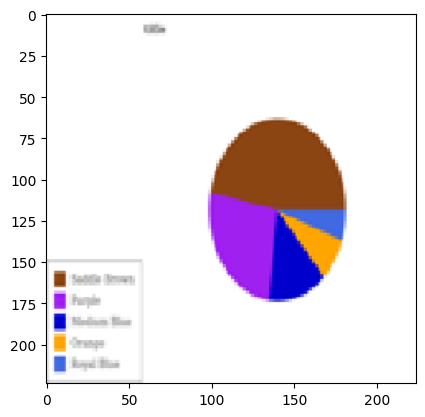

1/1 [==============================] - 0s 18ms/step
Prediction for 21.png: pie


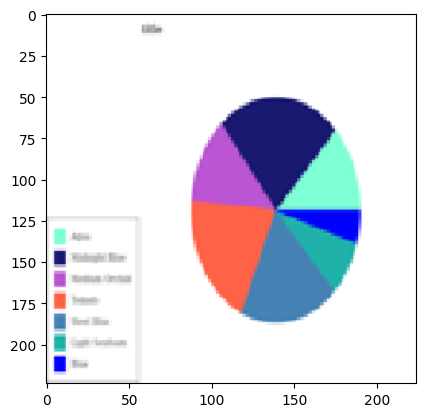

1/1 [==============================] - 0s 19ms/step
Prediction for 19.png: hbar_categorical


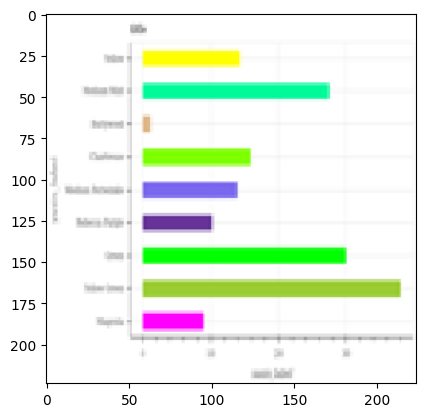

1/1 [==============================] - 0s 19ms/step
Prediction for 34.png: hbar_categorical


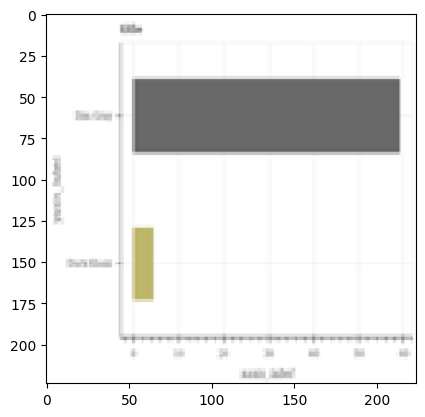

1/1 [==============================] - 0s 20ms/step
Prediction for 23.png: pie


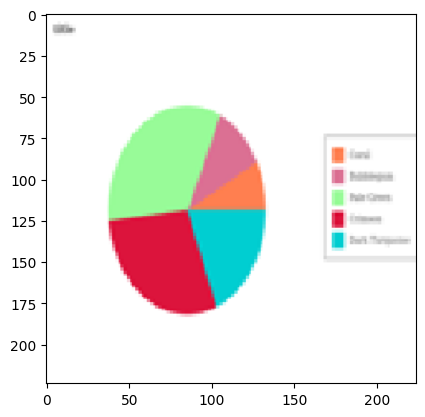

1/1 [==============================] - 0s 22ms/step
Prediction for 24.png: vbar_categorical


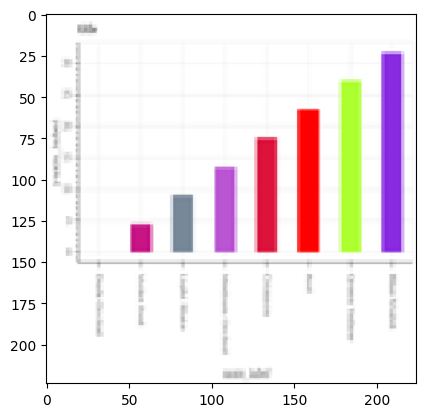

1/1 [==============================] - 0s 22ms/step
Prediction for 16.png: hbar_categorical


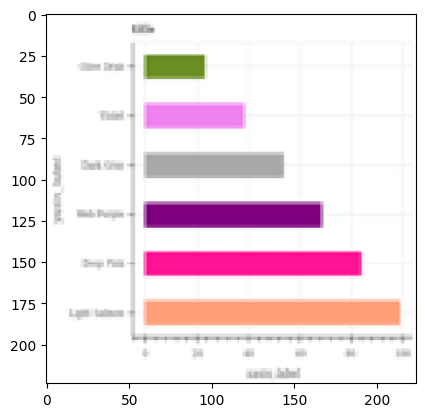

1/1 [==============================] - 0s 19ms/step
Prediction for 29.png: pie


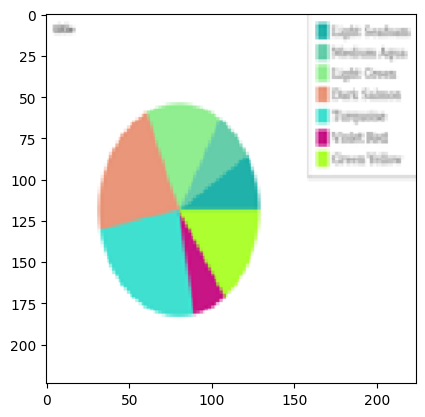

1/1 [==============================] - 0s 18ms/step
Prediction for 1.png: hbar_categorical


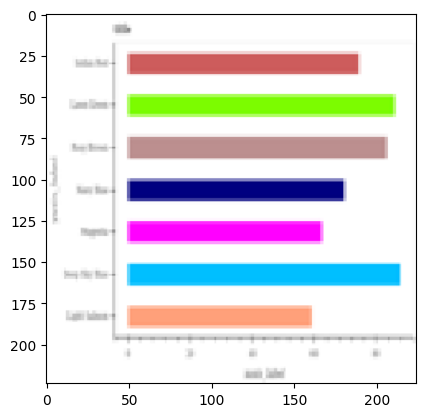

1/1 [==============================] - 0s 19ms/step
Prediction for 18.png: dot_line


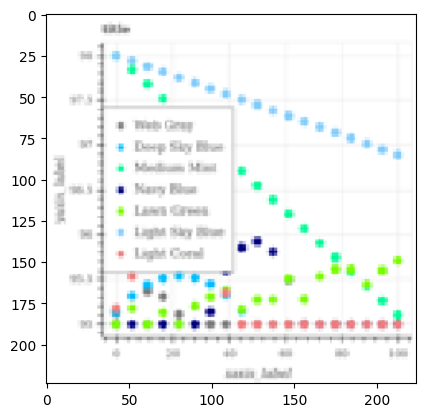

1/1 [==============================] - 0s 23ms/step
Prediction for 14.png: pie


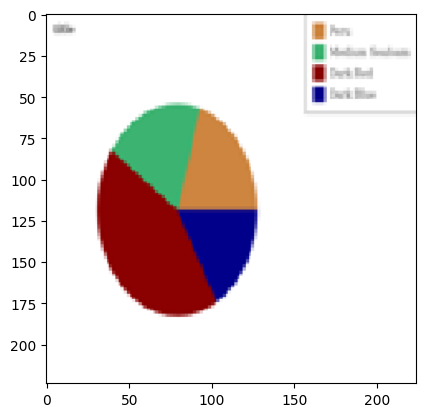

1/1 [==============================] - 0s 20ms/step
Prediction for 3.png: hbar_categorical


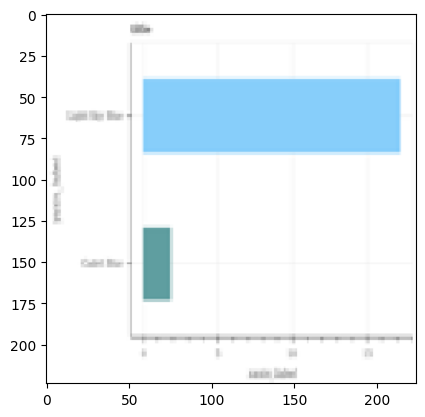

1/1 [==============================] - 0s 18ms/step
Prediction for 32.png: vbar_categorical


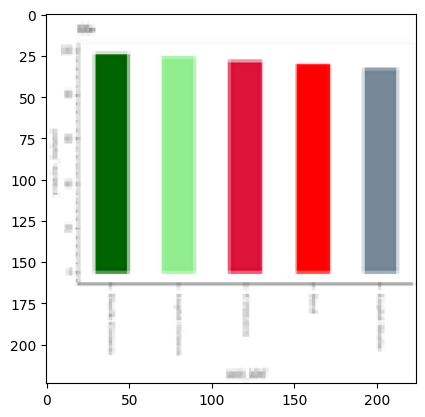

1/1 [==============================] - 0s 21ms/step
Prediction for 11.png: hbar_categorical


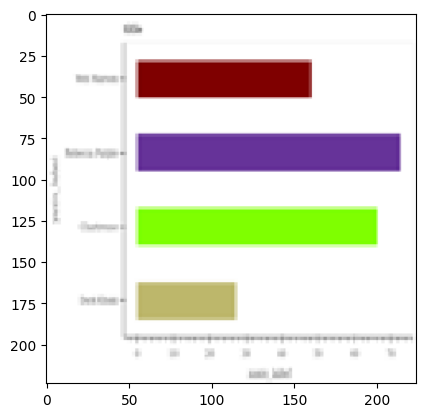

1/1 [==============================] - 0s 19ms/step
Prediction for 2.png: vbar_categorical


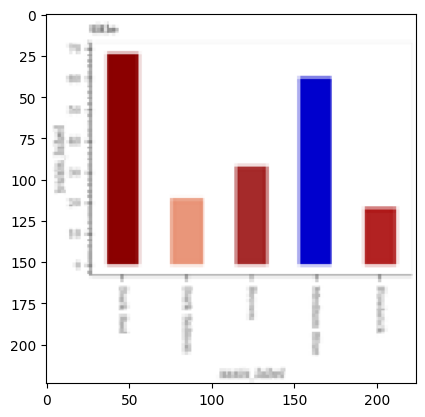

1/1 [==============================] - 0s 19ms/step
Prediction for 35.png: line


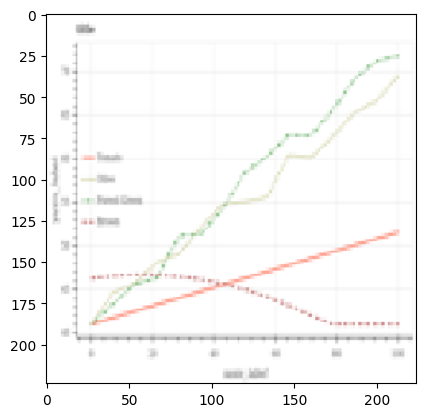

1/1 [==============================] - 0s 20ms/step
Prediction for 26.png: hbar_categorical


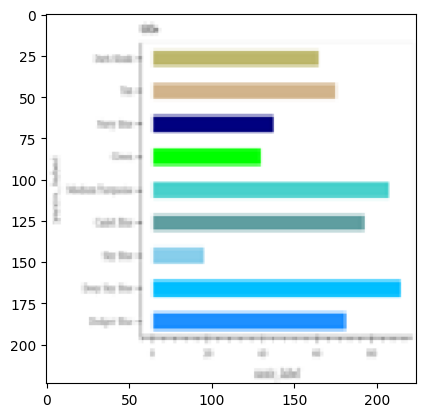

1/1 [==============================] - 0s 18ms/step
Prediction for 15.png: line


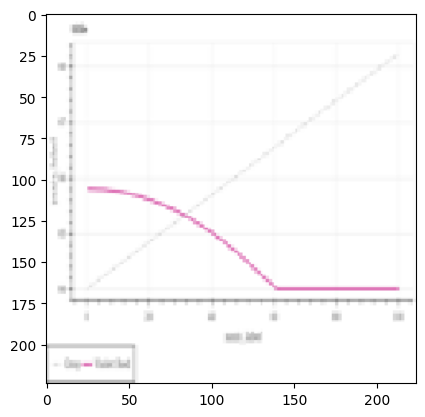

1/1 [==============================] - 0s 22ms/step
Prediction for 44.png: pie


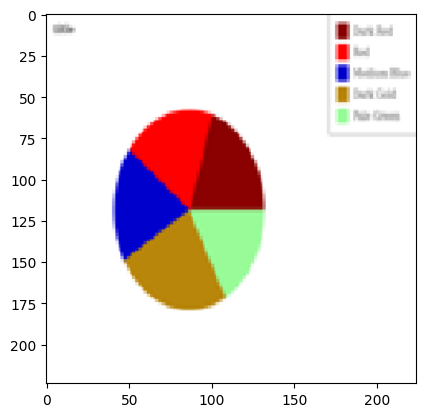

1/1 [==============================] - 0s 20ms/step
Prediction for 30.png: hbar_categorical


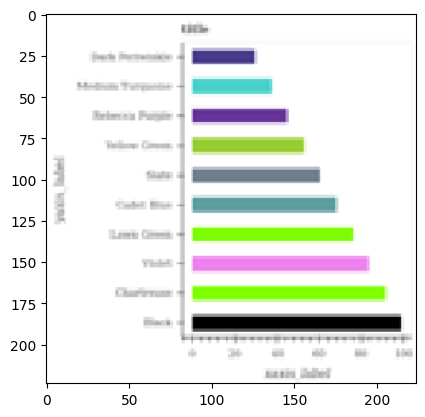

1/1 [==============================] - 0s 21ms/step
Prediction for 28.png: pie


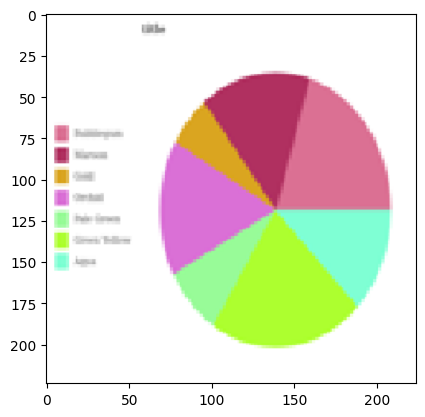

1/1 [==============================] - 0s 25ms/step
Prediction for 17.png: vbar_categorical


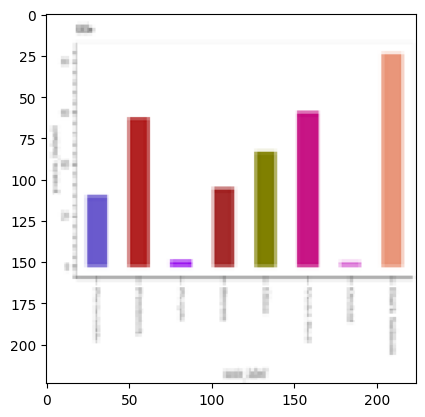

1/1 [==============================] - 0s 18ms/step
Prediction for 45.png: hbar_categorical


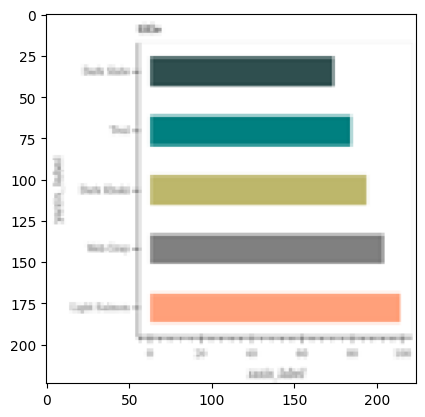

1/1 [==============================] - 0s 18ms/step
Prediction for 27.png: dot_line


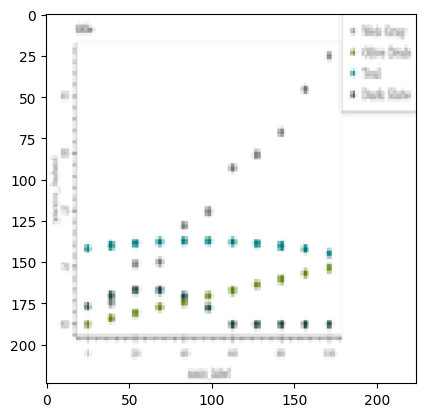

1/1 [==============================] - 0s 19ms/step
Prediction for 31.png: line


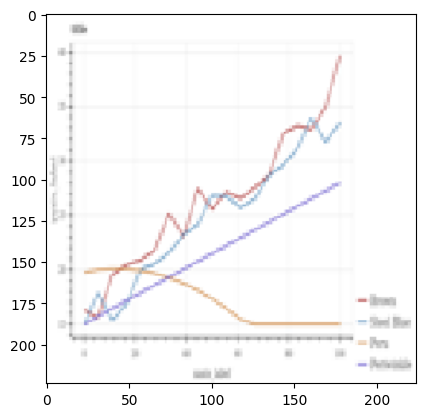

1/1 [==============================] - 0s 22ms/step
Prediction for 20.png: dot_line


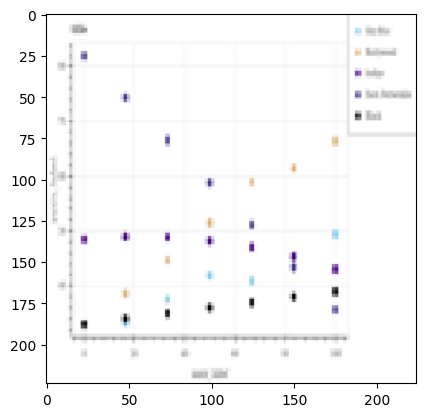

1/1 [==============================] - 0s 30ms/step
Prediction for 25.png: hbar_categorical


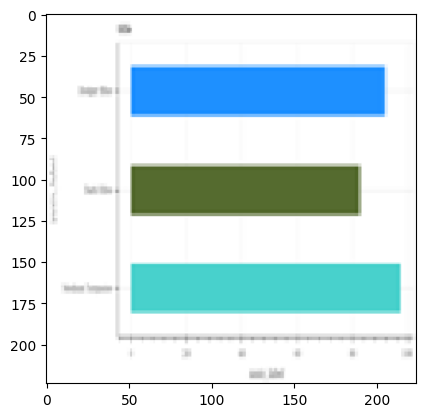

1/1 [==============================] - 0s 27ms/step
Prediction for 0.png: vbar_categorical


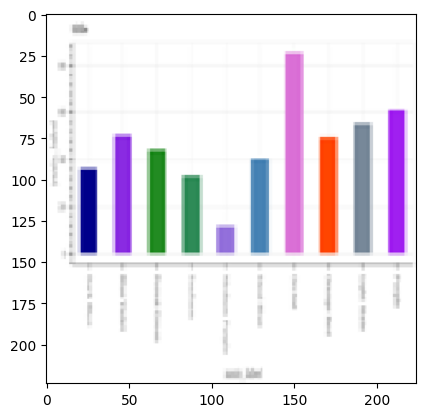

1/1 [==============================] - 0s 38ms/step
Prediction for 12.png: line


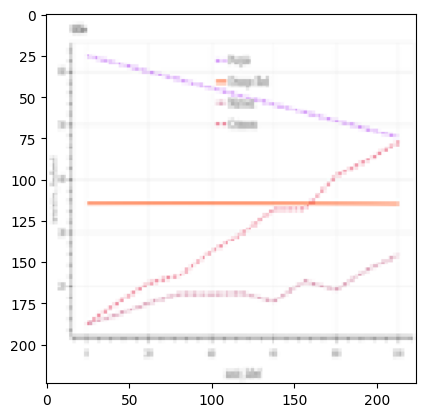

1/1 [==============================] - 0s 29ms/step
Prediction for 10.png: dot_line


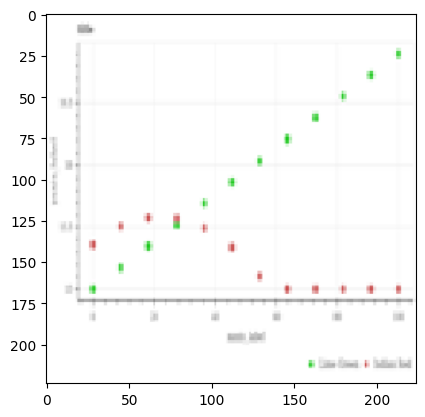

1/1 [==============================] - 0s 27ms/step
Prediction for 22.png: dot_line


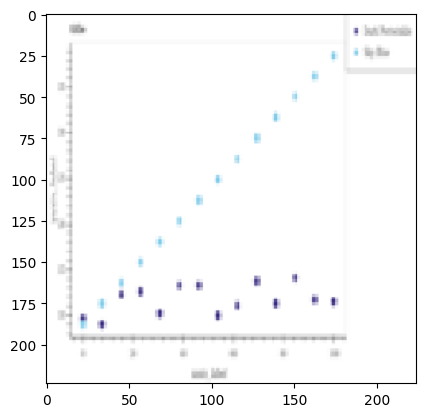

1/1 [==============================] - 0s 29ms/step
Prediction for 13.png: line


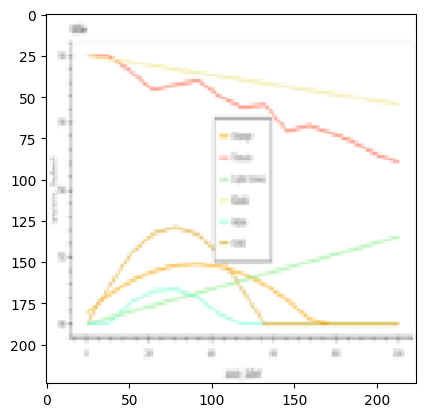

['line', 'line', 'hbar_categorical', 'vbar_categorical', 'dot_line', 'pie', 'line', 'vbar_categorical', 'line', 'vbar_categorical', 'dot_line', 'line', 'pie', 'dot_line', 'line', 'hbar_categorical', 'vbar_categorical', 'vbar_categorical', 'pie', 'pie', 'hbar_categorical', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'pie', 'hbar_categorical', 'dot_line', 'pie', 'hbar_categorical', 'vbar_categorical', 'hbar_categorical', 'vbar_categorical', 'line', 'hbar_categorical', 'line', 'pie', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'dot_line', 'line', 'dot_line', 'hbar_categorical', 'vbar_categorical', 'line', 'dot_line', 'dot_line', 'line']


In [85]:
# Evaluate the model on the validation set
val_loss, val_acc = model.evaluate(val_data)
print('Validation Accuracy:', val_acc)
test_dir = '/content/drive/MyDrive/charts/charts/charts/test'
predict_labels(test_dir, model)

Found 800 images belonging to 5 classes.
Found 200 images belonging to 5 classes.
Epoch 1/10
25/25 [==============================] - 17s 522ms/step - loss: 0.7236 - accuracy: 0.7725 - val_loss: 0.4423 - val_accuracy: 0.9400
Epoch 2/10
25/25 [==============================] - 12s 472ms/step - loss: 0.1621 - accuracy: 0.9700 - val_loss: 0.3011 - val_accuracy: 0.9500
Epoch 3/10
25/25 [==============================] - 12s 469ms/step - loss: 0.0941 - accuracy: 0.9825 - val_loss: 0.2480 - val_accuracy: 0.9500
Epoch 4/10
25/25 [==============================] - 12s 473ms/step - loss: 0.0761 - accuracy: 0.9875 - val_loss: 0.1745 - val_accuracy: 0.9700
Epoch 5/10
25/25 [==============================] - 12s 473ms/step - loss: 0.0677 - accuracy: 0.9875 - val_loss: 0.1561 - val_accuracy: 0.9600
Epoch 6/10
25/25 [==============================] - 13s 522ms/step - loss: 0.0450 - accuracy: 0.9937 - val_loss: 0.1490 - val_accuracy: 0.9600
Epoch 7/10
25/25 [==============================] - 11s 460m

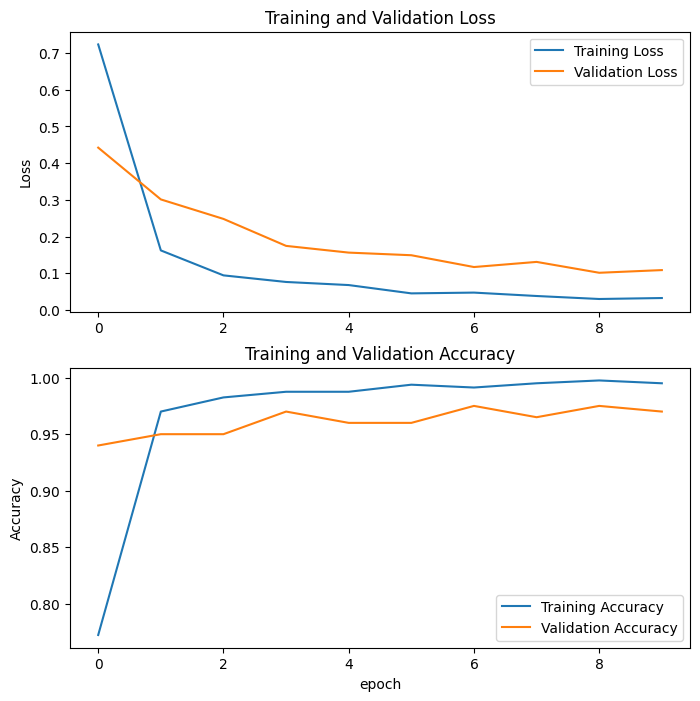

In [50]:
import tensorflow as tf

# Define the input shape
input_shape = (227, 227, 3)

# Define the AlexNet model
model = tf.keras.Sequential([
    # Layer 1
    tf.keras.layers.Conv2D(96, kernel_size=(11, 11), strides=(4, 4), activation='relu', input_shape=input_shape),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=(2, 2)),
    
    # Layer 2
    tf.keras.layers.Conv2D(256, kernel_size=(5, 5), strides=(1, 1), activation='relu', padding="same"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=(2, 2)),
    
    # Layer 3
    tf.keras.layers.Conv2D(384, kernel_size=(3, 3), strides=(1, 1), activation='relu', padding="same"),
    
    # Layer 4
    tf.keras.layers.Conv2D(384, kernel_size=(3, 3), strides=(1, 1), activation='relu', padding="same"),
    
    # Layer 5
    tf.keras.layers.Conv2D(256, kernel_size=(3, 3), strides=(1, 1), activation='relu', padding="same"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=(2, 2)),
    
    # Layer 6
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(4096, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    
    # Layer 7
    tf.keras.layers.Dense(4096, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(1000, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    
    # Layer 8
    tf.keras.layers.Dense(5, activation='softmax')
])

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])

# Define the training and validation data generators
train_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)
val_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

train_generator = train_data_gen.flow_from_directory('/content/drive/MyDrive/charts/charts/charts/train_split/train',
                                                      target_size=input_shape[:2],
                                                      batch_size=32,
                                                      class_mode='categorical')

val_generator = val_data_gen.flow_from_directory('/content/drive/MyDrive/charts/charts/charts/train_split/val',
                                                  target_size=input_shape[:2],
                                                  batch_size=32,
                                                  class_mode='categorical')

# Train the model
history = model.fit(train_generator,
                    steps_per_epoch=train_generator.samples // train_generator.batch_size,
                    epochs=20,
                    validation_data=val_generator,
                    validation_steps=val_generator.samples // val_generator.batch_size)

# Plot the training and validation loss
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xlim(0,20)
plt.legend()
plt.show()

# Evaluate the model on the validation set
val_loss, val_acc = model.evaluate(val_generator)
print('Validation Accuracy:', val_acc)

7/7 [==============================] - 1s 82ms/step - loss: 0.1085 - accuracy: 0.9700
Validation Accuracy: 0.9700000286102295
1/1 [==============================] - 1s 1s/step
Prediction for 4.png: line


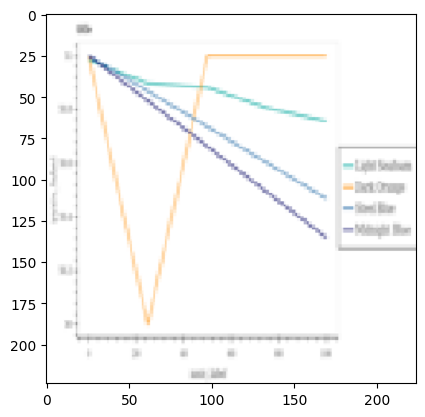

1/1 [==============================] - 0s 25ms/step
Prediction for 5.png: line


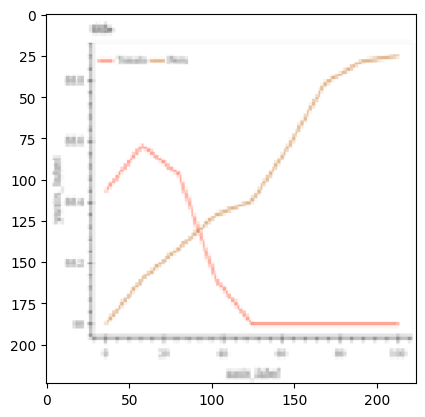

1/1 [==============================] - 0s 25ms/step
Prediction for 33.png: hbar_categorical


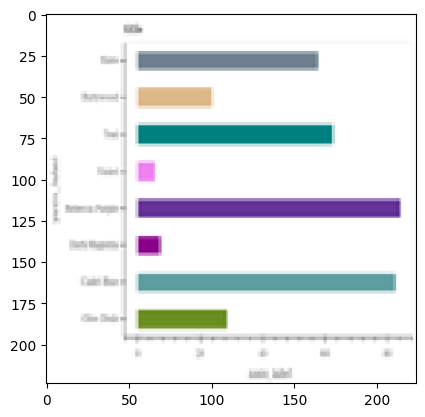

1/1 [==============================] - 0s 25ms/step
Prediction for 38.png: vbar_categorical


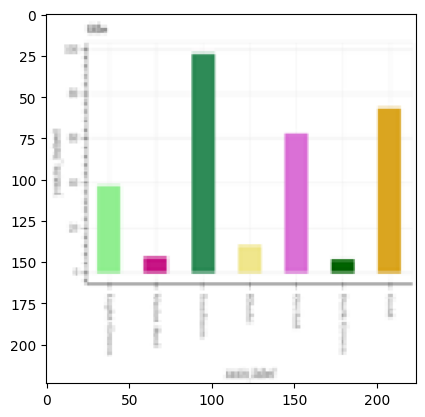

1/1 [==============================] - 0s 25ms/step
Prediction for 40.png: dot_line


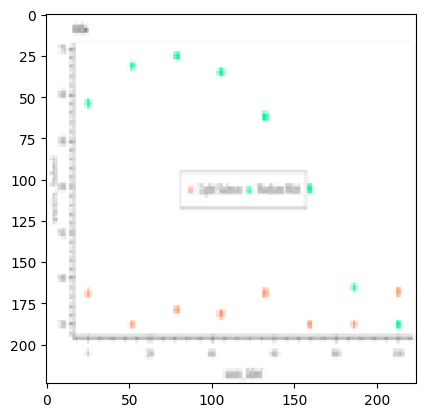

1/1 [==============================] - 0s 25ms/step
Prediction for 48.png: pie


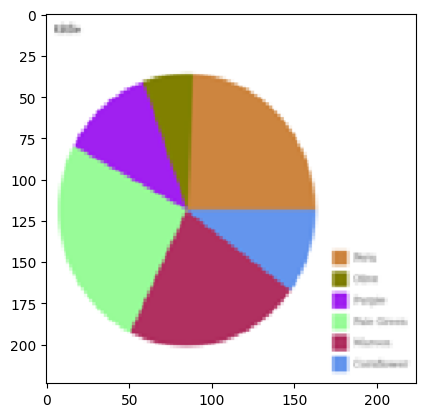

1/1 [==============================] - 0s 27ms/step
Prediction for 9.png: line


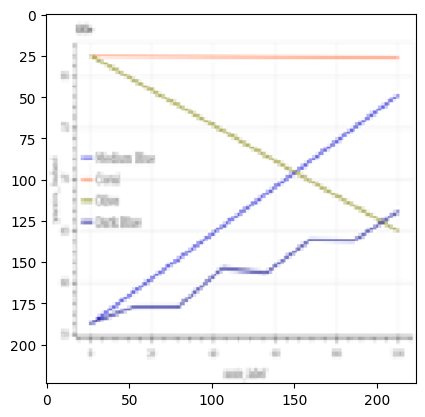

1/1 [==============================] - 0s 24ms/step
Prediction for 41.png: vbar_categorical


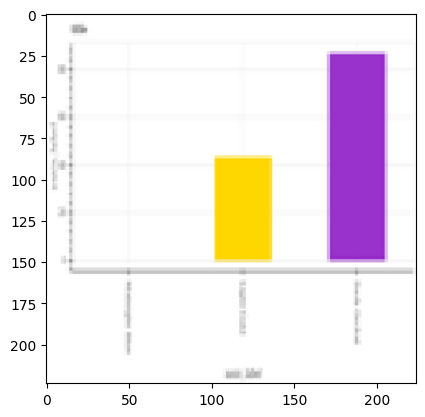

1/1 [==============================] - 0s 24ms/step
Prediction for 8.png: line


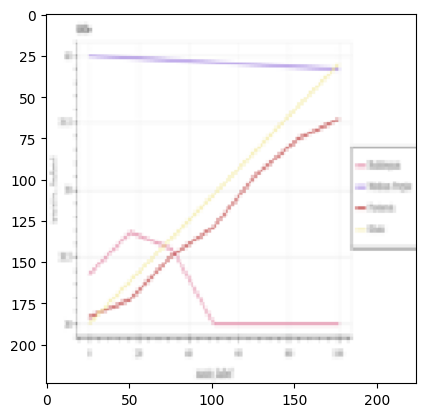

1/1 [==============================] - 0s 30ms/step
Prediction for 6.png: vbar_categorical


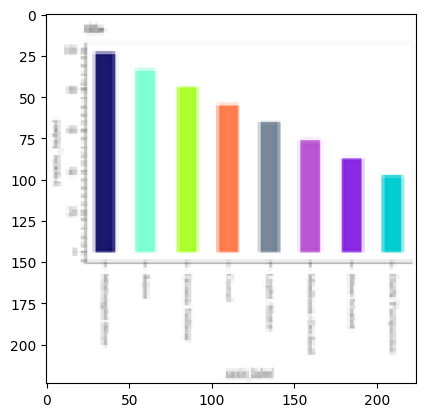

1/1 [==============================] - 0s 25ms/step
Prediction for 39.png: dot_line


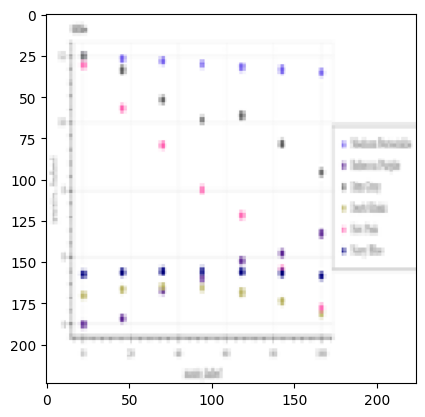

1/1 [==============================] - 0s 24ms/step
Prediction for 49.png: line


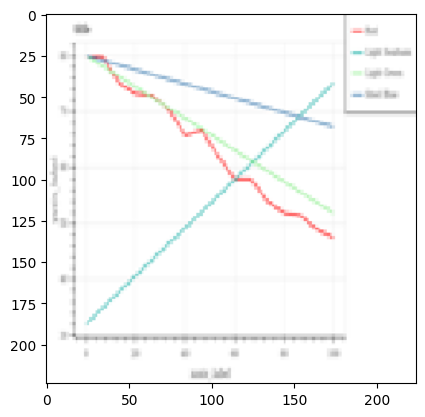

1/1 [==============================] - 0s 26ms/step
Prediction for 47.png: pie


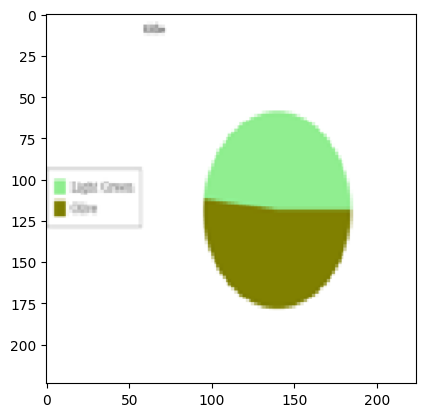

1/1 [==============================] - 0s 25ms/step
Prediction for 37.png: dot_line


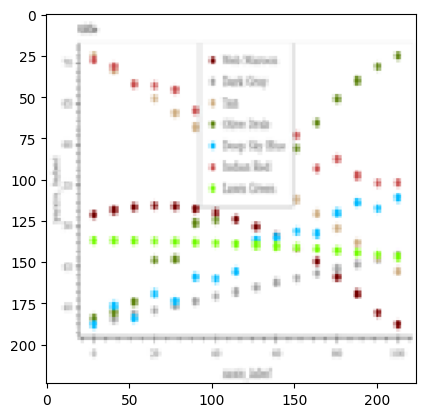

1/1 [==============================] - 0s 25ms/step
Prediction for 46.png: line


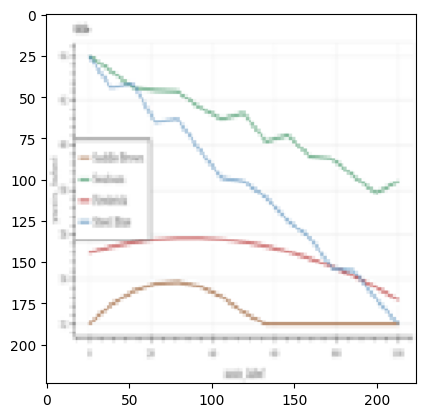

1/1 [==============================] - 0s 24ms/step
Prediction for 43.png: hbar_categorical


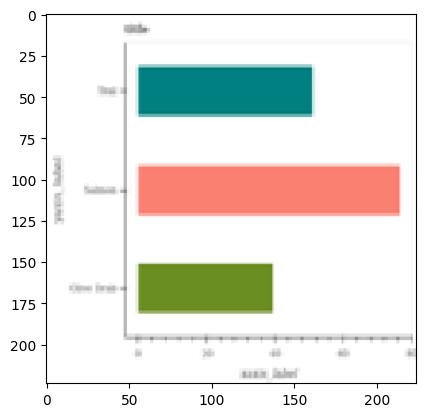

1/1 [==============================] - 0s 25ms/step
Prediction for 36.png: vbar_categorical


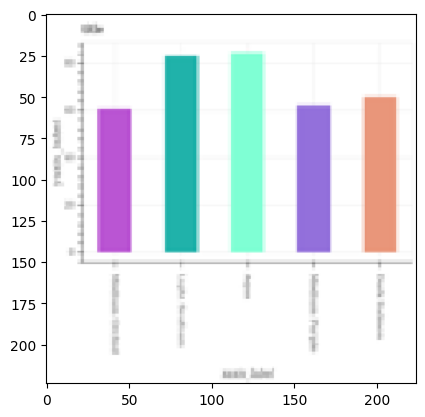

1/1 [==============================] - 0s 36ms/step
Prediction for 7.png: vbar_categorical


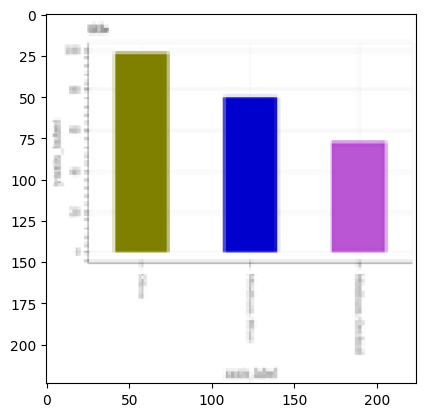

1/1 [==============================] - 0s 25ms/step
Prediction for 42.png: pie


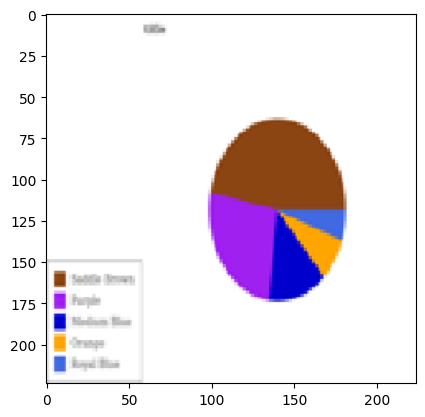

1/1 [==============================] - 0s 24ms/step
Prediction for 21.png: pie


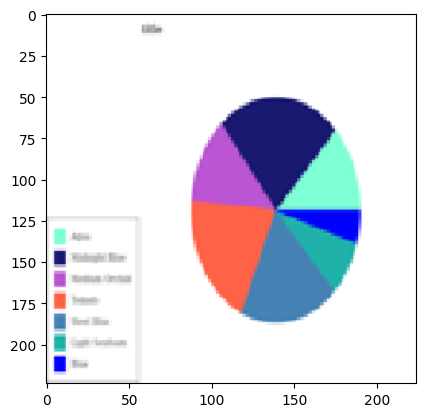

1/1 [==============================] - 0s 25ms/step
Prediction for 19.png: hbar_categorical


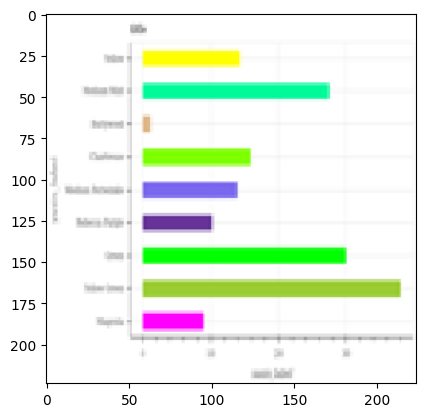

1/1 [==============================] - 0s 24ms/step
Prediction for 34.png: hbar_categorical


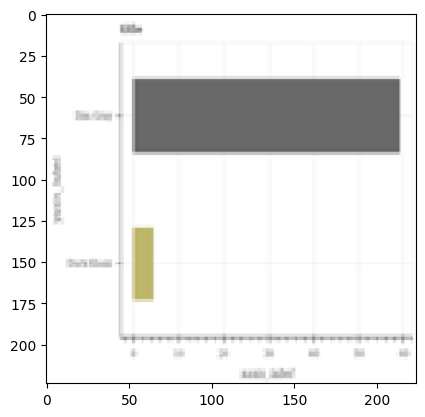

1/1 [==============================] - 0s 27ms/step
Prediction for 23.png: pie


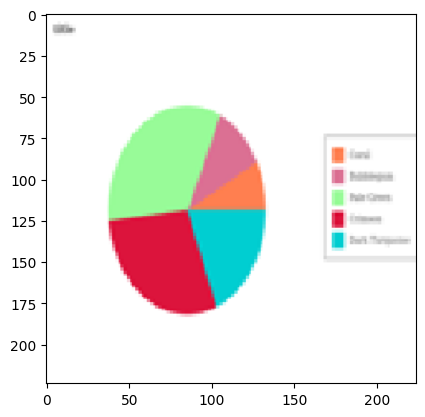

1/1 [==============================] - 0s 26ms/step
Prediction for 24.png: vbar_categorical


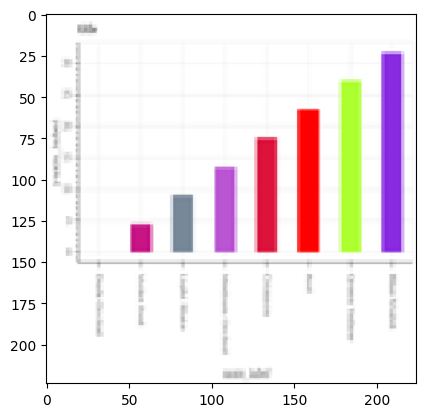

1/1 [==============================] - 0s 25ms/step
Prediction for 16.png: hbar_categorical


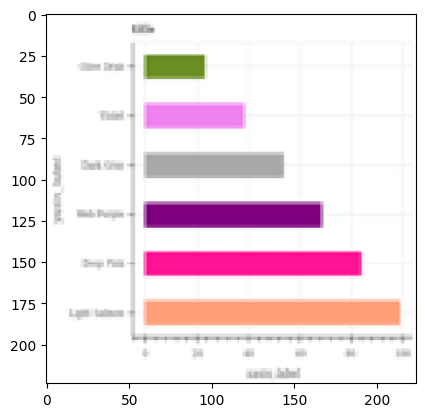

1/1 [==============================] - 0s 31ms/step
Prediction for 29.png: pie


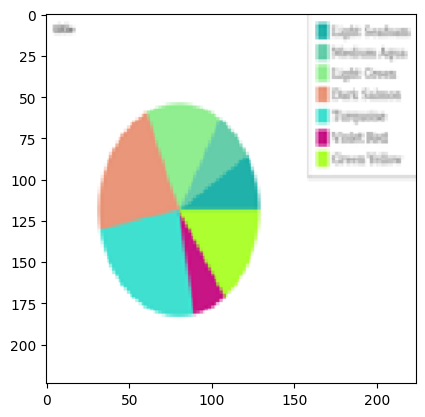

1/1 [==============================] - 0s 25ms/step
Prediction for 1.png: hbar_categorical


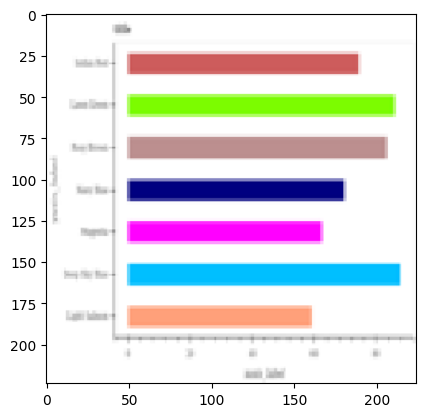

1/1 [==============================] - 0s 24ms/step
Prediction for 18.png: dot_line


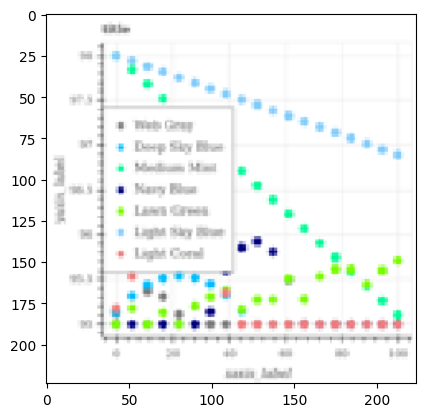

1/1 [==============================] - 0s 35ms/step
Prediction for 14.png: pie


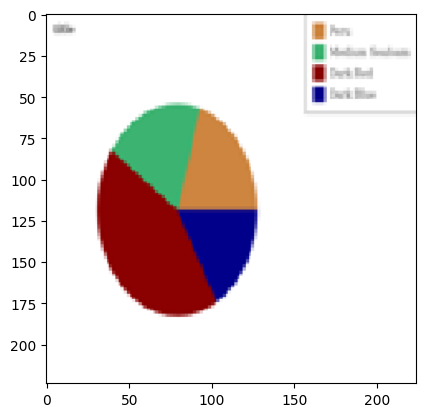

1/1 [==============================] - 0s 36ms/step
Prediction for 3.png: hbar_categorical


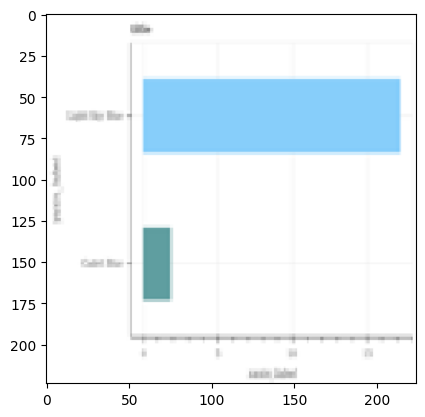

1/1 [==============================] - 0s 36ms/step
Prediction for 32.png: vbar_categorical


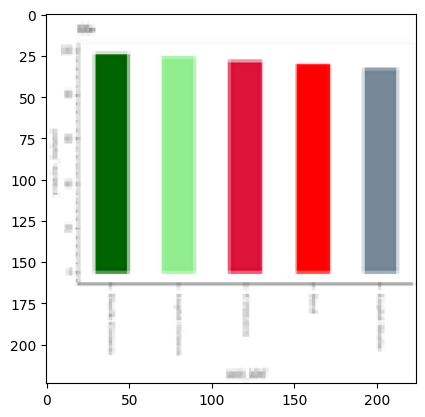

1/1 [==============================] - 0s 37ms/step
Prediction for 11.png: hbar_categorical


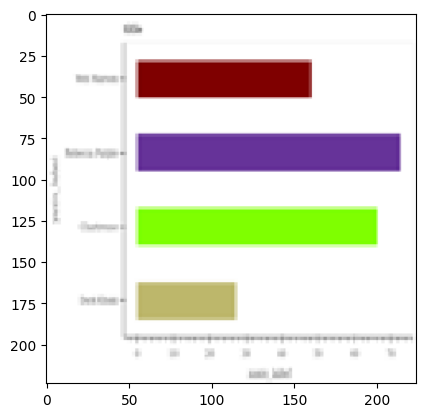

1/1 [==============================] - 0s 37ms/step
Prediction for 2.png: vbar_categorical


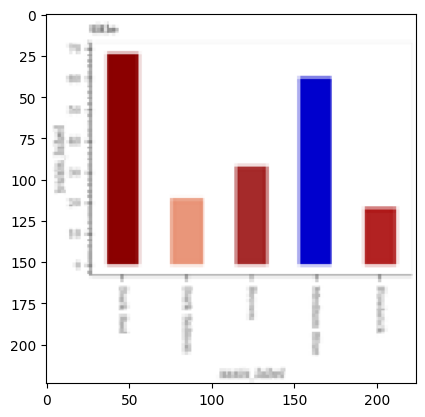

1/1 [==============================] - 0s 35ms/step
Prediction for 35.png: line


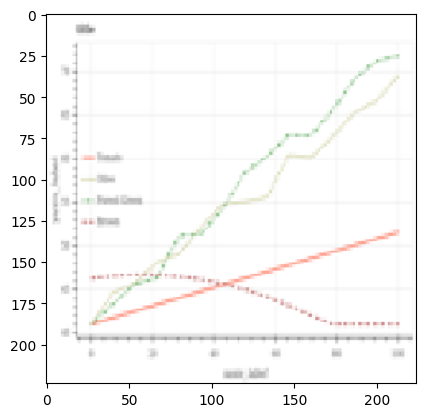

1/1 [==============================] - 0s 39ms/step
Prediction for 26.png: hbar_categorical


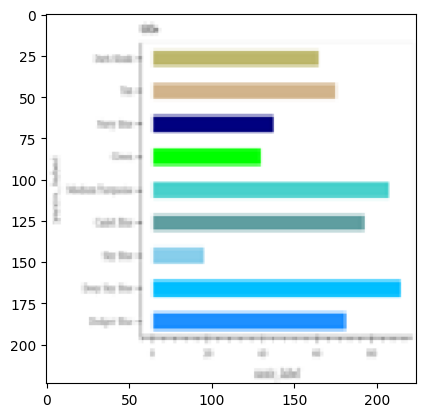

1/1 [==============================] - 0s 38ms/step
Prediction for 15.png: line


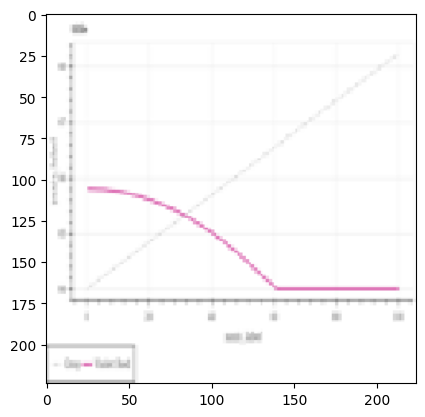

1/1 [==============================] - 0s 36ms/step
Prediction for 44.png: pie


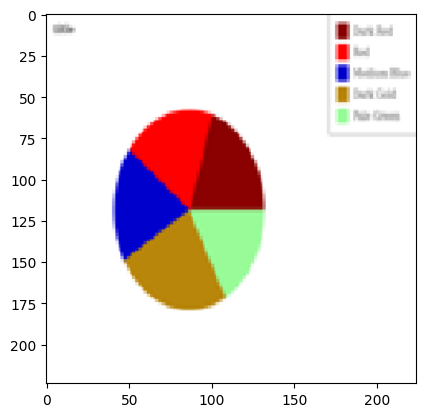

1/1 [==============================] - 0s 39ms/step
Prediction for 30.png: hbar_categorical


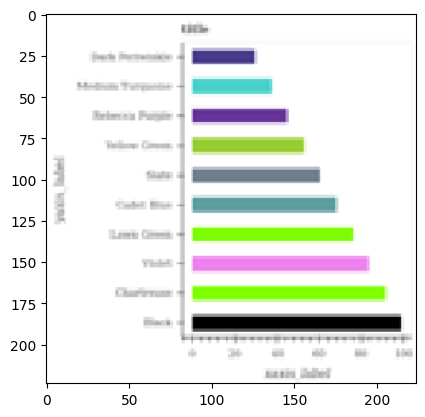

1/1 [==============================] - 0s 39ms/step
Prediction for 28.png: pie


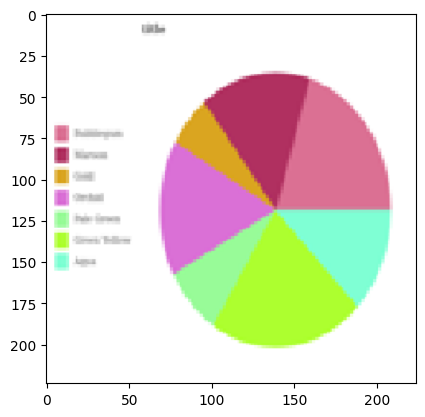

1/1 [==============================] - 0s 24ms/step
Prediction for 17.png: vbar_categorical


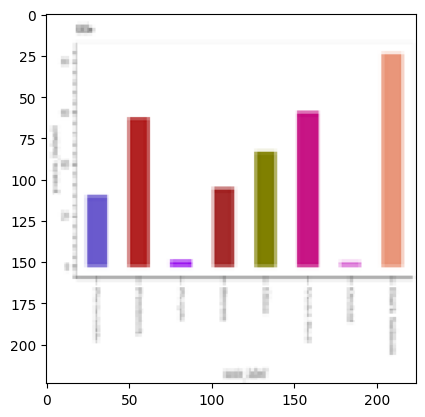

1/1 [==============================] - 0s 24ms/step
Prediction for 45.png: hbar_categorical


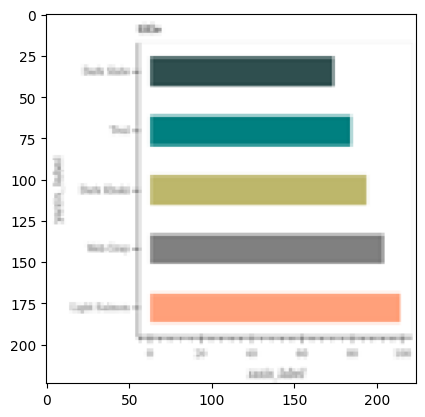

1/1 [==============================] - 0s 26ms/step
Prediction for 27.png: dot_line


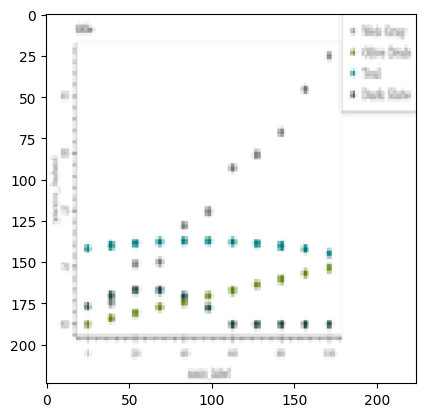

1/1 [==============================] - 0s 23ms/step
Prediction for 31.png: line


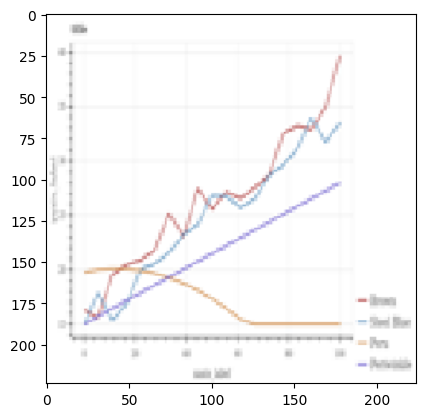

1/1 [==============================] - 0s 27ms/step
Prediction for 20.png: dot_line


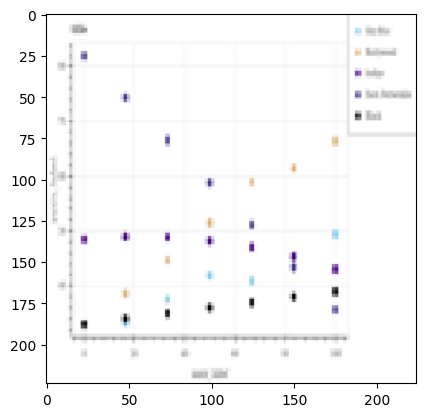

1/1 [==============================] - 0s 25ms/step
Prediction for 25.png: hbar_categorical


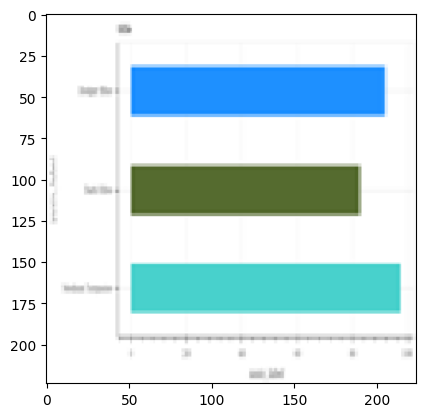

1/1 [==============================] - 0s 26ms/step
Prediction for 0.png: vbar_categorical


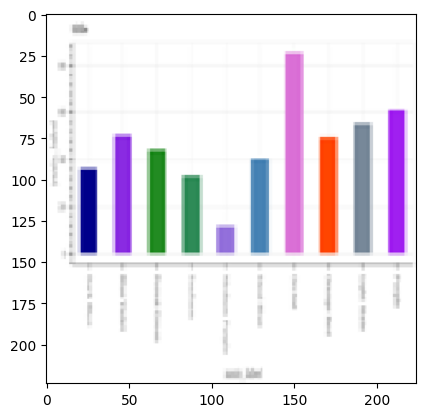

1/1 [==============================] - 0s 25ms/step
Prediction for 12.png: line


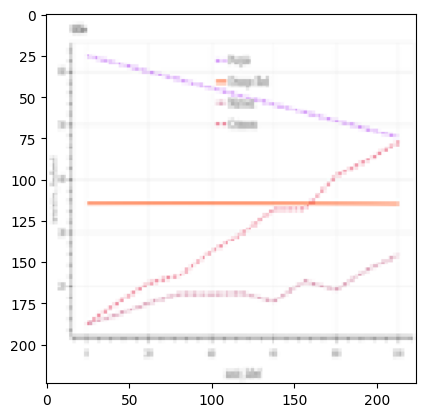

1/1 [==============================] - 0s 27ms/step
Prediction for 10.png: dot_line


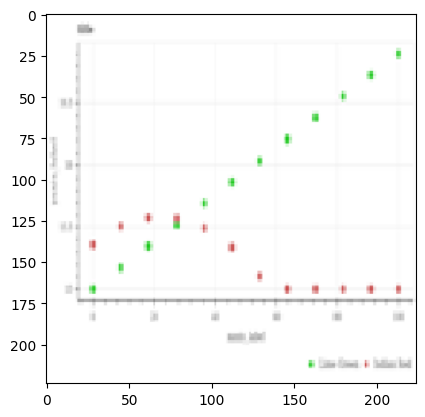

1/1 [==============================] - 0s 31ms/step
Prediction for 22.png: dot_line


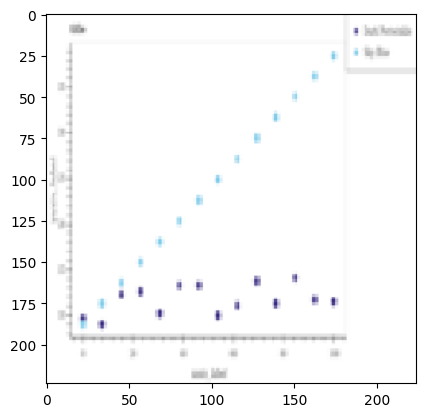

1/1 [==============================] - 0s 26ms/step
Prediction for 13.png: line


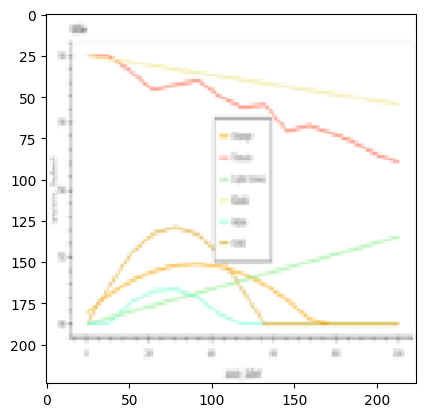

['line', 'line', 'hbar_categorical', 'vbar_categorical', 'dot_line', 'pie', 'line', 'vbar_categorical', 'line', 'vbar_categorical', 'dot_line', 'line', 'pie', 'dot_line', 'line', 'hbar_categorical', 'vbar_categorical', 'vbar_categorical', 'pie', 'pie', 'hbar_categorical', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'pie', 'hbar_categorical', 'dot_line', 'pie', 'hbar_categorical', 'vbar_categorical', 'hbar_categorical', 'vbar_categorical', 'line', 'hbar_categorical', 'line', 'pie', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'dot_line', 'line', 'dot_line', 'hbar_categorical', 'vbar_categorical', 'line', 'dot_line', 'dot_line', 'line']


In [51]:
# Evaluate the model on the validation set
val_loss, val_acc = model.evaluate(val_data)
print('Validation Accuracy:', val_acc)
test_dir = '/content/drive/MyDrive/charts/charts/charts/test'
predict_labels(test_dir, model)

Found 800 images belonging to 5 classes.
Found 200 images belonging to 5 classes.
Epoch 1/10
25/25 [==============================] - 13s 468ms/step - loss: 1.5740 - accuracy: 0.7262 - val_loss: 8.8351e-05 - val_accuracy: 1.0000
Epoch 2/10
25/25 [==============================] - 13s 506ms/step - loss: 0.1195 - accuracy: 0.9725 - val_loss: 1.1906e-04 - val_accuracy: 1.0000
Epoch 3/10
25/25 [==============================] - 12s 468ms/step - loss: 0.0709 - accuracy: 0.9825 - val_loss: 0.0046 - val_accuracy: 1.0000
Epoch 4/10
25/25 [==============================] - 15s 571ms/step - loss: 0.0762 - accuracy: 0.9862 - val_loss: 4.8075e-05 - val_accuracy: 1.0000
Epoch 5/10
25/25 [==============================] - 12s 465ms/step - loss: 0.0417 - accuracy: 0.9912 - val_loss: 2.4136e-05 - val_accuracy: 1.0000
Epoch 6/10
25/25 [==============================] - 11s 450ms/step - loss: 0.0535 - accuracy: 0.9887 - val_loss: 2.4523e-04 - val_accuracy: 1.0000
Epoch 7/10
25/25 [======================

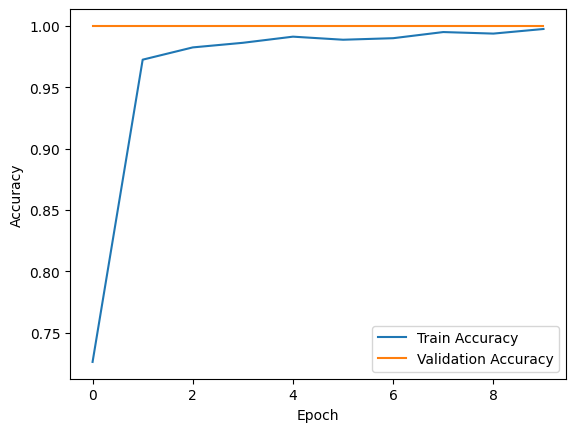

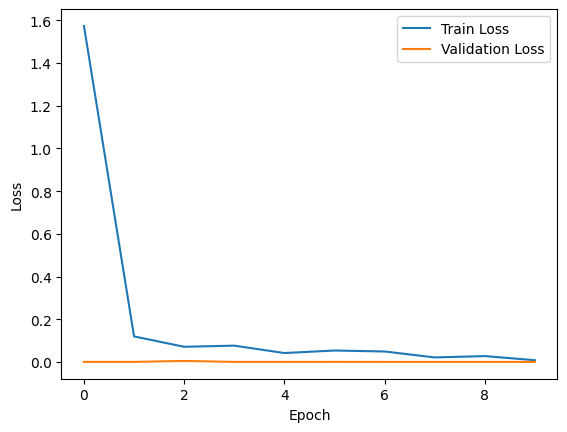

In [63]:
# Set the image size and batch size
img_size = (224, 224)
batch_size = 32

# Set the train and test data directories
train_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/train'
test_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/val'

# Define the data generator for train and test data
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)
test_datagen = ImageDataGenerator(rescale=1./255)

# Generate the train and test data
train_data = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical')
test_data = test_datagen.flow_from_directory(
    test_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical')

# Define the VGG16 model
base_model = tf.keras.applications.VGG16(
    input_shape=img_size + (3,),
    include_top=False,
    weights='imagenet')

# Freeze the layers of the pre-trained model
for layer in base_model.layers:
    layer.trainable = False

# Add the classification layers on top of the pre-trained model
model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1024, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(5, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(train_data, epochs=10, validation_data=test_data)

# Evaluate the model on the test data
test_loss, test_acc = model.evaluate(test_data)
train_loss, train_acc = model.evaluate(train_data)

print('Test Loss:', test_loss)
print('Test Accuracy:', test_acc)
print('Train Loss:', train_loss)
print('Train Accuracy:', train_acc)

# Plot the loss and accuracy curves for train and test data
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


7/7 [==============================] - 1s 157ms/step
conf_matrix :  

[[40, 0, 0, 0, 0], [0, 40, 0, 0, 0], [0, 0, 40, 0, 0], [0, 0, 0, 40, 0], [0, 0, 0, 0, 40]] 



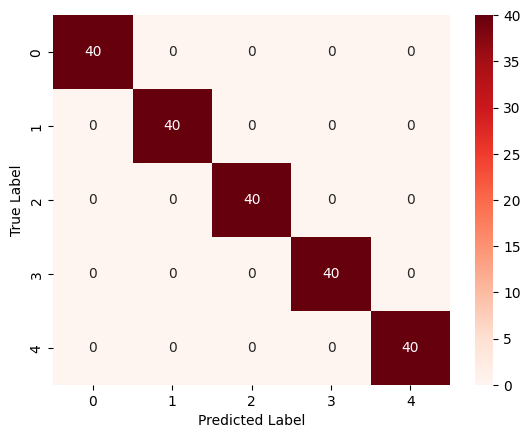

In [90]:
# Evaluate the model on the validation data
val_loss, val_acc = model.evaluate(val_data)

# Predict the labels for the validation data
y_pred = model.predict(val_data)
y_pred_classes = np.argmax(y_pred, axis=1)

# Get the true labels for the validation data
y_true = val_data.classes

# Calculate the confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred_classes)

# Print the confusion matrix
print("conf_matrix : ","\n")
print(conf_matrix,"\n")
sns.heatmap(conf_matrix, annot=True, cmap="Reds", fmt="d")
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


7/7 [==============================] - 1s 132ms/step - loss: 1.7866e-04 - accuracy: 1.0000
Validation Accuracy: 1.0
1/1 [==============================] - 0s 242ms/step
Prediction for 4.png: line


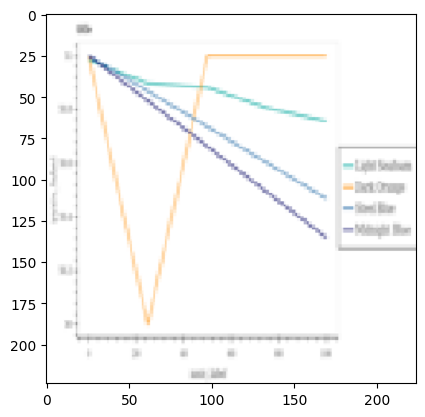

1/1 [==============================] - 0s 35ms/step
Prediction for 5.png: line


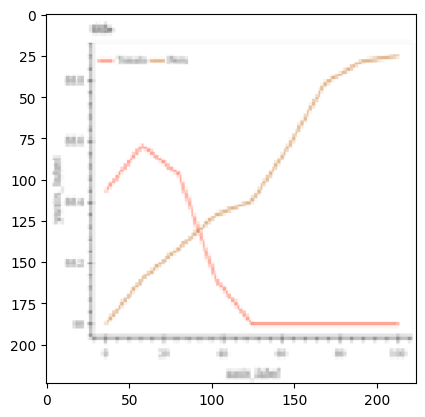

1/1 [==============================] - 0s 28ms/step
Prediction for 33.png: hbar_categorical


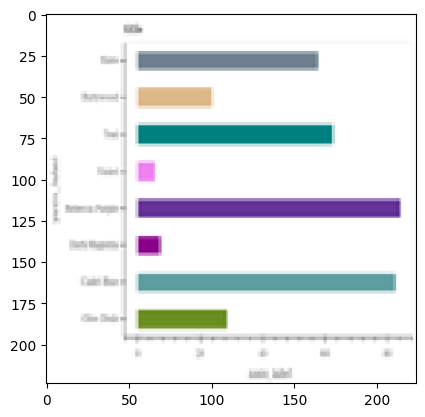

1/1 [==============================] - 0s 21ms/step
Prediction for 38.png: vbar_categorical


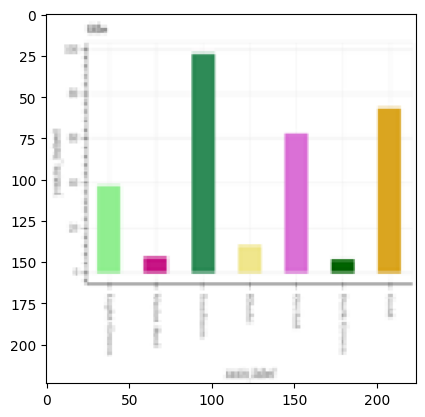

1/1 [==============================] - 0s 20ms/step
Prediction for 40.png: dot_line


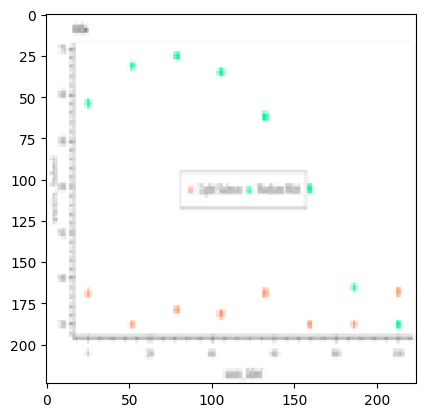

1/1 [==============================] - 0s 21ms/step
Prediction for 48.png: pie


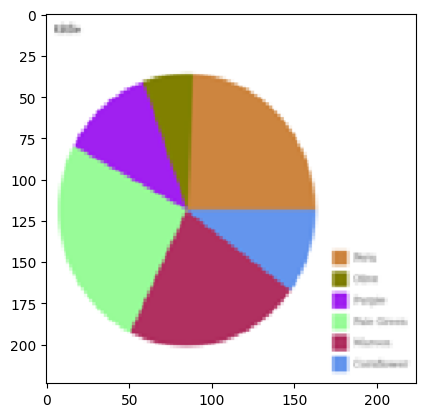

1/1 [==============================] - 0s 21ms/step
Prediction for 9.png: line


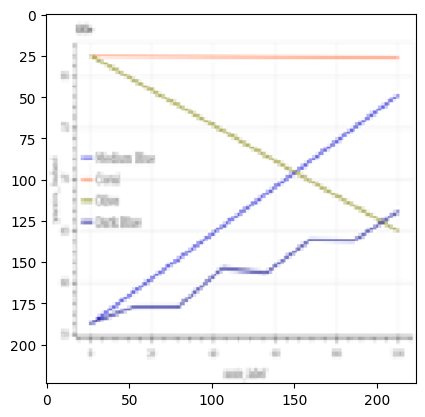

1/1 [==============================] - 0s 19ms/step
Prediction for 41.png: vbar_categorical


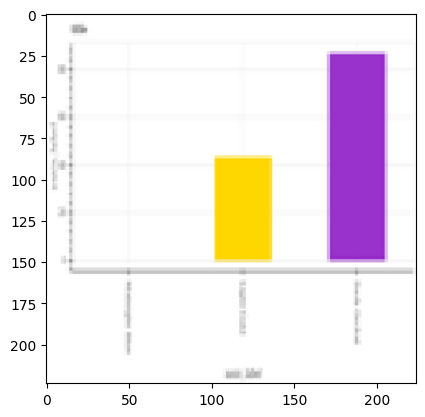

1/1 [==============================] - 0s 20ms/step
Prediction for 8.png: line


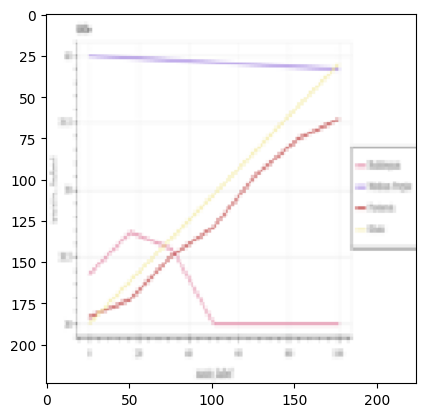

1/1 [==============================] - 0s 19ms/step
Prediction for 6.png: vbar_categorical


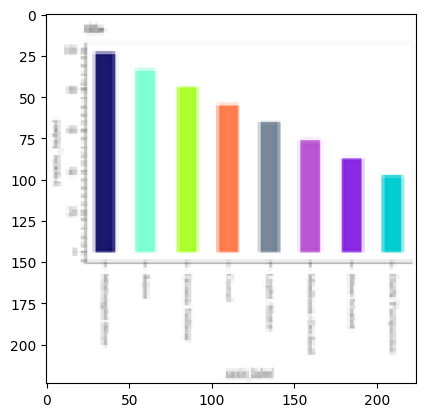

1/1 [==============================] - 0s 19ms/step
Prediction for 39.png: dot_line


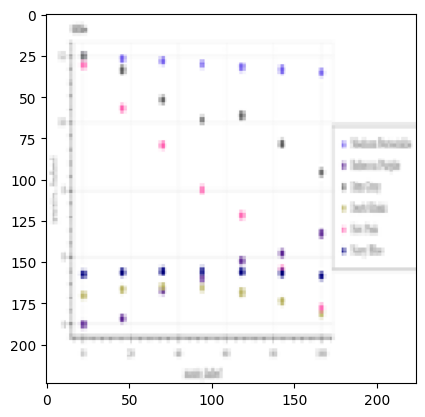

1/1 [==============================] - 0s 25ms/step
Prediction for 49.png: line


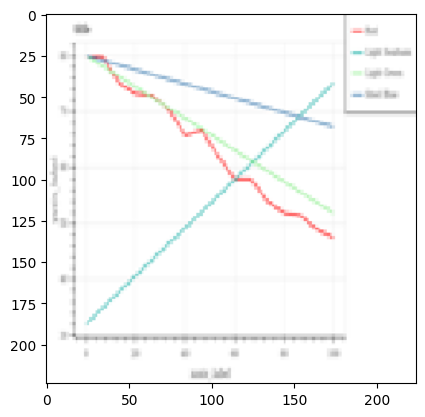

1/1 [==============================] - 0s 21ms/step
Prediction for 47.png: pie


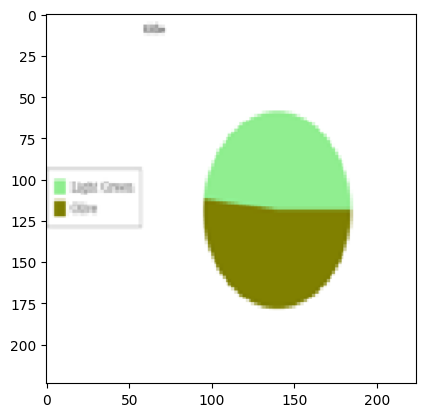

1/1 [==============================] - 0s 19ms/step
Prediction for 37.png: dot_line


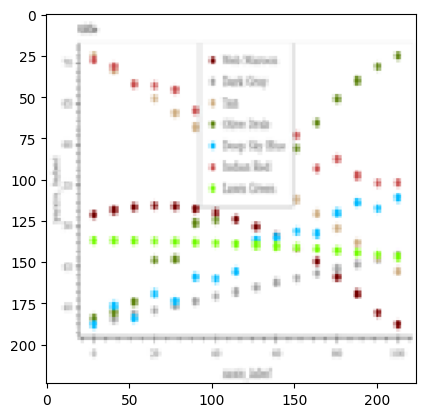

1/1 [==============================] - 0s 20ms/step
Prediction for 46.png: line


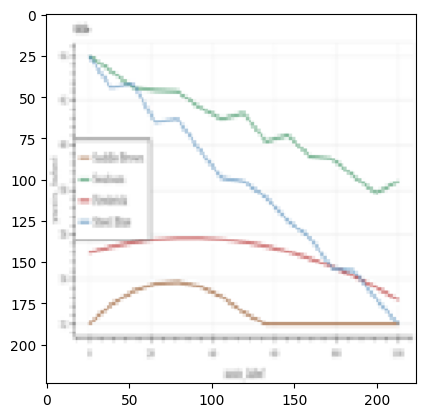

1/1 [==============================] - 0s 20ms/step
Prediction for 43.png: hbar_categorical


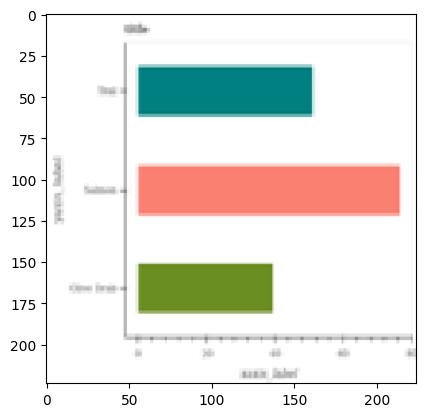

1/1 [==============================] - 0s 21ms/step
Prediction for 36.png: vbar_categorical


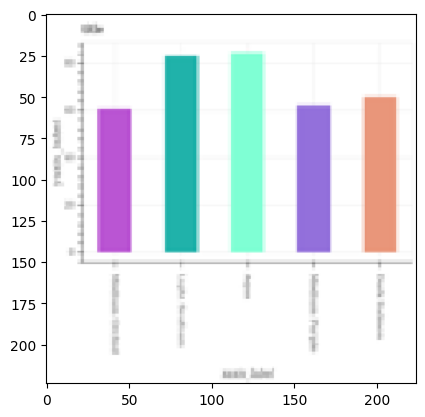

1/1 [==============================] - 0s 21ms/step
Prediction for 7.png: vbar_categorical


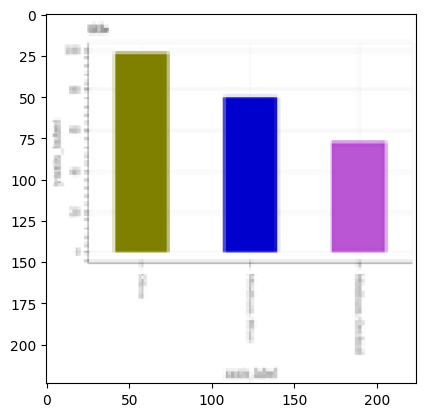

1/1 [==============================] - 0s 20ms/step
Prediction for 42.png: pie


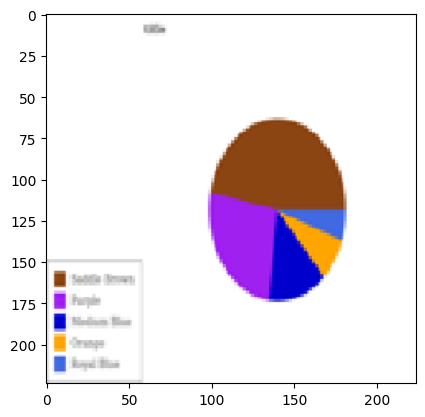

1/1 [==============================] - 0s 20ms/step
Prediction for 21.png: pie


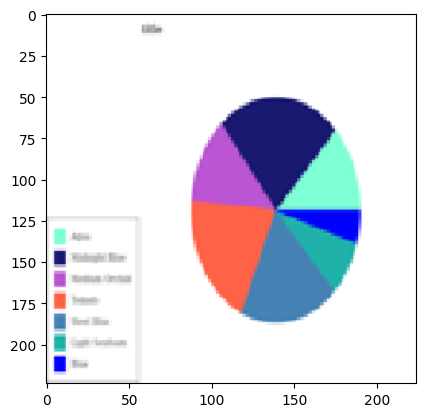

1/1 [==============================] - 0s 19ms/step
Prediction for 19.png: hbar_categorical


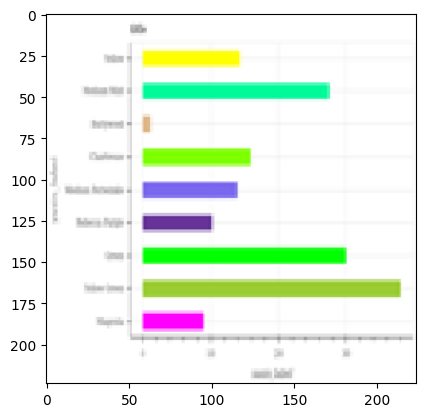

1/1 [==============================] - 0s 22ms/step
Prediction for 34.png: hbar_categorical


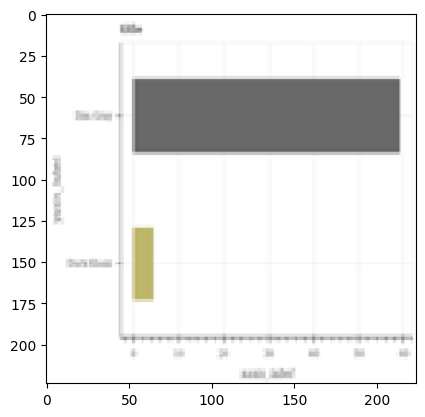

1/1 [==============================] - 0s 28ms/step
Prediction for 23.png: pie


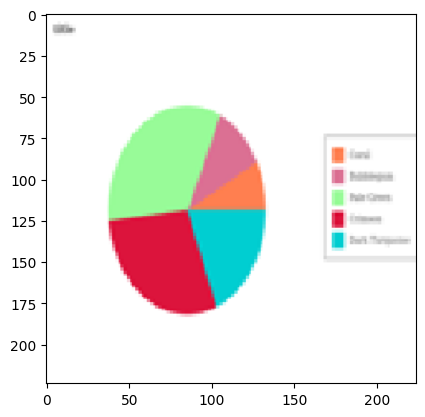

1/1 [==============================] - 0s 22ms/step
Prediction for 24.png: vbar_categorical


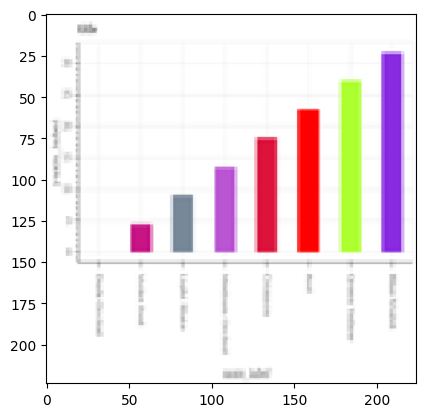

1/1 [==============================] - 0s 22ms/step
Prediction for 16.png: hbar_categorical


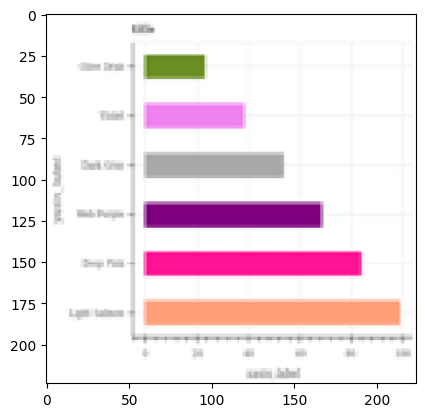

1/1 [==============================] - 0s 27ms/step
Prediction for 29.png: pie


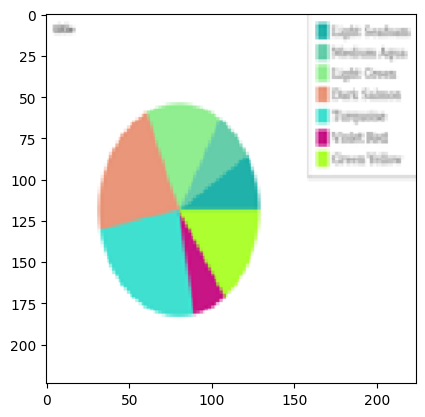

1/1 [==============================] - 0s 20ms/step
Prediction for 1.png: hbar_categorical


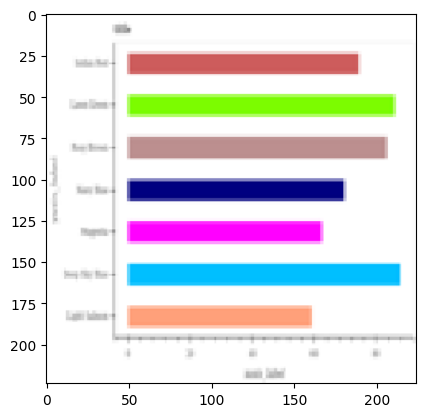

1/1 [==============================] - 0s 27ms/step
Prediction for 18.png: dot_line


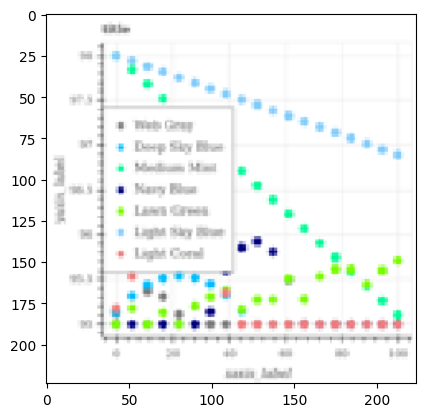

1/1 [==============================] - 0s 27ms/step
Prediction for 14.png: pie


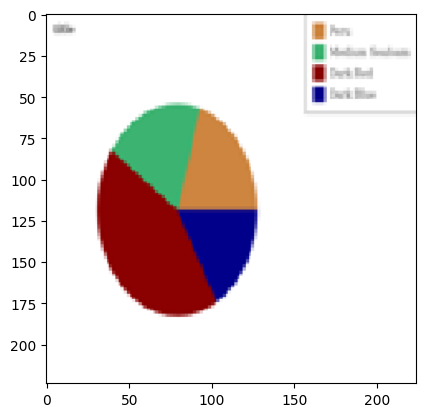

1/1 [==============================] - 0s 21ms/step
Prediction for 3.png: hbar_categorical


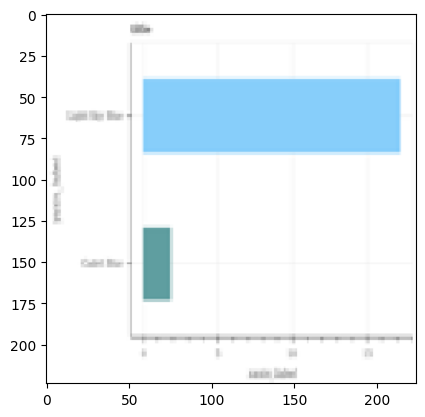

1/1 [==============================] - 0s 20ms/step
Prediction for 32.png: vbar_categorical


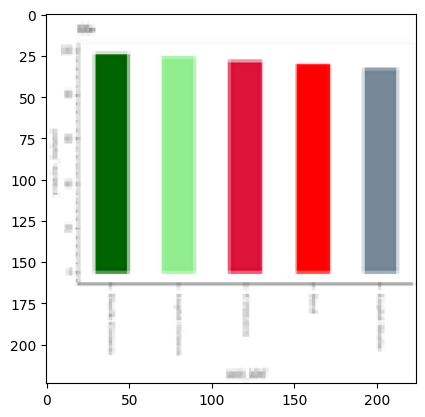

1/1 [==============================] - 0s 30ms/step
Prediction for 11.png: hbar_categorical


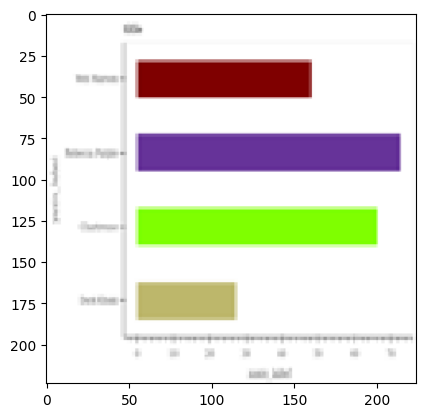

1/1 [==============================] - 0s 25ms/step
Prediction for 2.png: vbar_categorical


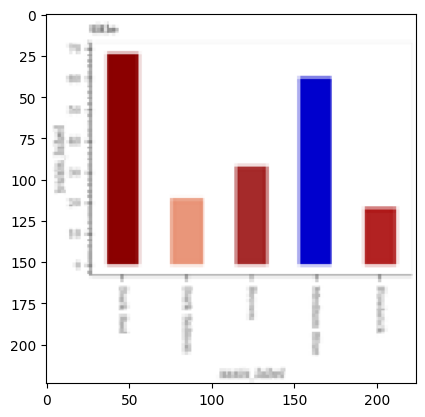

1/1 [==============================] - 0s 36ms/step
Prediction for 35.png: line


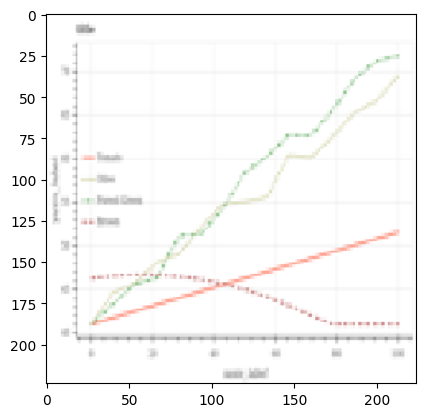

1/1 [==============================] - 0s 21ms/step
Prediction for 26.png: hbar_categorical


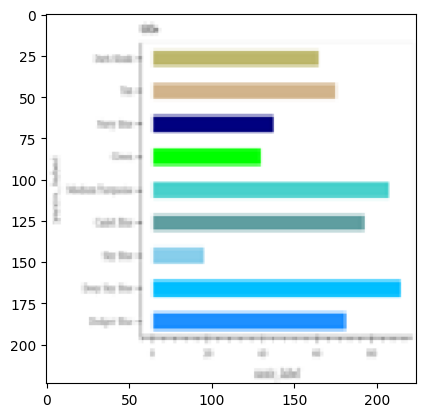

1/1 [==============================] - 0s 24ms/step
Prediction for 15.png: line


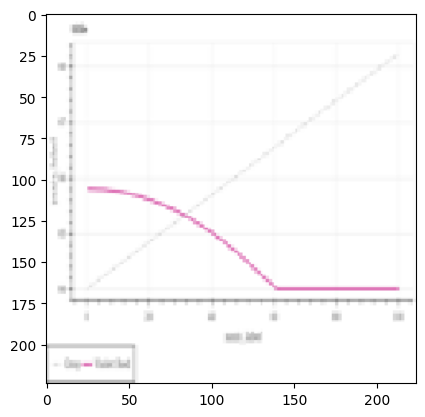

1/1 [==============================] - 0s 21ms/step
Prediction for 44.png: pie


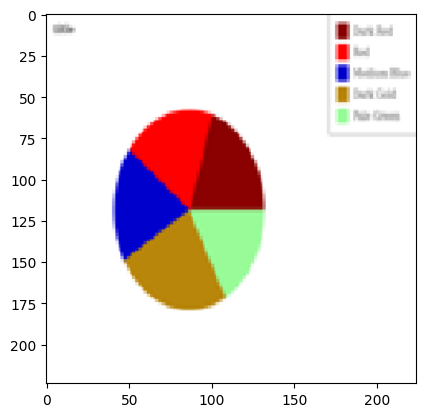

1/1 [==============================] - 0s 25ms/step
Prediction for 30.png: hbar_categorical


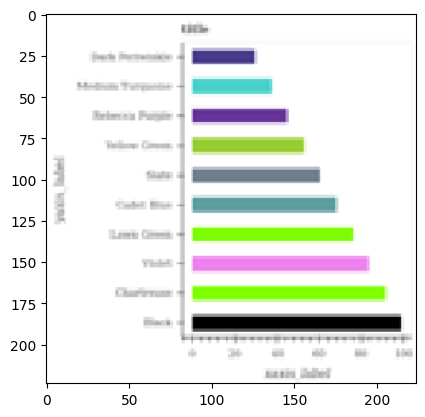

1/1 [==============================] - 0s 31ms/step
Prediction for 28.png: pie


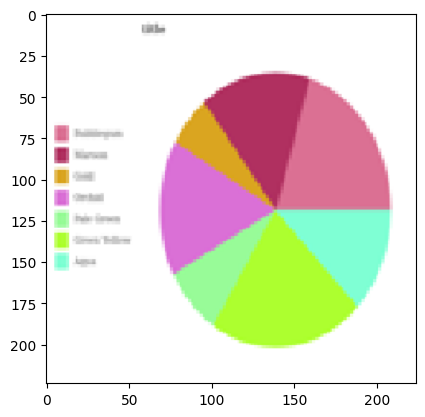

1/1 [==============================] - 0s 33ms/step
Prediction for 17.png: vbar_categorical


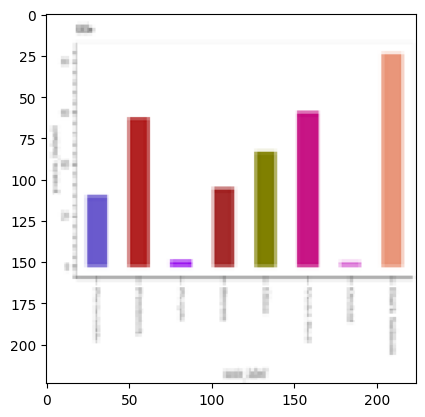

1/1 [==============================] - 0s 29ms/step
Prediction for 45.png: hbar_categorical


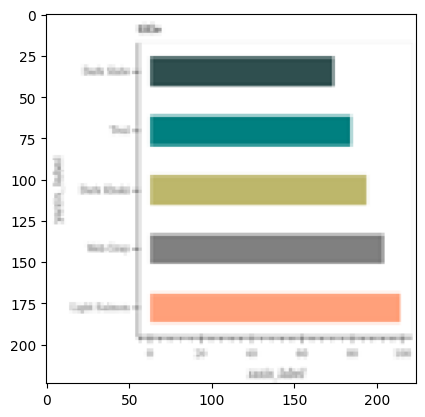

1/1 [==============================] - 0s 33ms/step
Prediction for 27.png: dot_line


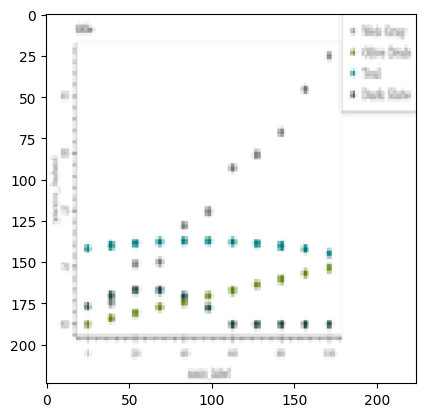

1/1 [==============================] - 0s 29ms/step
Prediction for 31.png: line


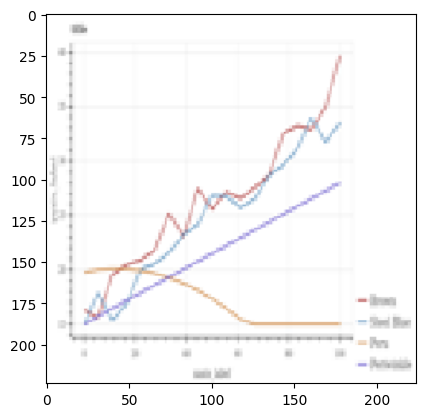

1/1 [==============================] - 0s 38ms/step
Prediction for 20.png: dot_line


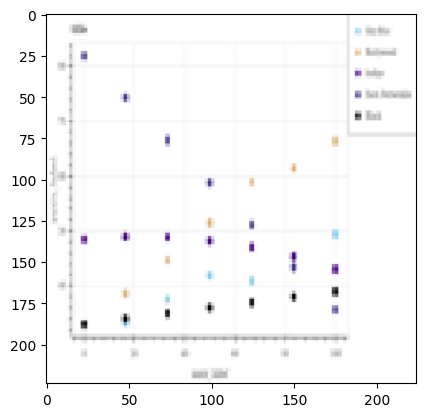

1/1 [==============================] - 0s 31ms/step
Prediction for 25.png: hbar_categorical


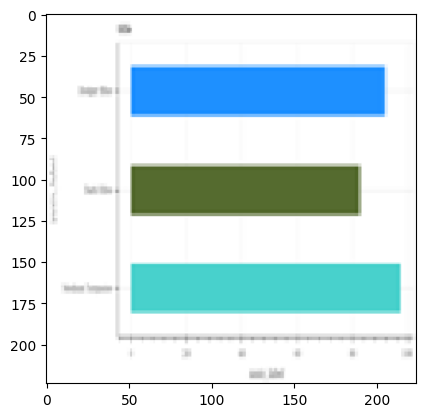

1/1 [==============================] - 0s 30ms/step
Prediction for 0.png: vbar_categorical


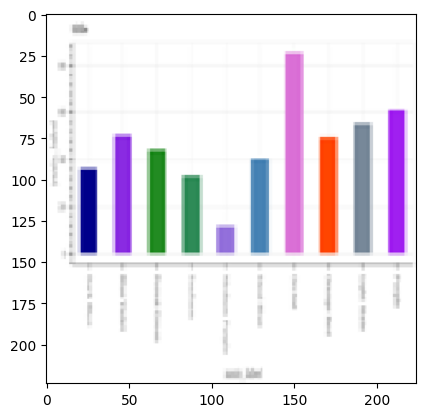

1/1 [==============================] - 0s 41ms/step
Prediction for 12.png: line


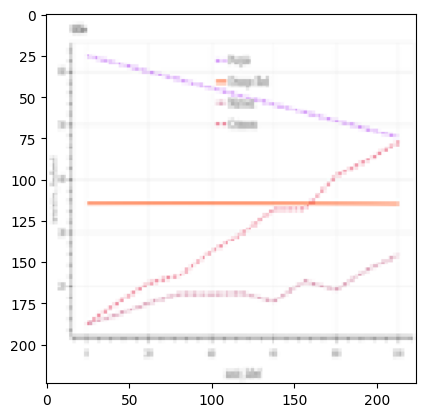

1/1 [==============================] - 0s 30ms/step
Prediction for 10.png: dot_line


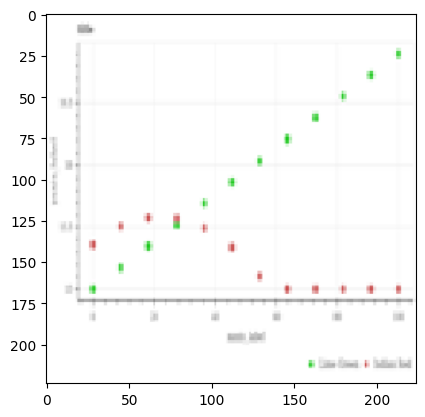

1/1 [==============================] - 0s 47ms/step
Prediction for 22.png: dot_line


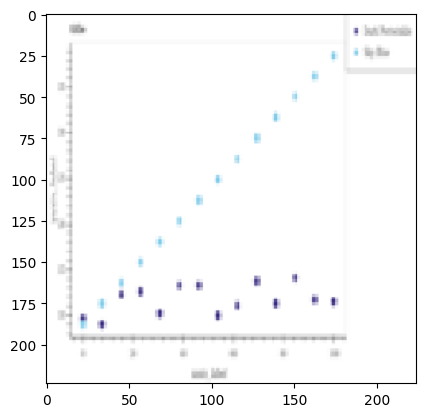

1/1 [==============================] - 0s 30ms/step
Prediction for 13.png: line


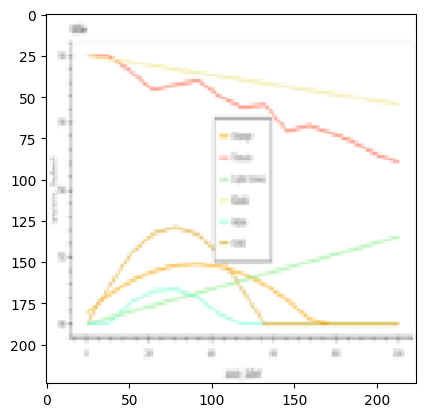

['line', 'line', 'hbar_categorical', 'vbar_categorical', 'dot_line', 'pie', 'line', 'vbar_categorical', 'line', 'vbar_categorical', 'dot_line', 'line', 'pie', 'dot_line', 'line', 'hbar_categorical', 'vbar_categorical', 'vbar_categorical', 'pie', 'pie', 'hbar_categorical', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'pie', 'hbar_categorical', 'dot_line', 'pie', 'hbar_categorical', 'vbar_categorical', 'hbar_categorical', 'vbar_categorical', 'line', 'hbar_categorical', 'line', 'pie', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'dot_line', 'line', 'dot_line', 'hbar_categorical', 'vbar_categorical', 'line', 'dot_line', 'dot_line', 'line']


In [91]:
# Evaluate the model on the validation set
val_loss, val_acc = model.evaluate(val_data)
print('Validation Accuracy:', val_acc)
test_dir = '/content/drive/MyDrive/charts/charts/charts/test'
predict_labels(test_dir, model)

Found 800 images belonging to 5 classes.
Found 200 images belonging to 5 classes.


Epoch 1/10
25/25 [==============================] - 16s 509ms/step - loss: 0.8799 - accuracy: 0.8138 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 2/10
25/25 [==============================] - 12s 459ms/step - loss: 0.0399 - accuracy: 0.9912 - val_loss: 0.0043 - val_accuracy: 1.0000
Epoch 3/10
25/25 [==============================] - 12s 481ms/step - loss: 0.0298 - accuracy: 0.9900 - val_loss: 8.2182e-05 - val_accuracy: 1.0000
Epoch 4/10
25/25 [==============================] - 12s 490ms/step - loss: 0.0131 - accuracy: 0.9937 - val_loss: 2.6240e-04 - val_accuracy: 1.0000
Epoch 5/10
25/25 [==============================] - 12s 476ms/step - loss: 0.0062 - accuracy: 0.9987 - val_loss: 0.0026 - val_accuracy: 1.0000
Epoch 6/10
25/25 [==============================] - 12s 496ms/step - loss: 0.0033 - accuracy: 1.0000 - val_loss: 4.5127e-04 - val_accuracy: 1.0000
Epoch 7/10
25/25 [==============================] - 12s 483ms/step - loss: 0.0051 - accuracy: 0.9987 - val_loss: 1.3622e-04 - val_

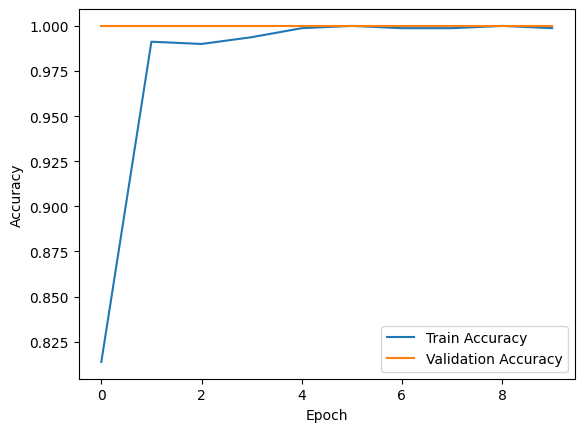

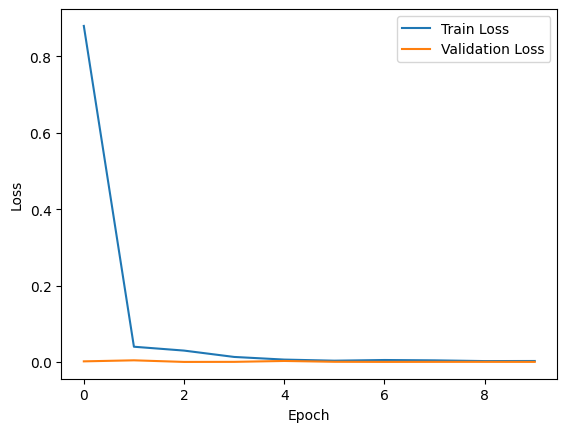

In [87]:
# Define image size and batch size
img_size = (224, 224)
batch_size = 32

# Define directories for train and test data
train_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/train'
test_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/val'

# Create data generators for train and test data
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

# Define the VGG19 model
base_model = tf.keras.applications.VGG19(
    input_shape=img_size + (3,),
    include_top=False,
    weights='imagenet'
)

# Freeze the pre-trained layers
for layer in base_model.layers:
    layer.trainable = False

# Add the top layers for classification
x = tf.keras.layers.Flatten()(base_model.output)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(5, activation='softmax')(x)

model = tf.keras.models.Model(base_model.input, x)

# Compile the model
model.compile(
    loss='categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(lr=0.001),
    metrics=['accuracy']
)

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.n // batch_size,
    epochs=10,
    validation_data=test_generator,
    validation_steps=test_generator.n // batch_size
)

# Evaluate the model on test data
test_loss, test_acc = model.evaluate(test_generator)
print(f'Test Loss: {test_loss:.3f}')
print(f'Test Accuracy: {test_acc:.3f}')

# Plot the training and validation losses
train_loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(train_loss) + 1)


# Plot the loss and accuracy curves for train and test data
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


7/7 [==============================] - 1s 135ms/step - loss: 3.9538e-04 - accuracy: 1.0000
Validation Accuracy: 1.0
1/1 [==============================] - 0s 229ms/step
Prediction for 4.png: line


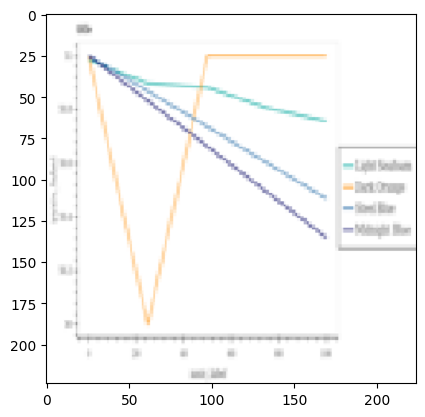

1/1 [==============================] - 0s 18ms/step
Prediction for 5.png: line


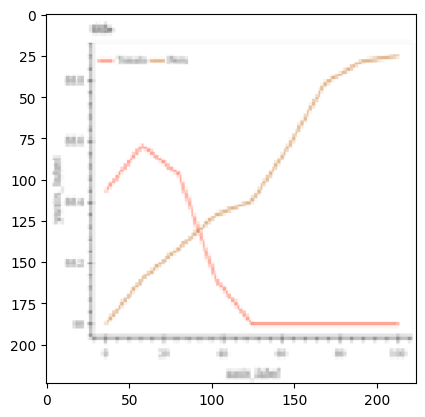

1/1 [==============================] - 0s 18ms/step
Prediction for 33.png: hbar_categorical


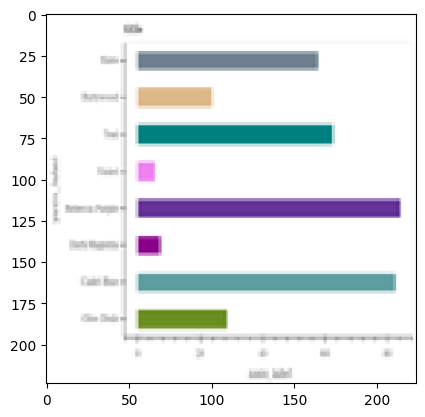

1/1 [==============================] - 0s 21ms/step
Prediction for 38.png: vbar_categorical


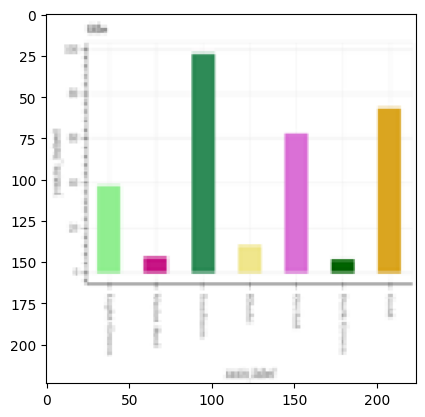

1/1 [==============================] - 0s 20ms/step
Prediction for 40.png: dot_line


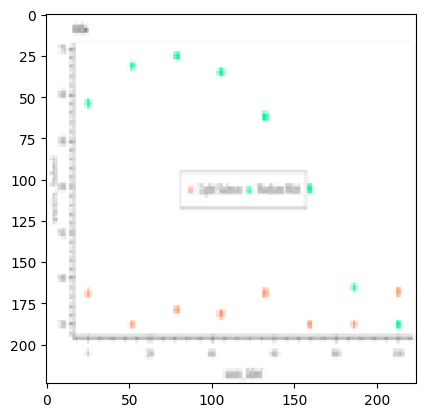

1/1 [==============================] - 0s 19ms/step
Prediction for 48.png: pie


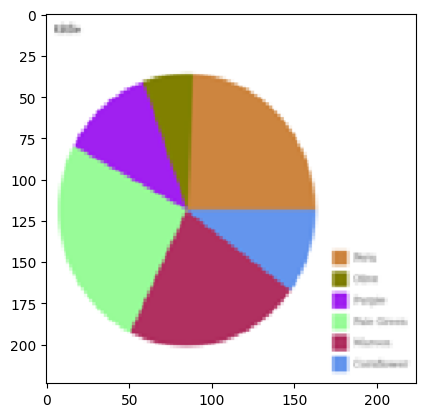

1/1 [==============================] - 0s 22ms/step
Prediction for 9.png: line


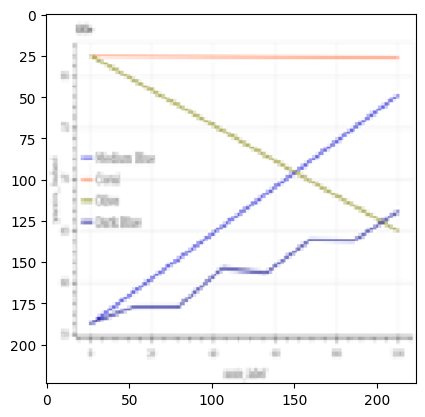

1/1 [==============================] - 0s 19ms/step
Prediction for 41.png: vbar_categorical


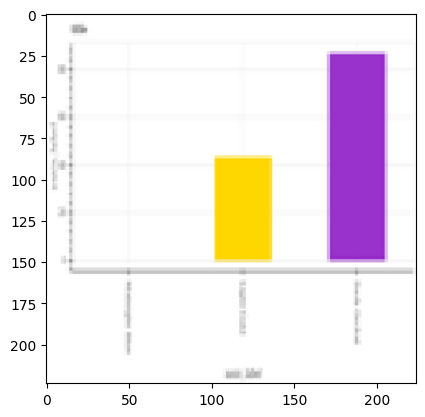

1/1 [==============================] - 0s 19ms/step
Prediction for 8.png: line


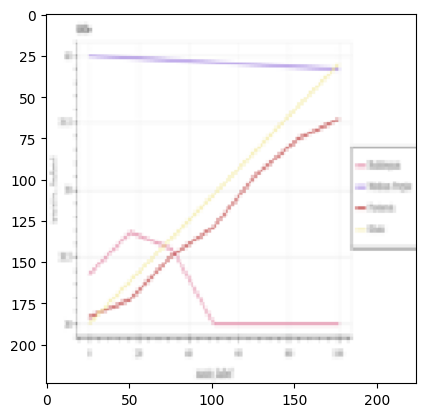

1/1 [==============================] - 0s 19ms/step
Prediction for 6.png: vbar_categorical


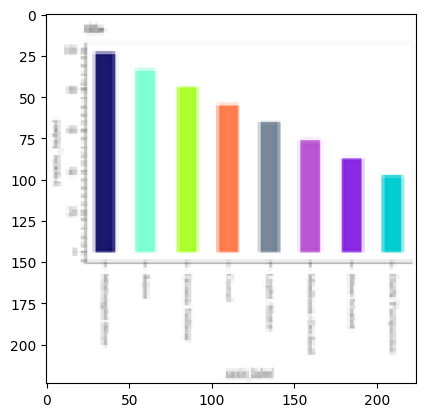

1/1 [==============================] - 0s 32ms/step
Prediction for 39.png: dot_line


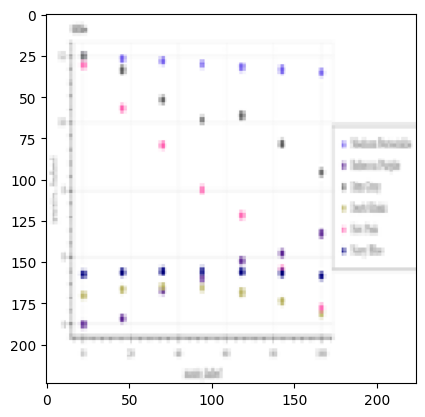

1/1 [==============================] - 0s 20ms/step
Prediction for 49.png: line


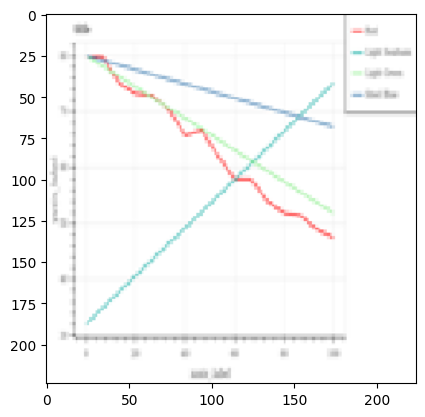

1/1 [==============================] - 0s 18ms/step
Prediction for 47.png: pie


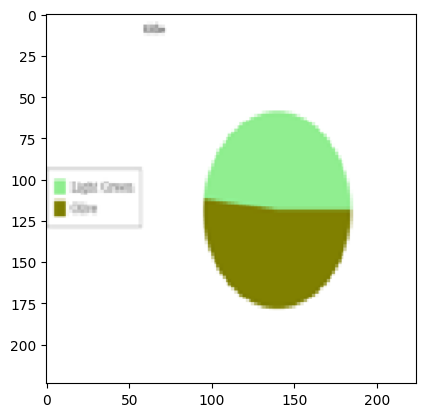

1/1 [==============================] - 0s 20ms/step
Prediction for 37.png: dot_line


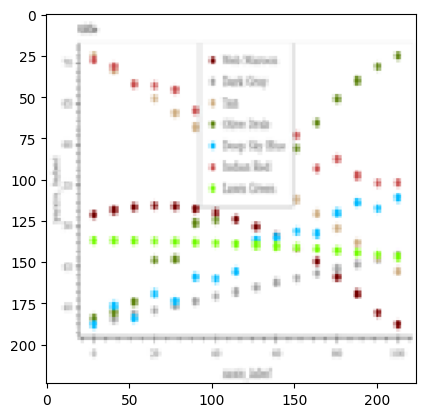

1/1 [==============================] - 0s 19ms/step
Prediction for 46.png: line


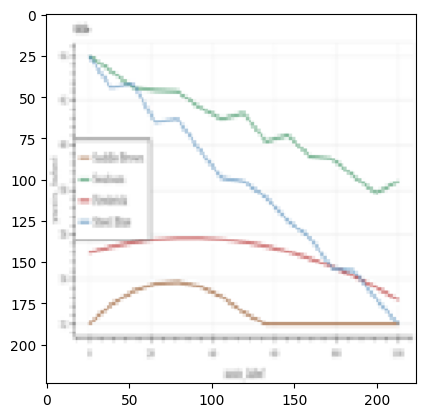

1/1 [==============================] - 0s 20ms/step
Prediction for 43.png: hbar_categorical


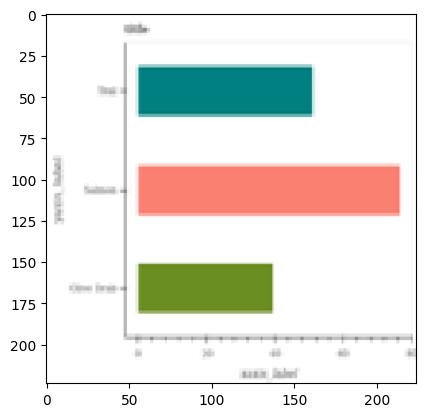

1/1 [==============================] - 0s 20ms/step
Prediction for 36.png: vbar_categorical


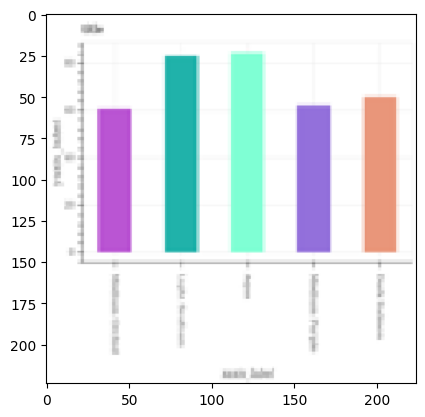

1/1 [==============================] - 0s 19ms/step
Prediction for 7.png: vbar_categorical


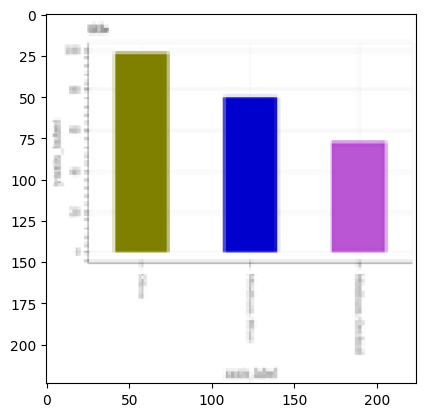

1/1 [==============================] - 0s 19ms/step
Prediction for 42.png: pie


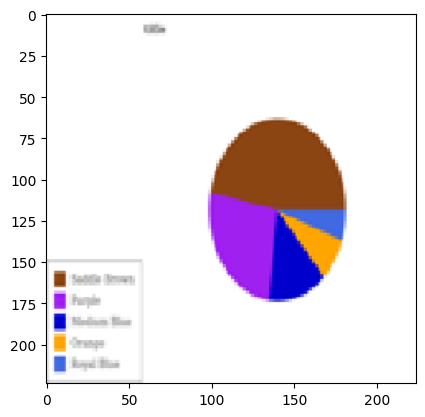

1/1 [==============================] - 0s 18ms/step
Prediction for 21.png: pie


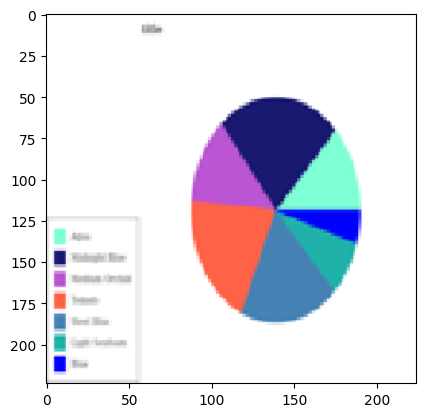

1/1 [==============================] - 0s 21ms/step
Prediction for 19.png: hbar_categorical


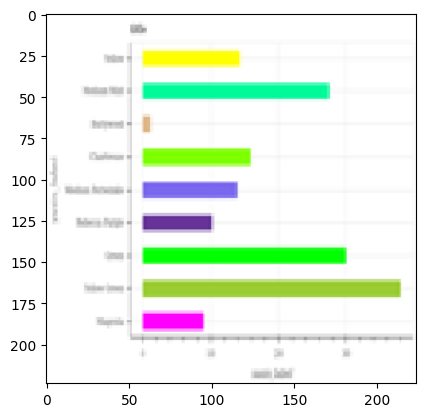

1/1 [==============================] - 0s 18ms/step
Prediction for 34.png: hbar_categorical


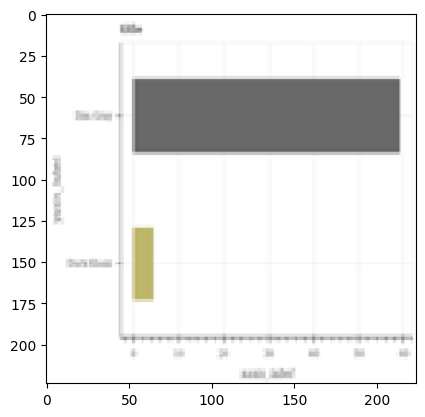

1/1 [==============================] - 0s 19ms/step
Prediction for 23.png: pie


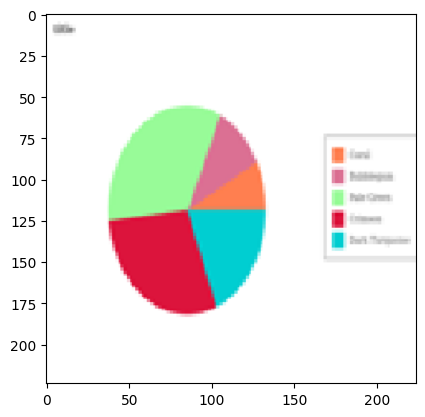

1/1 [==============================] - 0s 19ms/step
Prediction for 24.png: vbar_categorical


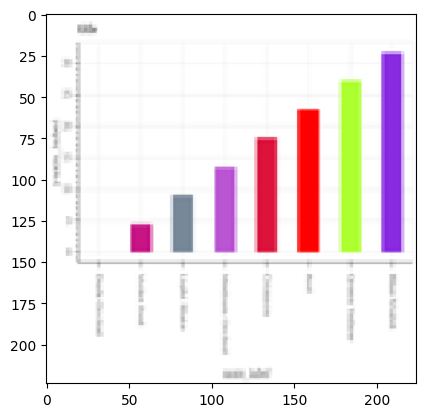

1/1 [==============================] - 0s 21ms/step
Prediction for 16.png: hbar_categorical


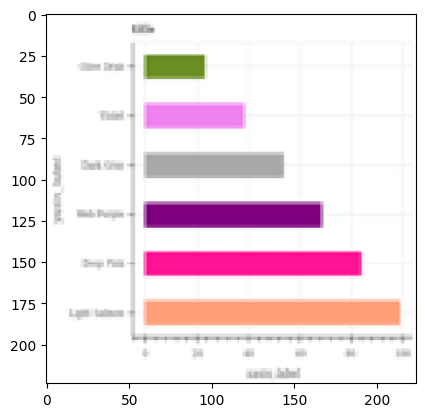

1/1 [==============================] - 0s 18ms/step
Prediction for 29.png: pie


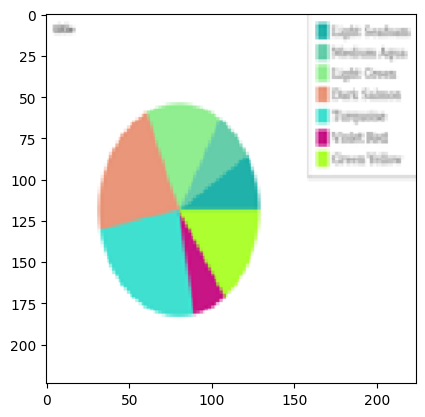

1/1 [==============================] - 0s 20ms/step
Prediction for 1.png: hbar_categorical


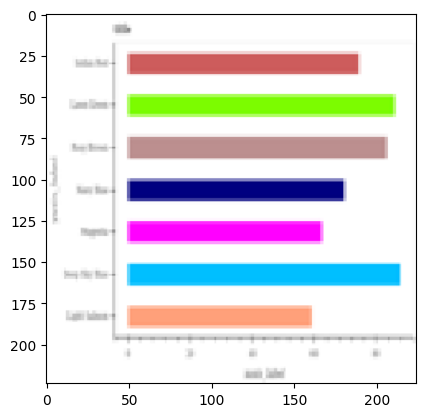

1/1 [==============================] - 0s 19ms/step
Prediction for 18.png: dot_line


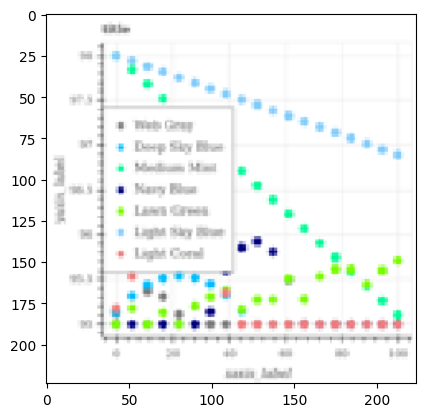

1/1 [==============================] - 0s 18ms/step
Prediction for 14.png: pie


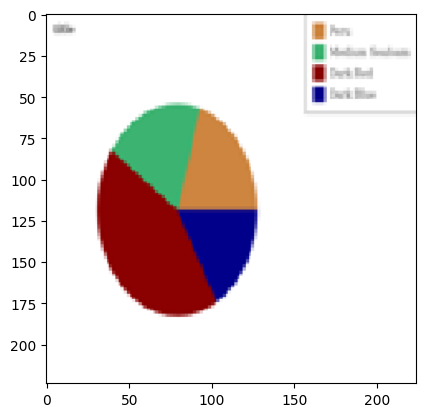

1/1 [==============================] - 0s 18ms/step
Prediction for 3.png: hbar_categorical


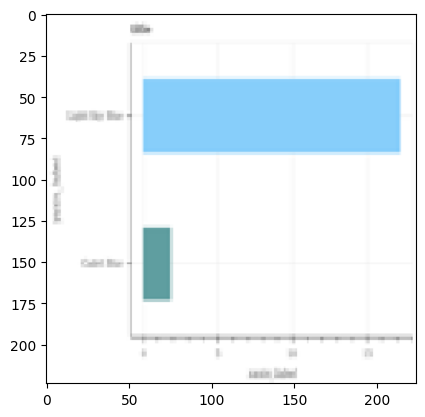

1/1 [==============================] - 0s 21ms/step
Prediction for 32.png: vbar_categorical


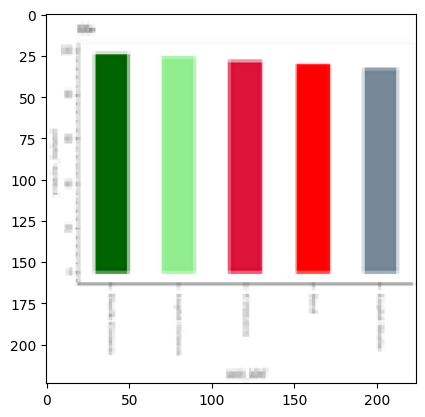

1/1 [==============================] - 0s 22ms/step
Prediction for 11.png: hbar_categorical


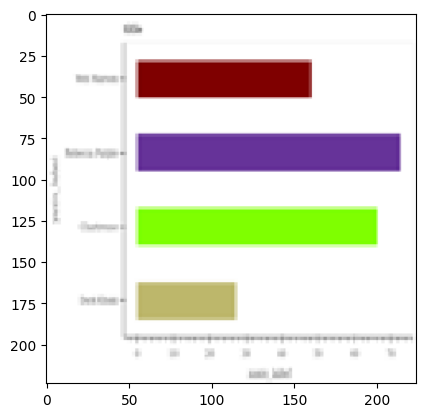

1/1 [==============================] - 0s 20ms/step
Prediction for 2.png: vbar_categorical


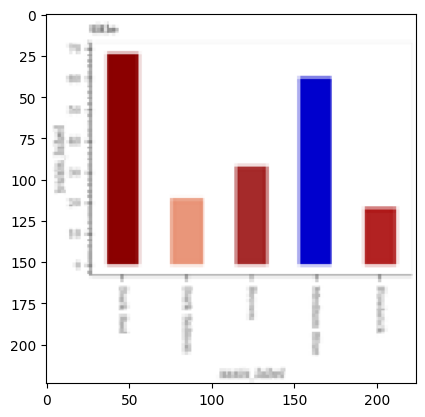

1/1 [==============================] - 0s 21ms/step
Prediction for 35.png: line


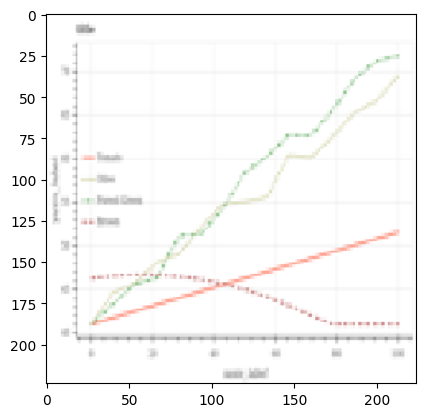

1/1 [==============================] - 0s 21ms/step
Prediction for 26.png: hbar_categorical


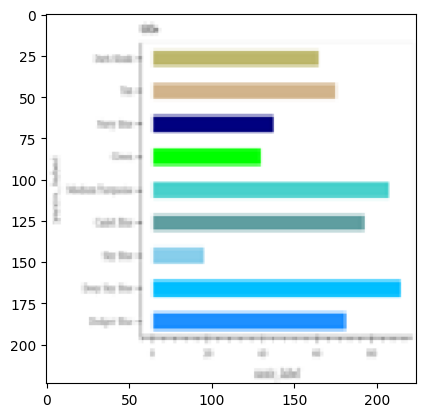

1/1 [==============================] - 0s 20ms/step
Prediction for 15.png: line


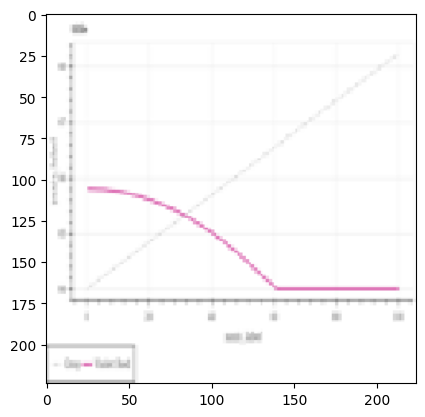

1/1 [==============================] - 0s 22ms/step
Prediction for 44.png: pie


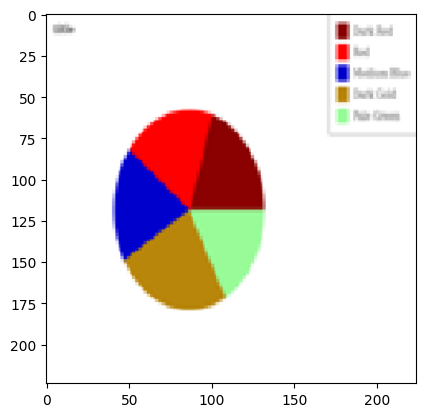

1/1 [==============================] - 0s 28ms/step
Prediction for 30.png: hbar_categorical


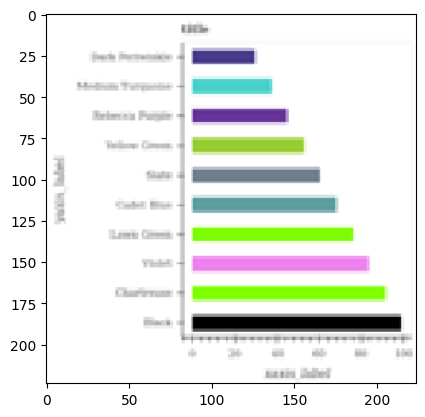

1/1 [==============================] - 0s 36ms/step
Prediction for 28.png: pie


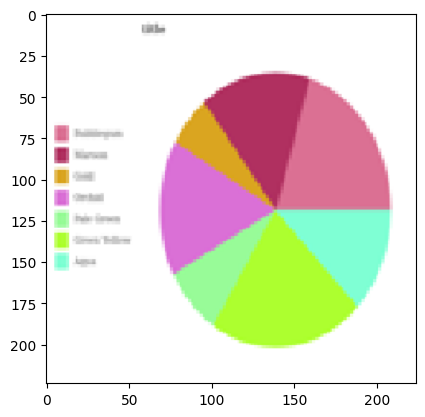

1/1 [==============================] - 0s 33ms/step
Prediction for 17.png: vbar_categorical


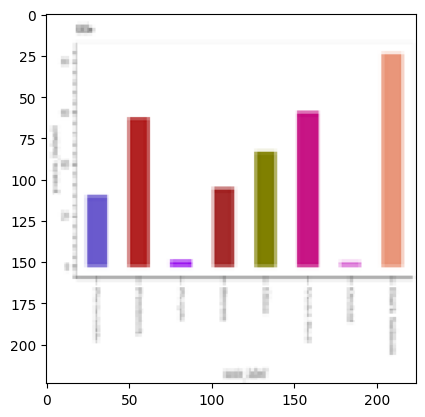

1/1 [==============================] - 0s 35ms/step
Prediction for 45.png: hbar_categorical


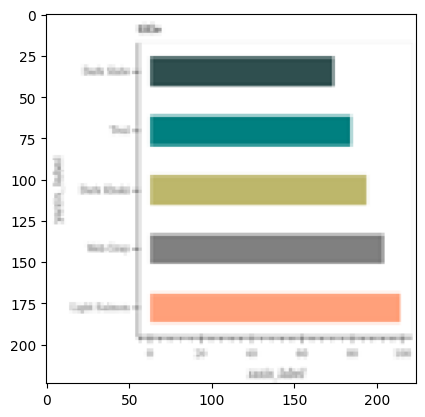

1/1 [==============================] - 0s 29ms/step
Prediction for 27.png: dot_line


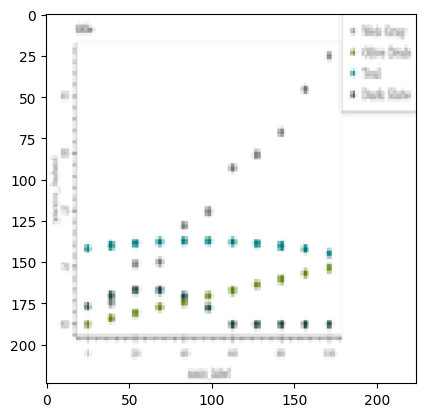

1/1 [==============================] - 0s 168ms/step
Prediction for 31.png: line


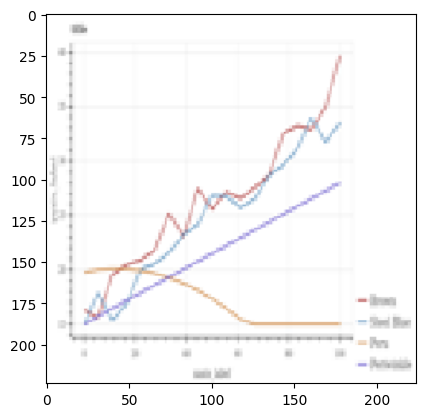

1/1 [==============================] - 0s 33ms/step
Prediction for 20.png: dot_line


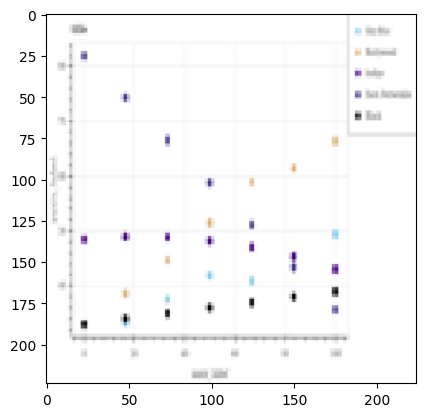

1/1 [==============================] - 0s 28ms/step
Prediction for 25.png: hbar_categorical


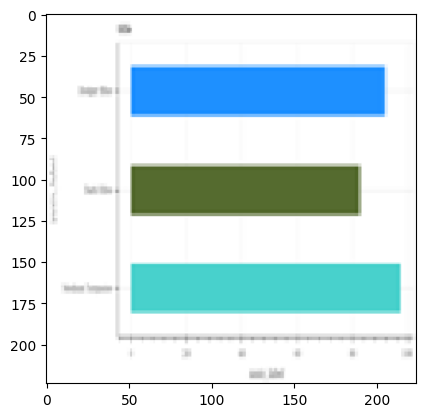

1/1 [==============================] - 0s 39ms/step
Prediction for 0.png: vbar_categorical


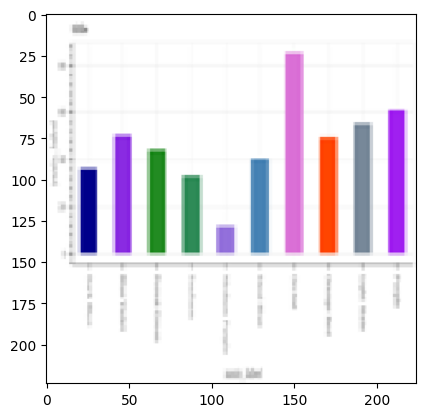

1/1 [==============================] - 0s 21ms/step
Prediction for 12.png: line


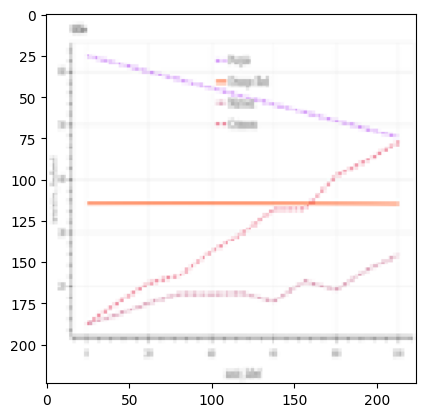

1/1 [==============================] - 0s 20ms/step
Prediction for 10.png: dot_line


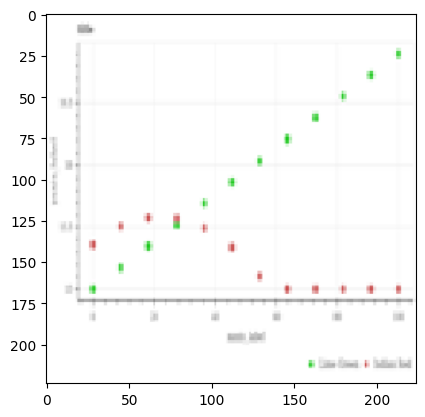

1/1 [==============================] - 0s 23ms/step
Prediction for 22.png: dot_line


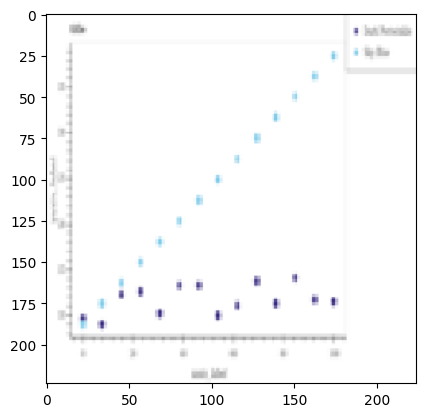

1/1 [==============================] - 0s 24ms/step
Prediction for 13.png: line


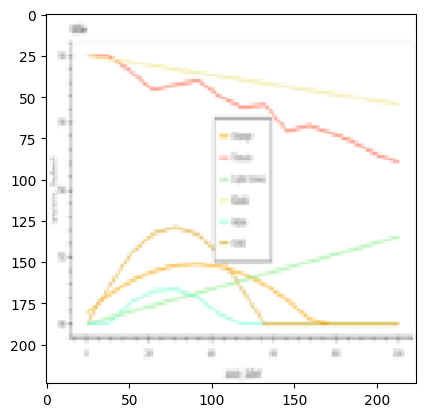

['line', 'line', 'hbar_categorical', 'vbar_categorical', 'dot_line', 'pie', 'line', 'vbar_categorical', 'line', 'vbar_categorical', 'dot_line', 'line', 'pie', 'dot_line', 'line', 'hbar_categorical', 'vbar_categorical', 'vbar_categorical', 'pie', 'pie', 'hbar_categorical', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'pie', 'hbar_categorical', 'dot_line', 'pie', 'hbar_categorical', 'vbar_categorical', 'hbar_categorical', 'vbar_categorical', 'line', 'hbar_categorical', 'line', 'pie', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'dot_line', 'line', 'dot_line', 'hbar_categorical', 'vbar_categorical', 'line', 'dot_line', 'dot_line', 'line']


In [38]:
# Evaluate the model on the validation set
val_loss, val_acc = model.evaluate(val_data)
print('Validation Accuracy:', val_acc)
test_dir = '/content/drive/MyDrive/charts/charts/charts/test'
predict_labels(test_dir, model)

Found 800 images belonging to 5 classes.
Found 200 images belonging to 5 classes.
94765736/94765736 [==============================] - 5s 0us/step
Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/backend.py:5561: UserWarning: "`categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Softmax activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


25/25 [==============================] - 22s 602ms/step - loss: 1.5671 - accuracy: 0.3500 - val_loss: 1.1221 - val_accuracy: 0.4700
Epoch 2/20
25/25 [==============================] - 13s 532ms/step - loss: 1.1712 - accuracy: 0.5175 - val_loss: 0.9705 - val_accuracy: 0.6150
Epoch 3/20
25/25 [==============================] - 12s 478ms/step - loss: 1.0490 - accuracy: 0.5500 - val_loss: 0.8766 - val_accuracy: 0.6700
Epoch 4/20
25/25 [==============================] - 12s 470ms/step - loss: 0.9474 - accuracy: 0.6288 - val_loss: 0.8361 - val_accuracy: 0.7050
Epoch 5/20
25/25 [==============================] - 12s 490ms/step - loss: 0.8932 - accuracy: 0.6388 - val_loss: 0.7297 - val_accuracy: 0.8250
Epoch 6/20
25/25 [==============================] - 12s 476ms/step - loss: 0.8344 - accuracy: 0.6850 - val_loss: 0.7070 - val_accuracy: 0.8100
Epoch 7/20
25/25 [==============================] - 12s 481ms/step - loss: 0.8049 - accuracy: 0.7063 - val_loss: 0.6394 - val_accuracy: 0.9150
Epoch 8/20

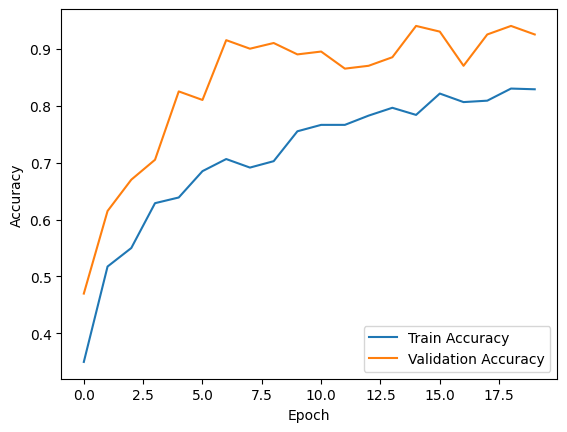

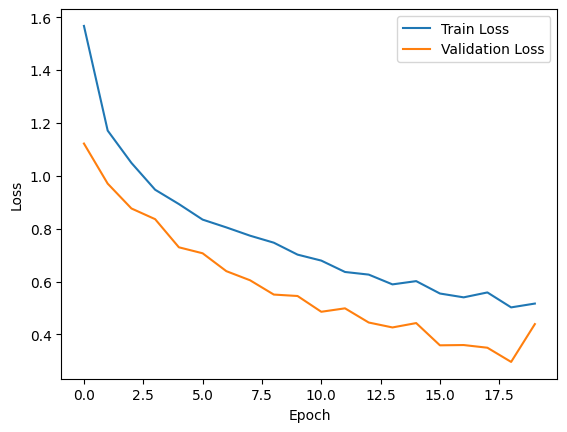

In [39]:
# Define the directories for the train and test data
train_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/train'
test_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/val'

# Define the batch size and number of epochs
batch_size = 32
epochs = 20

# Define the image size
img_size = (224, 224)

# Use the ImageDataGenerator class to load the data
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255
)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

# Define the ResNet50 model
base_model = tf.keras.applications.ResNet50(
    input_shape=img_size + (3,),
    include_top=False,
    weights='imagenet'
)

for layer in base_model.layers:
    layer.trainable = False

x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(512, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
output = tf.keras.layers.Dense(train_generator.num_classes, activation='softmax')(x)

model = tf.keras.models.Model(base_model.input, output)

# Compile the model
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
    metrics=['accuracy']
)

# Fit the model
history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=test_generator
)

# Evaluate the model on the test data
test_loss, test_acc = model.evaluate(test_generator, verbose=2)

# Print the test loss and accuracy
print('Test Loss:', test_loss)
print('Test Accuracy:', test_acc)

# Plot the training and validation loss
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs_range = range(epochs)

# Plot the loss and accuracy curves for train and test data
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


7/7 [==============================] - 1s 96ms/step - loss: 0.4392 - accuracy: 0.9250
Validation Accuracy: 0.925000011920929
1/1 [==============================] - 1s 1s/step
Prediction for 4.png: line


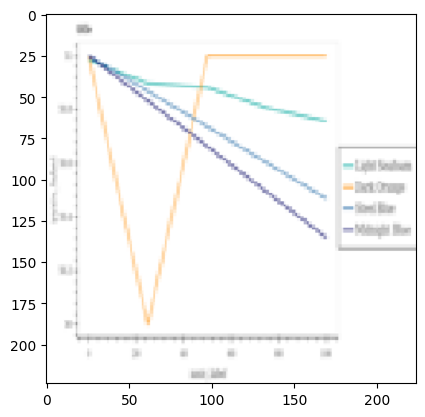

1/1 [==============================] - 0s 24ms/step
Prediction for 5.png: line


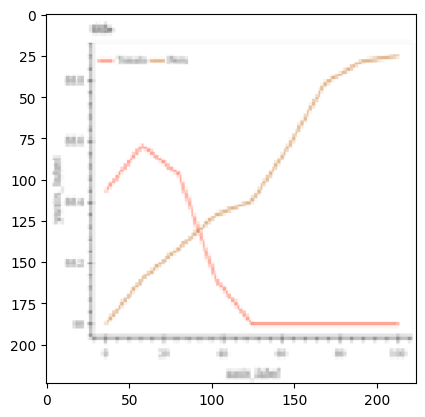

1/1 [==============================] - 0s 23ms/step
Prediction for 33.png: hbar_categorical


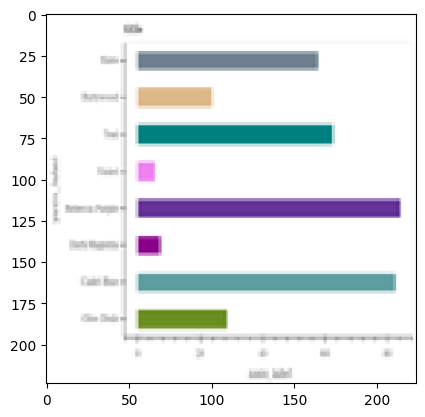

1/1 [==============================] - 0s 25ms/step
Prediction for 38.png: vbar_categorical


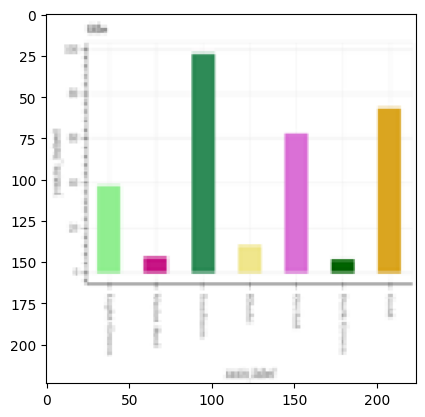

1/1 [==============================] - 0s 22ms/step
Prediction for 40.png: dot_line


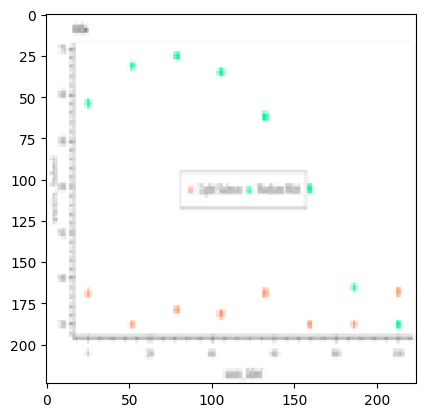

1/1 [==============================] - 0s 30ms/step
Prediction for 48.png: pie


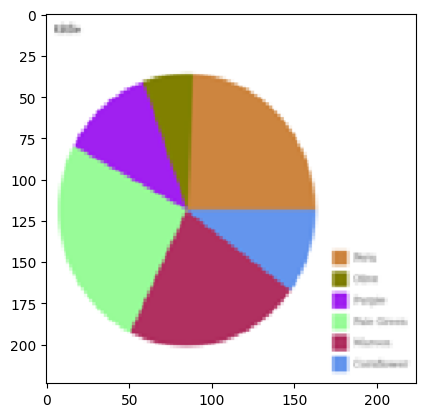

1/1 [==============================] - 0s 35ms/step
Prediction for 9.png: line


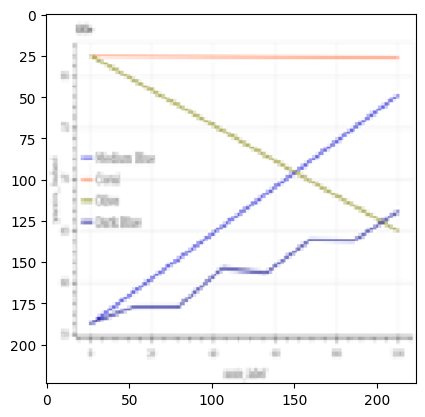

1/1 [==============================] - 0s 36ms/step
Prediction for 41.png: vbar_categorical


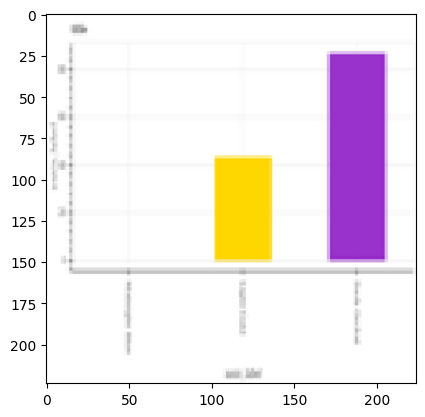

1/1 [==============================] - 0s 40ms/step
Prediction for 8.png: line


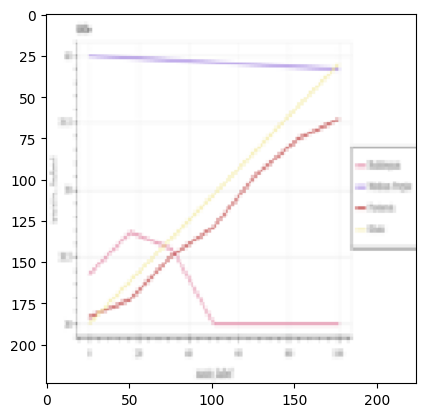

1/1 [==============================] - 0s 32ms/step
Prediction for 6.png: vbar_categorical


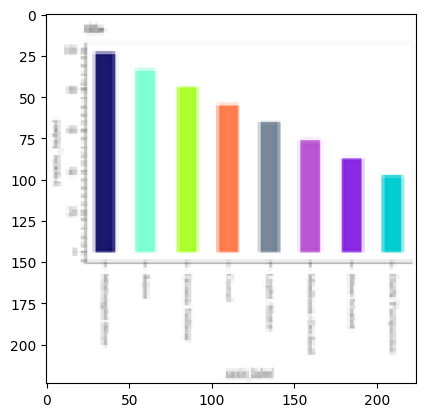

1/1 [==============================] - 0s 32ms/step
Prediction for 39.png: dot_line


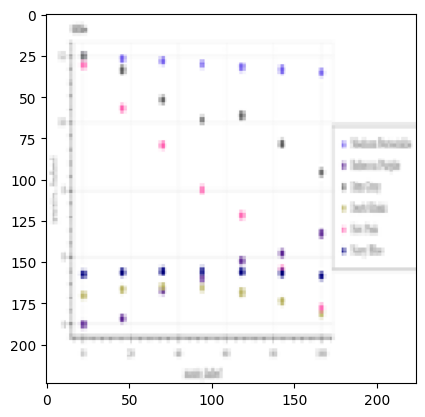

1/1 [==============================] - 0s 31ms/step
Prediction for 49.png: line


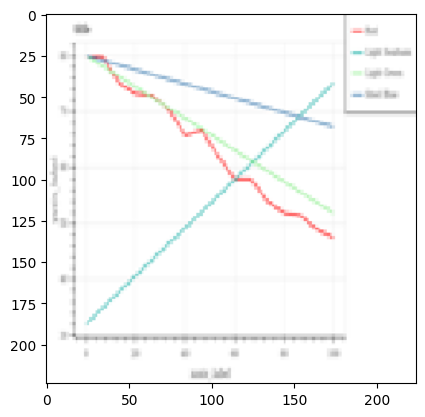

1/1 [==============================] - 0s 33ms/step
Prediction for 47.png: pie


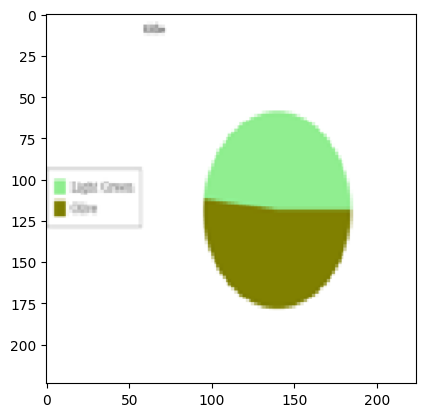

1/1 [==============================] - 0s 31ms/step
Prediction for 37.png: dot_line


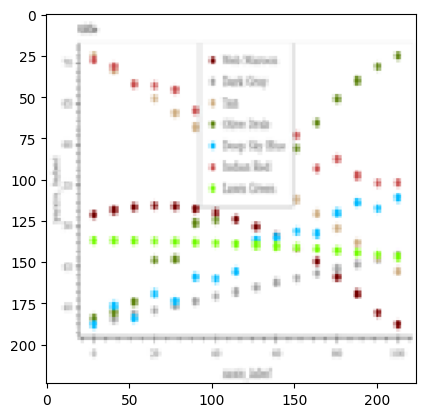

1/1 [==============================] - 0s 32ms/step
Prediction for 46.png: line


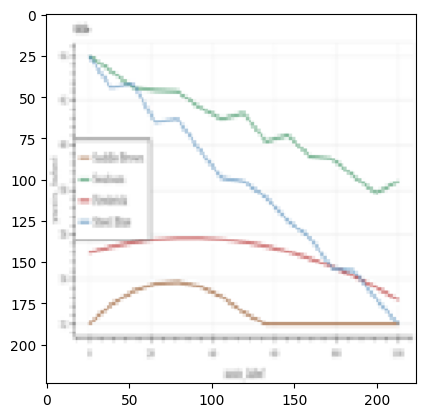

1/1 [==============================] - 0s 35ms/step
Prediction for 43.png: hbar_categorical


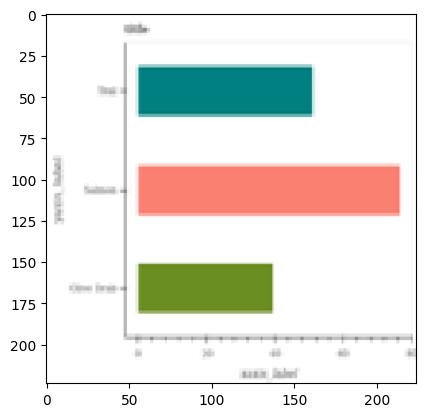

1/1 [==============================] - 0s 23ms/step
Prediction for 36.png: vbar_categorical


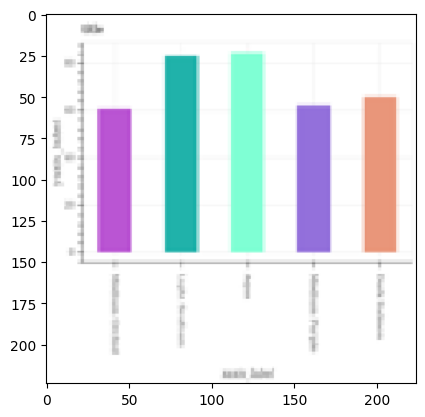

1/1 [==============================] - 0s 22ms/step
Prediction for 7.png: vbar_categorical


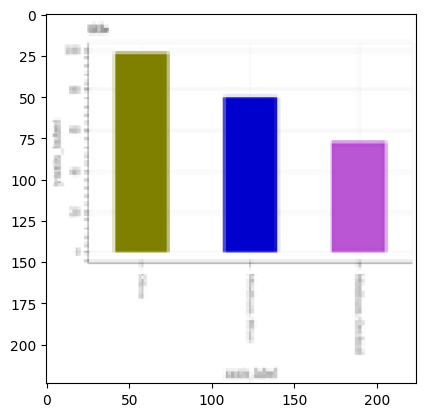

1/1 [==============================] - 0s 22ms/step
Prediction for 42.png: pie


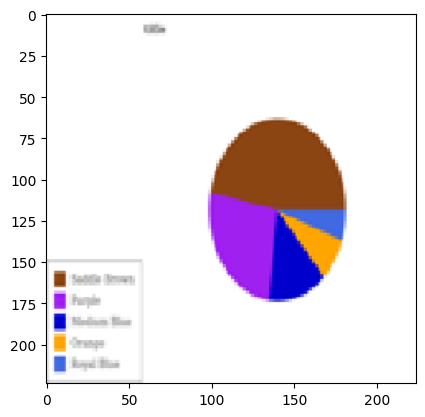

1/1 [==============================] - 0s 21ms/step
Prediction for 21.png: pie


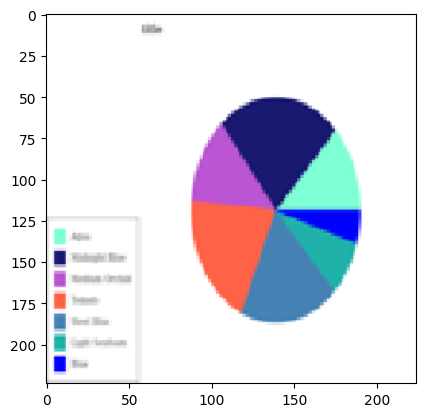

1/1 [==============================] - 0s 22ms/step
Prediction for 19.png: hbar_categorical


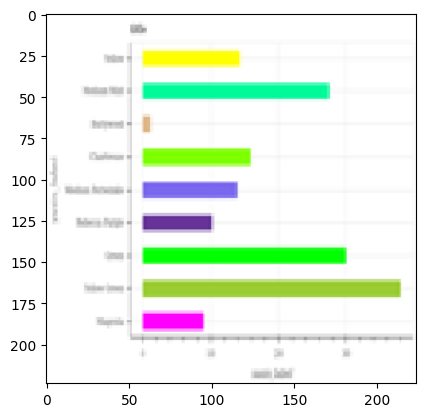

1/1 [==============================] - 0s 21ms/step
Prediction for 34.png: dot_line


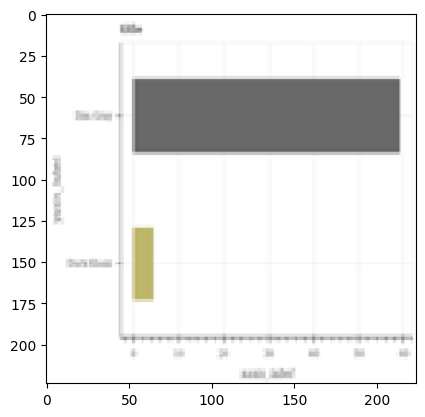

1/1 [==============================] - 0s 27ms/step
Prediction for 23.png: pie


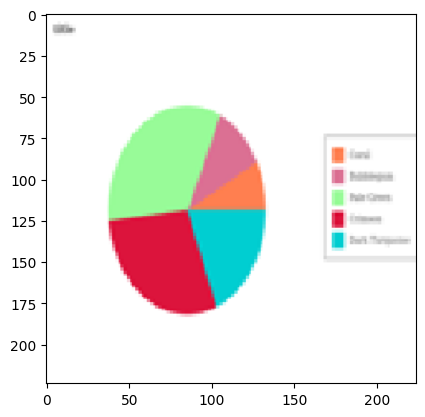

1/1 [==============================] - 0s 21ms/step
Prediction for 24.png: vbar_categorical


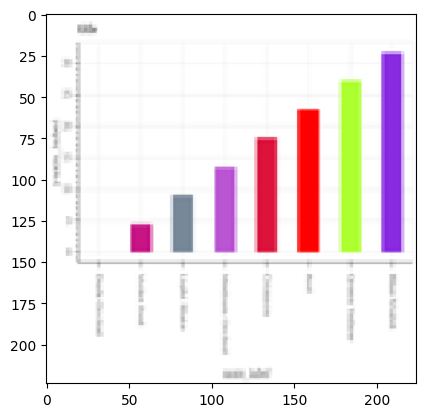

1/1 [==============================] - 0s 22ms/step
Prediction for 16.png: hbar_categorical


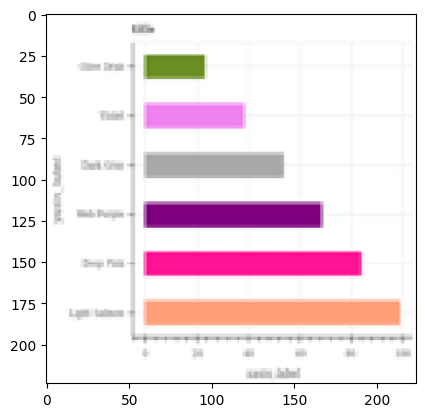

1/1 [==============================] - 0s 21ms/step
Prediction for 29.png: pie


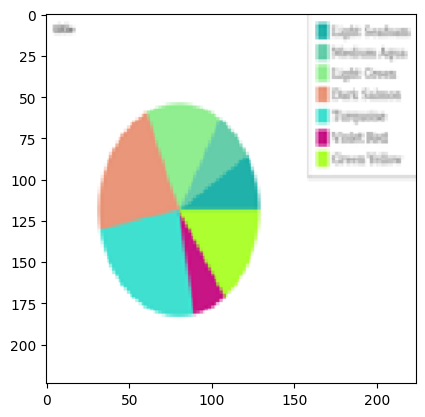

1/1 [==============================] - 0s 22ms/step
Prediction for 1.png: hbar_categorical


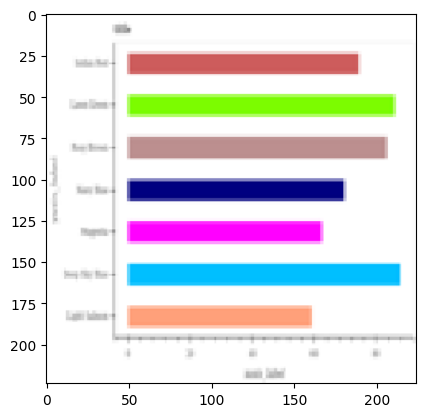

1/1 [==============================] - 0s 22ms/step
Prediction for 18.png: dot_line


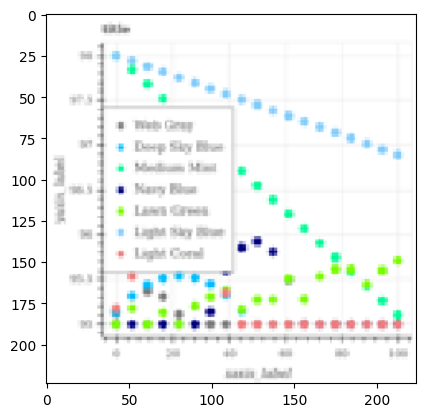

1/1 [==============================] - 0s 22ms/step
Prediction for 14.png: pie


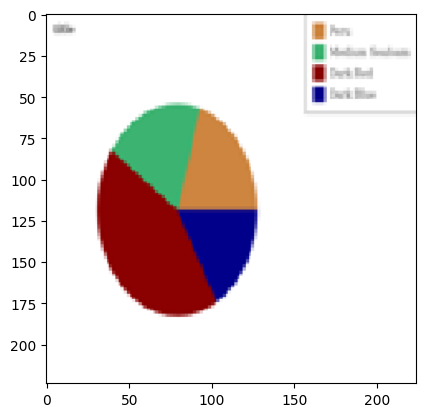

1/1 [==============================] - 0s 24ms/step
Prediction for 3.png: dot_line


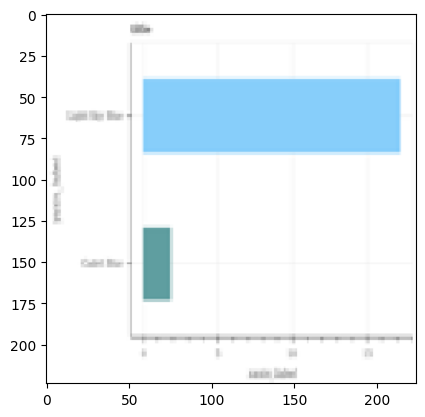

1/1 [==============================] - 0s 22ms/step
Prediction for 32.png: vbar_categorical


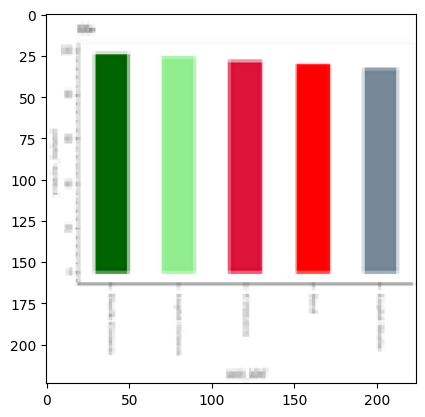

1/1 [==============================] - 0s 23ms/step
Prediction for 11.png: hbar_categorical


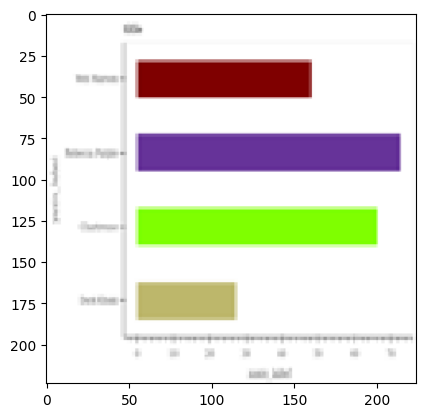

1/1 [==============================] - 0s 23ms/step
Prediction for 2.png: vbar_categorical


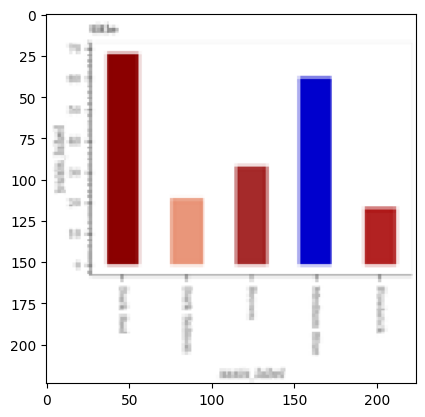

1/1 [==============================] - 0s 21ms/step
Prediction for 35.png: line


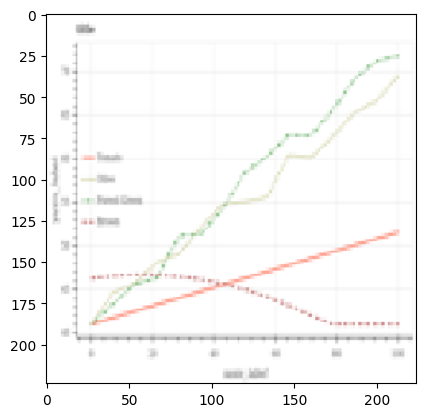

1/1 [==============================] - 0s 22ms/step
Prediction for 26.png: hbar_categorical


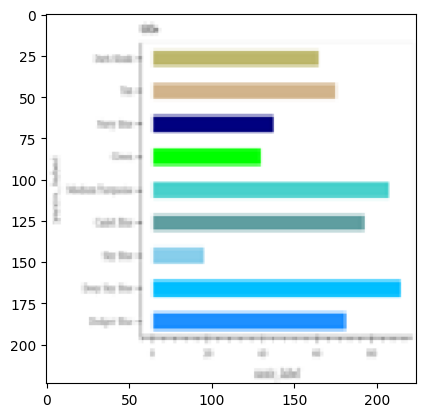

1/1 [==============================] - 0s 22ms/step
Prediction for 15.png: line


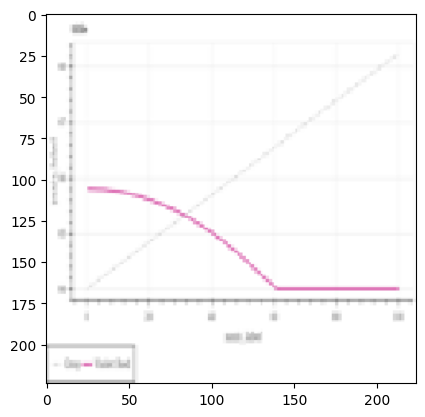

1/1 [==============================] - 0s 27ms/step
Prediction for 44.png: pie


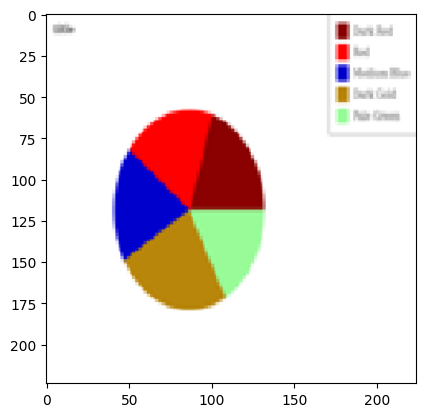

1/1 [==============================] - 0s 30ms/step
Prediction for 30.png: hbar_categorical


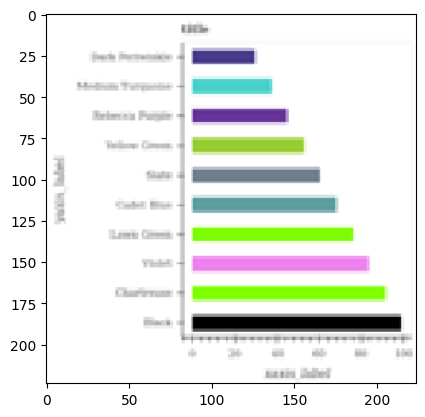

1/1 [==============================] - 0s 21ms/step
Prediction for 28.png: pie


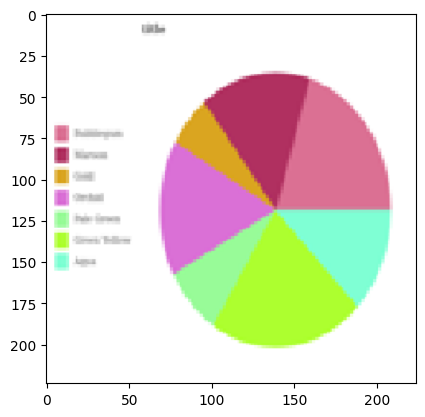

1/1 [==============================] - 0s 22ms/step
Prediction for 17.png: vbar_categorical


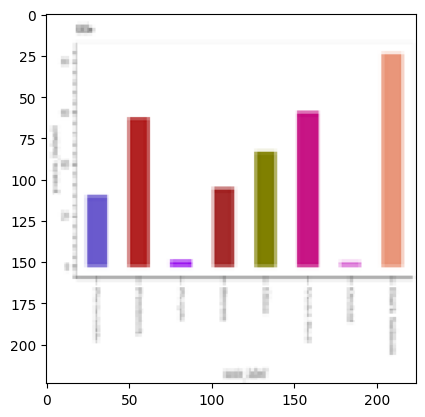

1/1 [==============================] - 0s 23ms/step
Prediction for 45.png: hbar_categorical


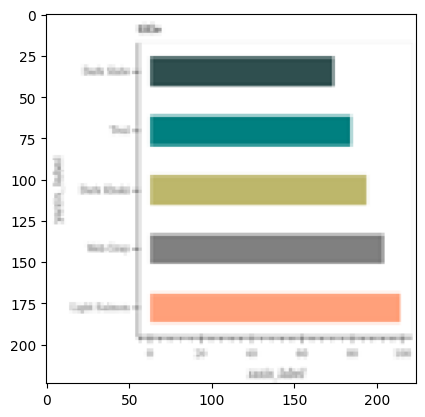

1/1 [==============================] - 0s 27ms/step
Prediction for 27.png: dot_line


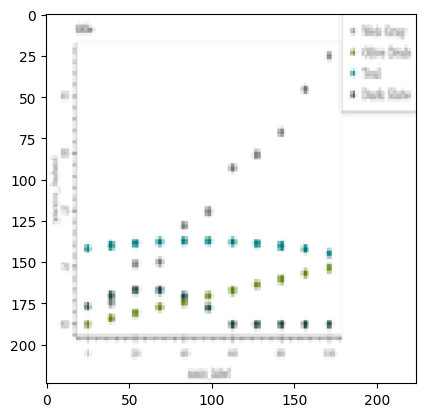

1/1 [==============================] - 0s 23ms/step
Prediction for 31.png: line


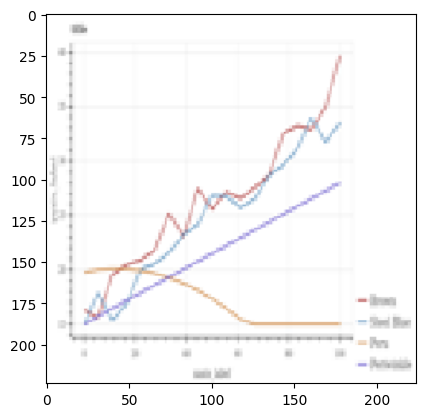

1/1 [==============================] - 0s 23ms/step
Prediction for 20.png: dot_line


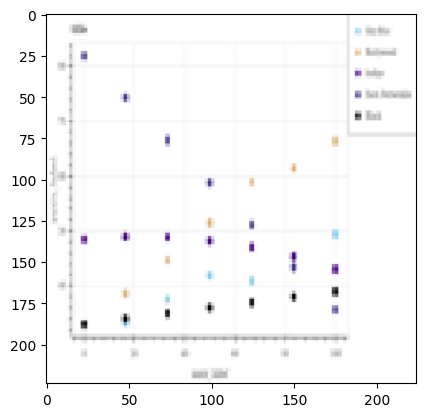

1/1 [==============================] - 0s 22ms/step
Prediction for 25.png: hbar_categorical


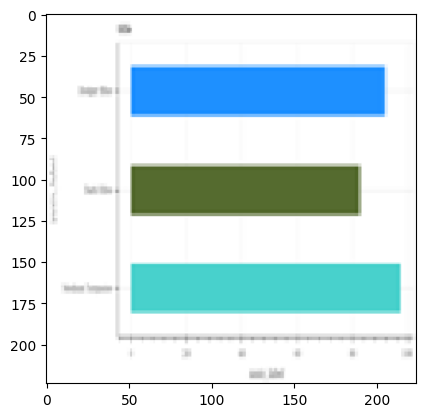

1/1 [==============================] - 0s 22ms/step
Prediction for 0.png: vbar_categorical


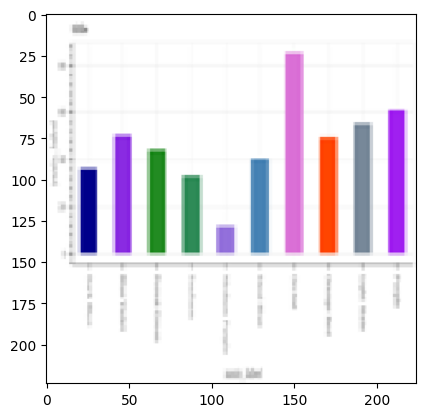

1/1 [==============================] - 0s 21ms/step
Prediction for 12.png: line


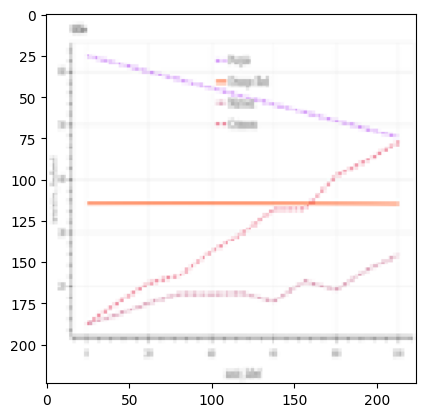

1/1 [==============================] - 0s 22ms/step
Prediction for 10.png: dot_line


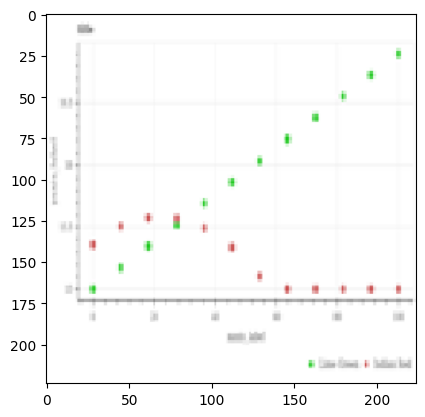

1/1 [==============================] - 0s 29ms/step
Prediction for 22.png: dot_line


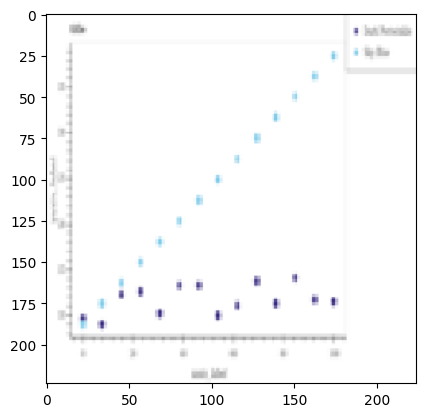

1/1 [==============================] - 0s 22ms/step
Prediction for 13.png: line


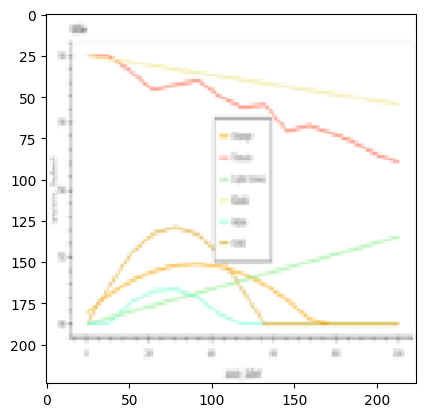

['line', 'line', 'hbar_categorical', 'vbar_categorical', 'dot_line', 'pie', 'line', 'vbar_categorical', 'line', 'vbar_categorical', 'dot_line', 'line', 'pie', 'dot_line', 'line', 'hbar_categorical', 'vbar_categorical', 'vbar_categorical', 'pie', 'pie', 'hbar_categorical', 'dot_line', 'pie', 'vbar_categorical', 'hbar_categorical', 'pie', 'hbar_categorical', 'dot_line', 'pie', 'dot_line', 'vbar_categorical', 'hbar_categorical', 'vbar_categorical', 'line', 'hbar_categorical', 'line', 'pie', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'dot_line', 'line', 'dot_line', 'hbar_categorical', 'vbar_categorical', 'line', 'dot_line', 'dot_line', 'line']


In [40]:
# Evaluate the model on the validation set
val_loss, val_acc = model.evaluate(val_data)
print('Validation Accuracy:', val_acc)
test_dir = '/content/drive/MyDrive/charts/charts/charts/test'
predict_labels(test_dir, model)

Found 800 images belonging to 5 classes.
Found 200 images belonging to 5 classes.
87910968/87910968 [==============================] - 5s 0us/step
Epoch 1/10
25/25 [==============================] - 20s 569ms/step - loss: 0.8049 - accuracy: 0.7113 - val_loss: 0.5186 - val_accuracy: 0.8900
Epoch 2/10
25/25 [==============================] - 11s 434ms/step - loss: 0.1872 - accuracy: 0.9638 - val_loss: 0.2921 - val_accuracy: 0.9500
Epoch 3/10
25/25 [==============================] - 12s 470ms/step - loss: 0.1103 - accuracy: 0.9787 - val_loss: 0.2363 - val_accuracy: 0.9550
Epoch 4/10
25/25 [==============================] - 12s 470ms/step - loss: 0.0836 - accuracy: 0.9887 - val_loss: 0.1970 - val_accuracy: 0.9550
Epoch 5/10
25/25 [==============================] - 12s 470ms/step - loss: 0.0715 - accuracy: 0.9862 - val_loss: 0.1764 - val_accuracy: 0.9550
Epoch 6/10
25/25 [==============================] - 11s 434ms/step - loss: 0.0546 - accuracy: 0.9962 - val_loss: 0.1569 - val_accuracy: 0.

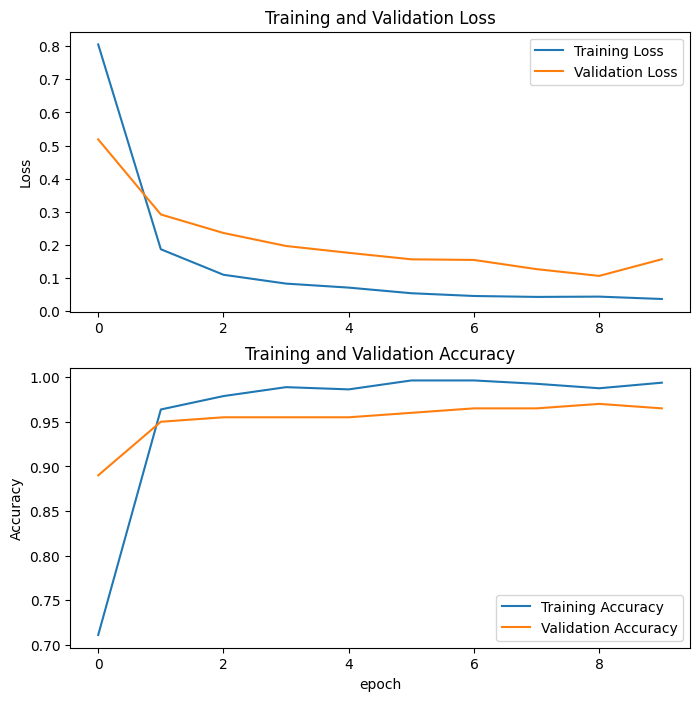

In [41]:
# Set the seed for reproducibility
np.random.seed(42)
tf.random.set_seed(42)

# Define the image size
img_size = (224, 224)

# Define the batch size
batch_size = 32

# Define the train and test data directories
train_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/train'
test_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/val'

# Define the data augmentation parameters for the train data
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Define the data augmentation parameters for the test data
test_datagen = ImageDataGenerator(rescale=1./255)

# Define the train and test data generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=True
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Define the GoogleNet model
base_model = tf.keras.applications.InceptionV3(
    input_shape=img_size + (3,),
    include_top=False,
    weights='imagenet'
)

# Freeze the base model layers
base_model.trainable = False

# Add the classification layers on top of the base model
model = tf.keras.models.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(5, activation='softmax')
])

# Compile the model
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# Train the model
history = model.fit(
    train_generator,
    epochs=10,
    validation_data=test_generator
)

# Evaluate the model on the test data
loss, accuracy = model.evaluate(test_generator)
print("Test Loss: {:.3f}\nTest Accuracy: {:.3f}".format(loss, accuracy))

# Plot the loss and accuracy curves for the training and validation data
train_loss = history.history['loss']
val_loss = history.history['val_loss']
train_acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')

plt.subplot(2, 1, 2)
plt.plot(train_acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('epoch')
plt.show()


7/7 [==============================] - 1s 85ms/step - loss: 0.1571 - accuracy: 0.9650
Validation Accuracy: 0.9649999737739563
1/1 [==============================] - 2s 2s/step
Prediction for 4.png: line


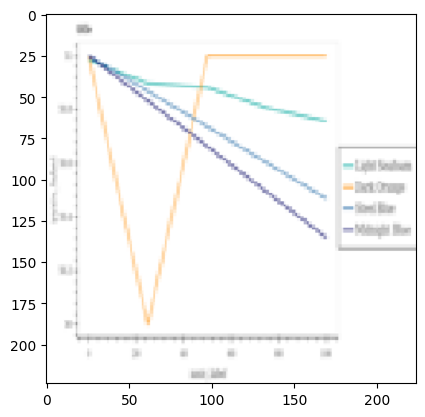

1/1 [==============================] - 0s 27ms/step
Prediction for 5.png: line


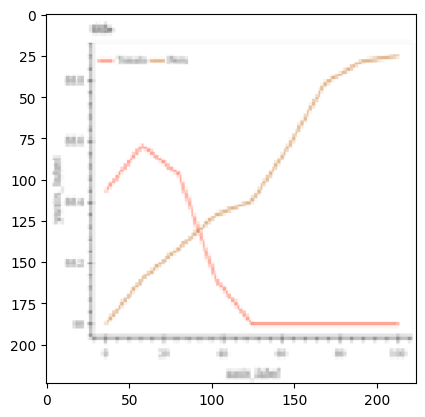

1/1 [==============================] - 0s 28ms/step
Prediction for 33.png: hbar_categorical


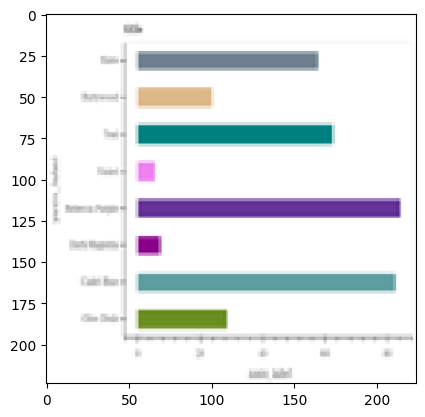

1/1 [==============================] - 0s 26ms/step
Prediction for 38.png: vbar_categorical


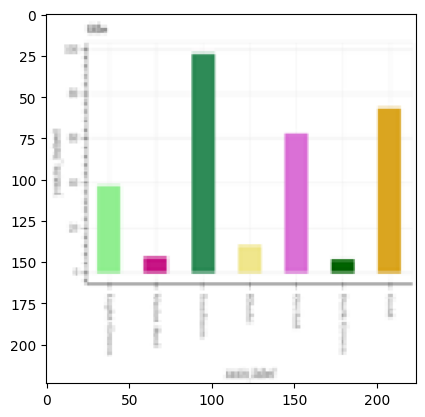

1/1 [==============================] - 0s 25ms/step
Prediction for 40.png: dot_line


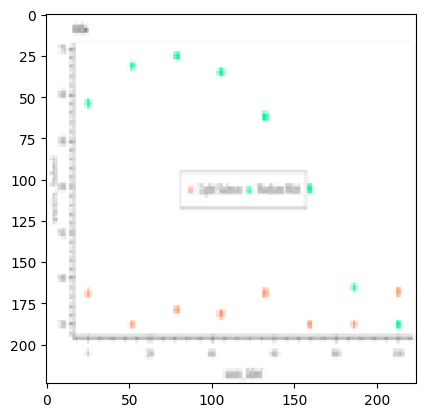

1/1 [==============================] - 0s 26ms/step
Prediction for 48.png: pie


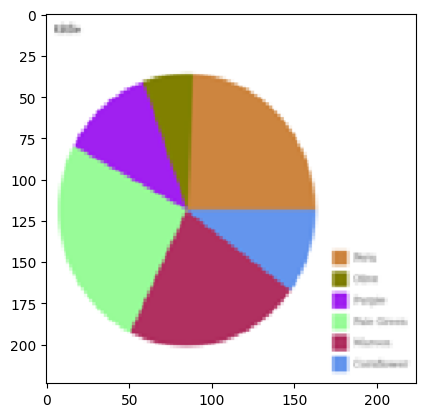

1/1 [==============================] - 0s 26ms/step
Prediction for 9.png: line


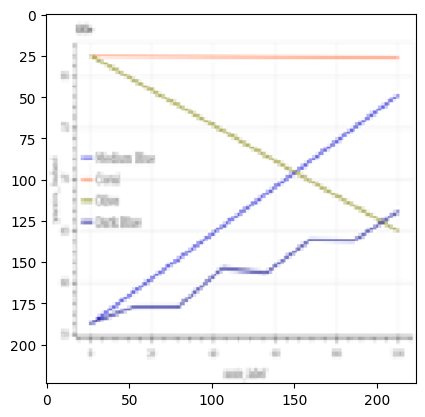

1/1 [==============================] - 0s 26ms/step
Prediction for 41.png: vbar_categorical


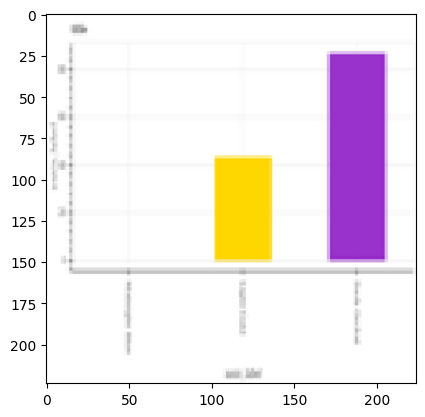

1/1 [==============================] - 0s 27ms/step
Prediction for 8.png: line


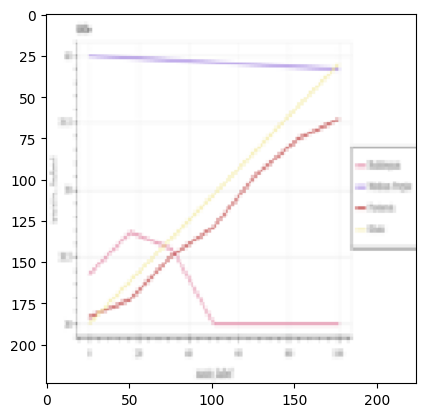

1/1 [==============================] - 0s 32ms/step
Prediction for 6.png: vbar_categorical


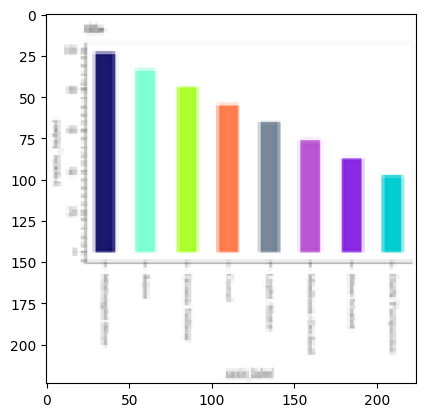

1/1 [==============================] - 0s 35ms/step
Prediction for 39.png: dot_line


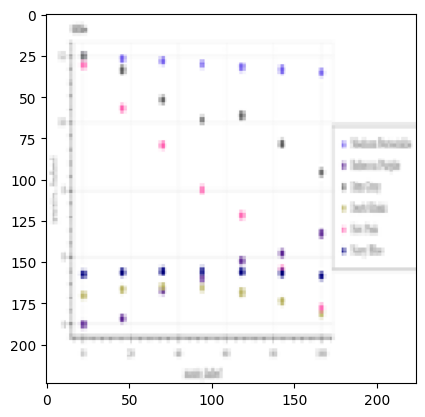

1/1 [==============================] - 0s 50ms/step
Prediction for 49.png: line


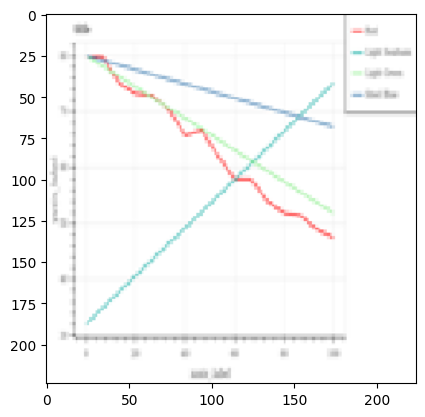

1/1 [==============================] - 0s 37ms/step
Prediction for 47.png: pie


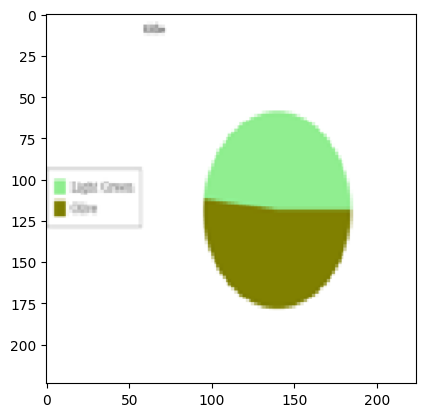

1/1 [==============================] - 0s 38ms/step
Prediction for 37.png: dot_line


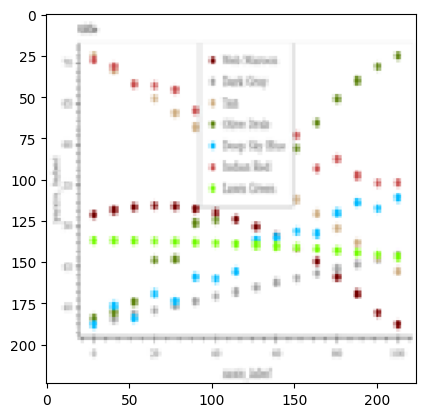

1/1 [==============================] - 0s 37ms/step
Prediction for 46.png: line


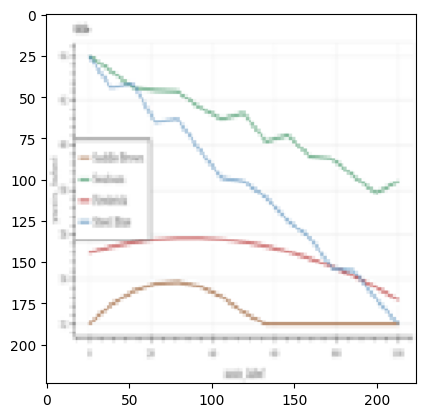

1/1 [==============================] - 0s 37ms/step
Prediction for 43.png: hbar_categorical


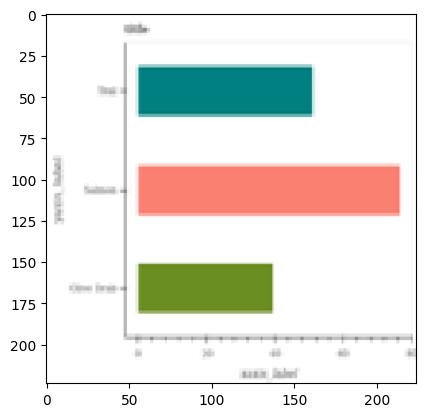

1/1 [==============================] - 0s 39ms/step
Prediction for 36.png: vbar_categorical


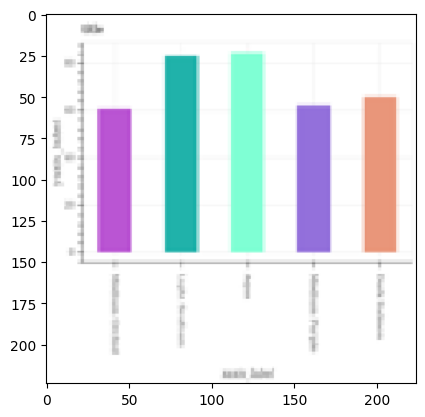

1/1 [==============================] - 0s 37ms/step
Prediction for 7.png: vbar_categorical


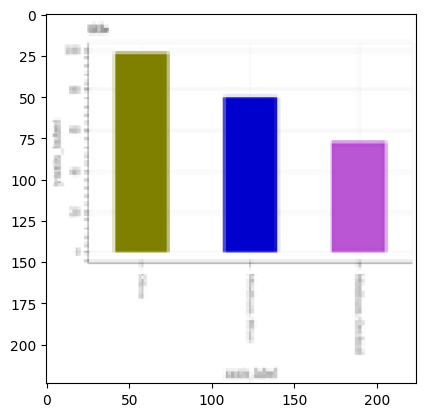

1/1 [==============================] - 0s 36ms/step
Prediction for 42.png: pie


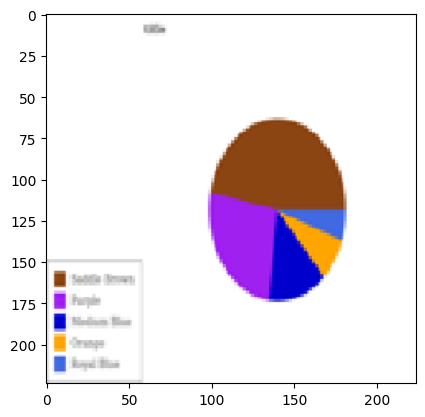

1/1 [==============================] - 0s 39ms/step
Prediction for 21.png: pie


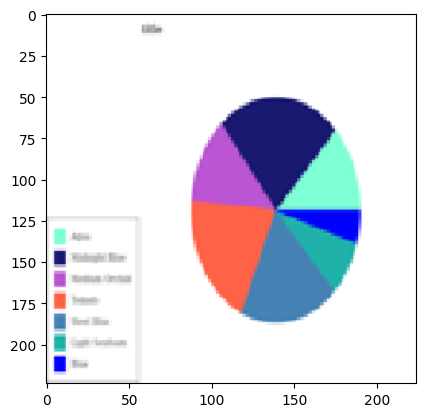

1/1 [==============================] - 0s 37ms/step
Prediction for 19.png: hbar_categorical


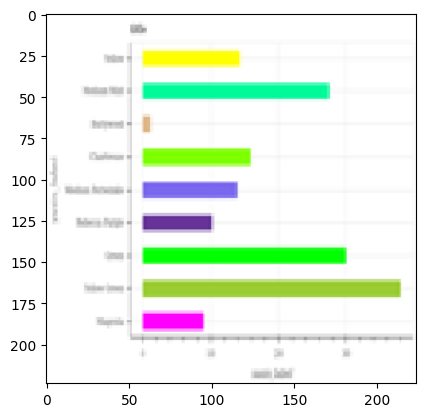

1/1 [==============================] - 0s 25ms/step
Prediction for 34.png: hbar_categorical


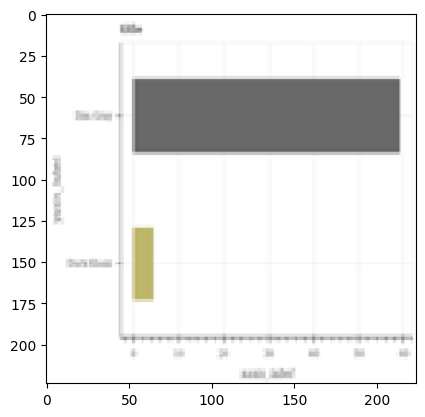

1/1 [==============================] - 0s 25ms/step
Prediction for 23.png: pie


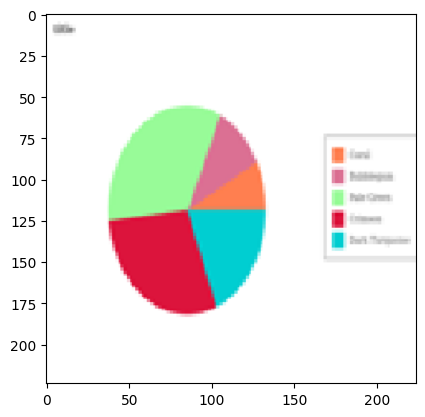

1/1 [==============================] - 0s 25ms/step
Prediction for 24.png: vbar_categorical


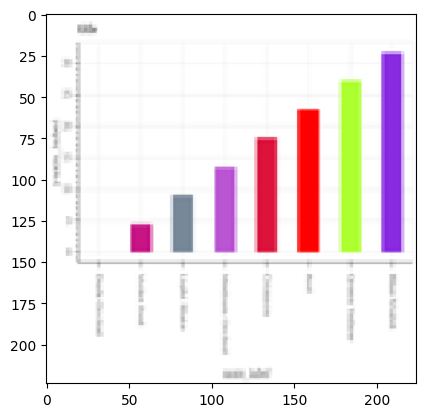

1/1 [==============================] - 0s 25ms/step
Prediction for 16.png: hbar_categorical


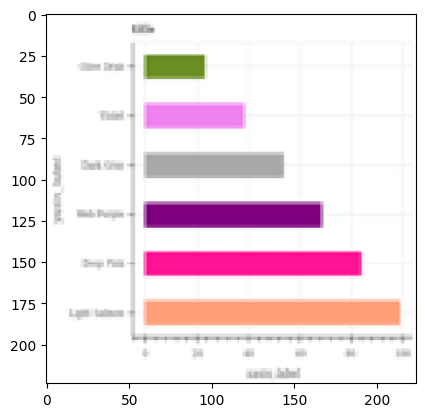

1/1 [==============================] - 0s 25ms/step
Prediction for 29.png: pie


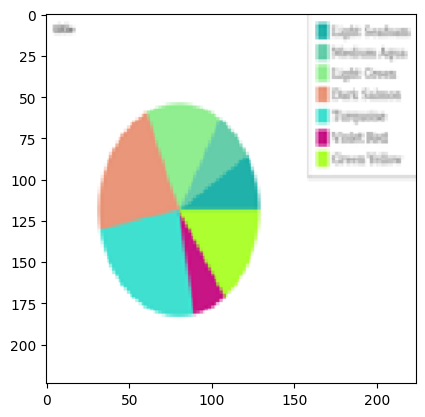

1/1 [==============================] - 0s 34ms/step
Prediction for 1.png: hbar_categorical


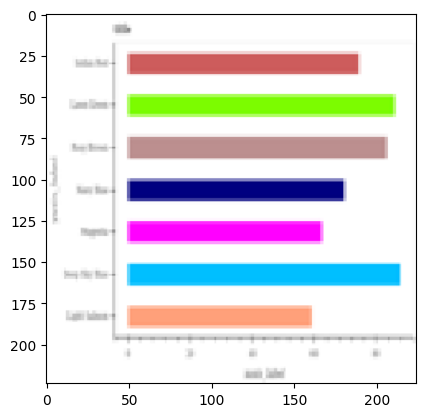

1/1 [==============================] - 0s 26ms/step
Prediction for 18.png: dot_line


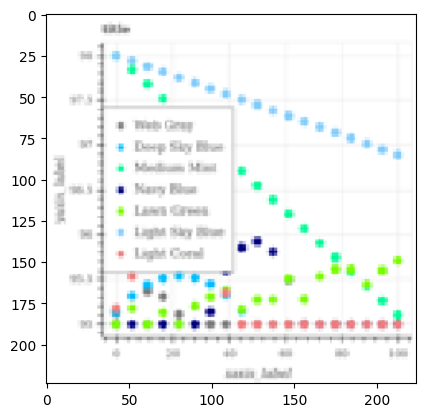

1/1 [==============================] - 0s 25ms/step
Prediction for 14.png: pie


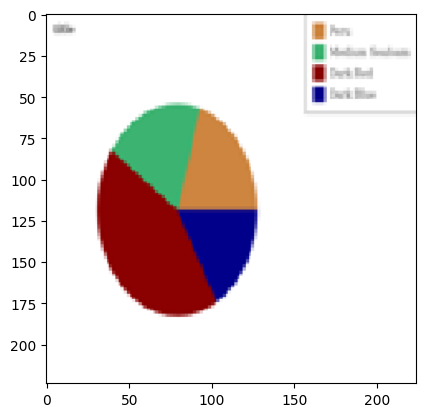

1/1 [==============================] - 0s 26ms/step
Prediction for 3.png: hbar_categorical


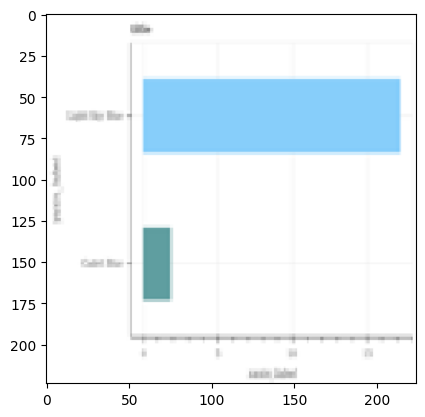

1/1 [==============================] - 0s 24ms/step
Prediction for 32.png: vbar_categorical


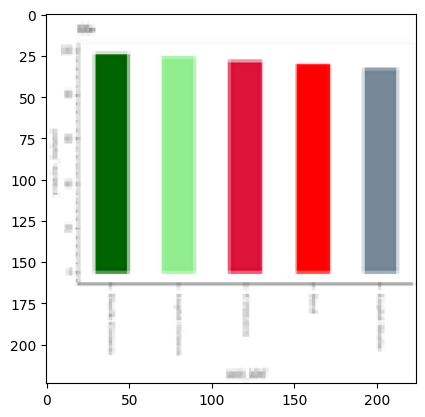

1/1 [==============================] - 0s 25ms/step
Prediction for 11.png: hbar_categorical


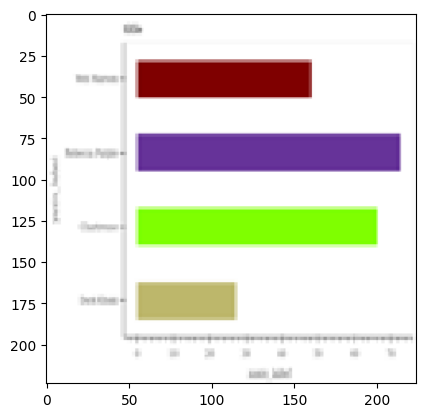

1/1 [==============================] - 0s 26ms/step
Prediction for 2.png: vbar_categorical


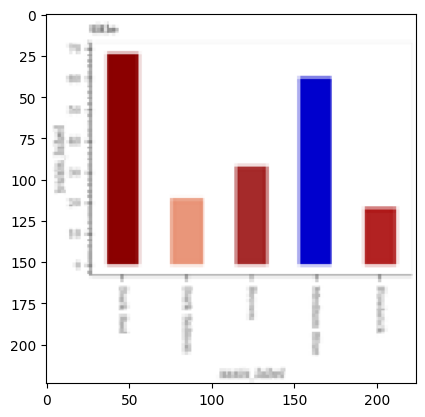

1/1 [==============================] - 0s 26ms/step
Prediction for 35.png: line


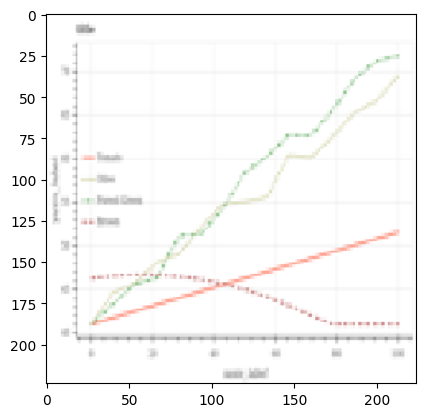

1/1 [==============================] - 0s 30ms/step
Prediction for 26.png: hbar_categorical


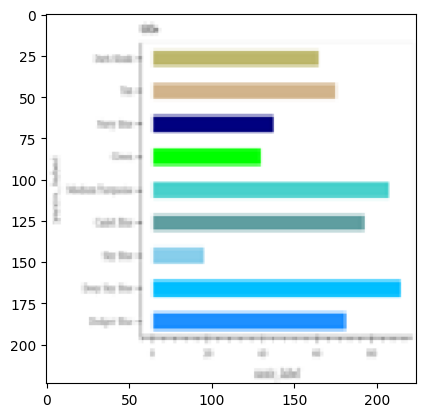

1/1 [==============================] - 0s 25ms/step
Prediction for 15.png: line


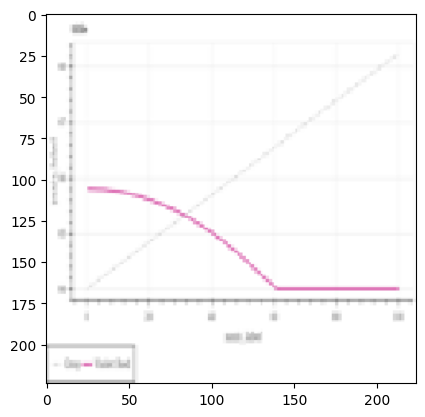

1/1 [==============================] - 0s 26ms/step
Prediction for 44.png: pie


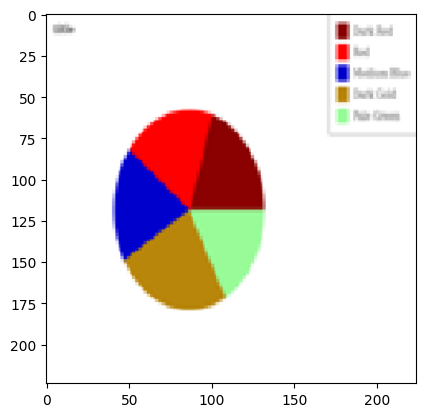

1/1 [==============================] - 0s 26ms/step
Prediction for 30.png: hbar_categorical


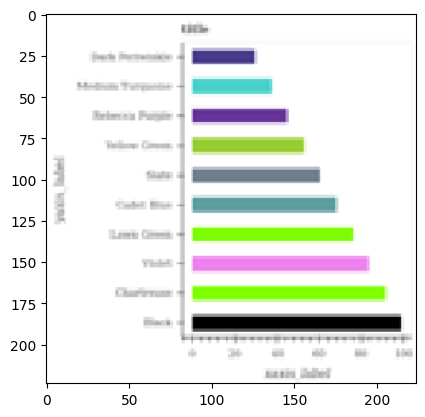

1/1 [==============================] - 0s 29ms/step
Prediction for 28.png: pie


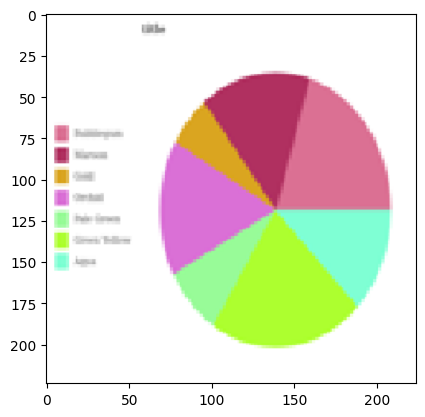

1/1 [==============================] - 0s 26ms/step
Prediction for 17.png: vbar_categorical


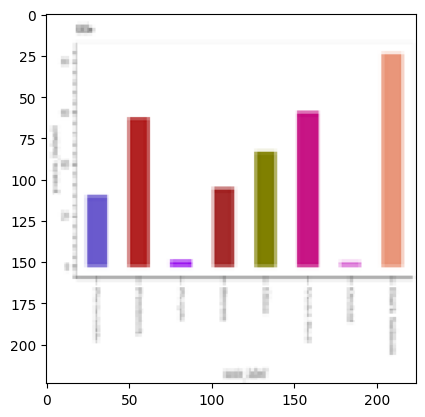

1/1 [==============================] - 0s 36ms/step
Prediction for 45.png: hbar_categorical


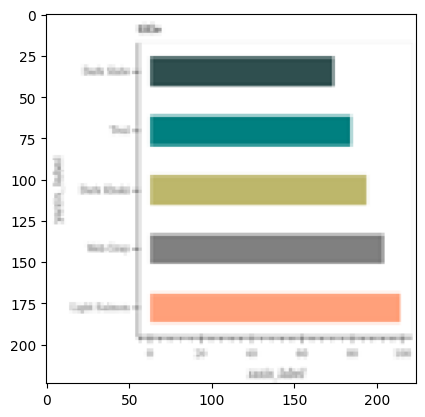

1/1 [==============================] - 0s 28ms/step
Prediction for 27.png: dot_line


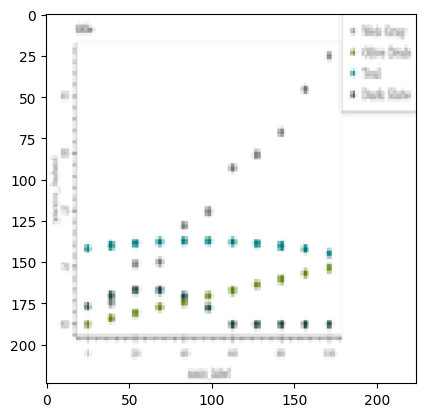

1/1 [==============================] - 0s 29ms/step
Prediction for 31.png: line


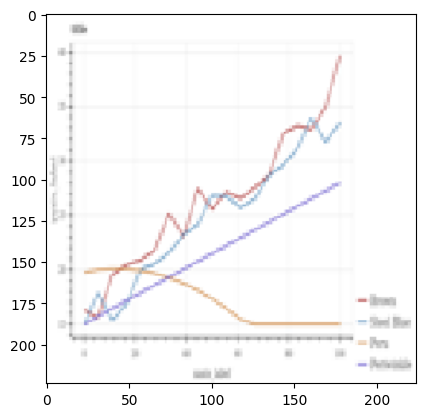

1/1 [==============================] - 0s 27ms/step
Prediction for 20.png: dot_line


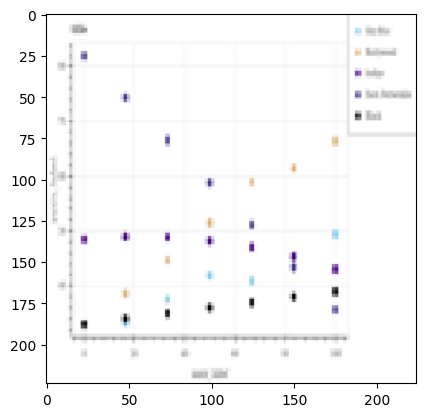

1/1 [==============================] - 0s 27ms/step
Prediction for 25.png: hbar_categorical


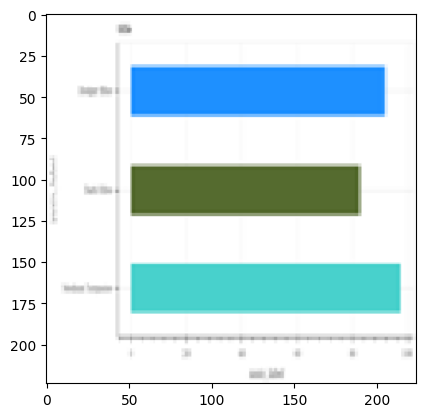

1/1 [==============================] - 0s 26ms/step
Prediction for 0.png: vbar_categorical


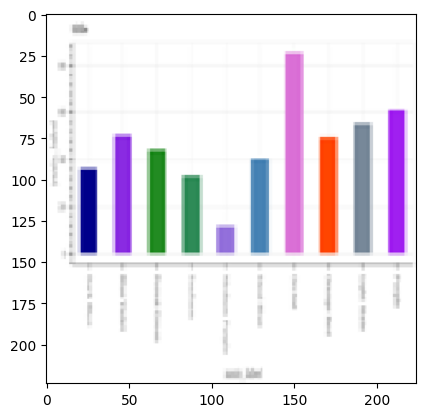

1/1 [==============================] - 0s 25ms/step
Prediction for 12.png: line


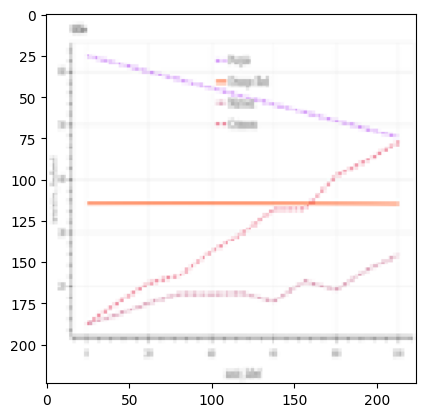

1/1 [==============================] - 0s 28ms/step
Prediction for 10.png: dot_line


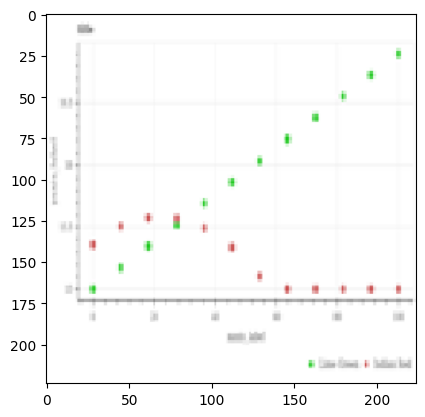

1/1 [==============================] - 0s 26ms/step
Prediction for 22.png: dot_line


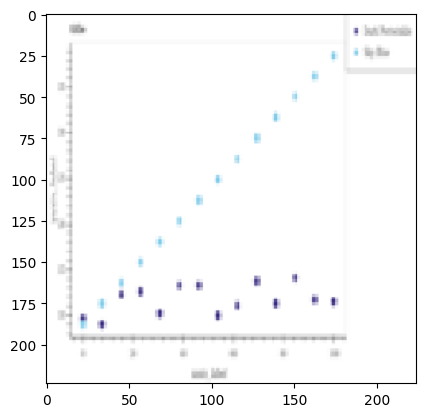

1/1 [==============================] - 0s 25ms/step
Prediction for 13.png: line


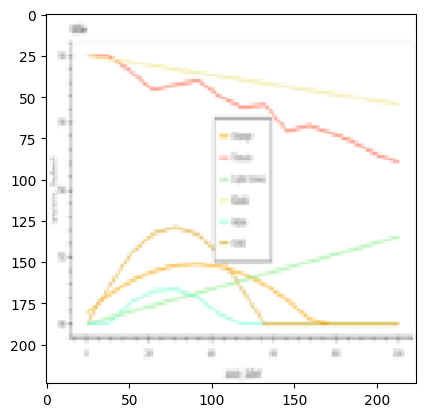

['line', 'line', 'hbar_categorical', 'vbar_categorical', 'dot_line', 'pie', 'line', 'vbar_categorical', 'line', 'vbar_categorical', 'dot_line', 'line', 'pie', 'dot_line', 'line', 'hbar_categorical', 'vbar_categorical', 'vbar_categorical', 'pie', 'pie', 'hbar_categorical', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'pie', 'hbar_categorical', 'dot_line', 'pie', 'hbar_categorical', 'vbar_categorical', 'hbar_categorical', 'vbar_categorical', 'line', 'hbar_categorical', 'line', 'pie', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'dot_line', 'line', 'dot_line', 'hbar_categorical', 'vbar_categorical', 'line', 'dot_line', 'dot_line', 'line']


In [42]:
# Evaluate the model on the validation set
val_loss, val_acc = model.evaluate(val_data)
print('Validation Accuracy:', val_acc)
test_dir = '/content/drive/MyDrive/charts/charts/charts/test'
predict_labels(test_dir, model)

Found 800 images belonging to 5 classes.
Found 200 images belonging to 5 classes.
Epoch 1/10
25/25 [==============================] - 16s 506ms/step - loss: 0.3693 - accuracy: 0.8612 - val_loss: 0.0801 - val_accuracy: 0.9850
Epoch 2/10
25/25 [==============================] - 12s 480ms/step - loss: 0.0744 - accuracy: 0.9762 - val_loss: 0.0403 - val_accuracy: 0.9900
Epoch 3/10
25/25 [==============================] - 12s 484ms/step - loss: 0.0389 - accuracy: 0.9825 - val_loss: 0.0349 - val_accuracy: 0.9900
Epoch 4/10
25/25 [==============================] - 12s 486ms/step - loss: 0.0175 - accuracy: 0.9950 - val_loss: 0.0307 - val_accuracy: 0.9950
Epoch 5/10
25/25 [==============================] - 12s 485ms/step - loss: 0.0143 - accuracy: 0.9962 - val_loss: 0.0248 - val_accuracy: 0.9950
Epoch 6/10
25/25 [==============================] - 12s 485ms/step - loss: 0.0293 - accuracy: 0.9900 - val_loss: 0.0612 - val_accuracy: 0.9750
Epoch 7/10
25/25 [==============================] - 12s 460m

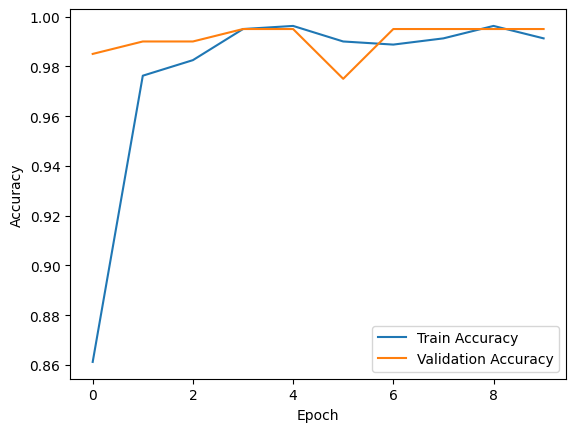

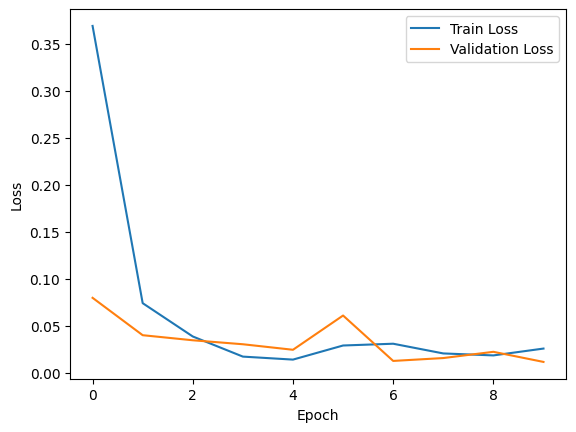

In [46]:
# Define the directories for the train and test data
train_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/train'
test_dir = '/content/drive/MyDrive/charts/charts/charts/train_split/val'

# Define the batch size and number of epochs
batch_size = 32
epochs = 10

# Define the image size
img_size = (224, 224)

# Use the ImageDataGenerator class to load the data
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255
)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

# Define the Xception model
base_model = tf.keras.applications.Xception(
    input_shape=img_size + (3,),
    include_top=False,
    weights='imagenet'
)

for layer in base_model.layers:
    layer.trainable = False

x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(512, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
output = tf.keras.layers.Dense(train_generator.num_classes, activation='softmax')(x)

model = tf.keras.models.Model(base_model.input, output)

# Compile the model
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
    metrics=['accuracy']
)

# Fit the model
history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=test_generator
)

# Evaluate the model on the test data
test_loss, test_acc = model.evaluate(test_generator, verbose=2)

# Print the test loss and accuracy
print('Test Loss:', test_loss)
print('Test Accuracy:', test_acc)

# Plot the training and validation loss
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs_range = range(epochs)

# Plot the loss and accuracy curves for train and test data
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

7/7 [==============================] - 1s 109ms/step - loss: 0.0119 - accuracy: 0.9950
Validation Accuracy: 0.9950000047683716
1/1 [==============================] - 1s 968ms/step
Prediction for 4.png: line


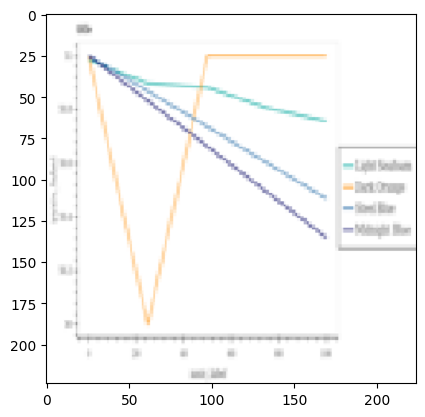

1/1 [==============================] - 0s 22ms/step
Prediction for 5.png: line


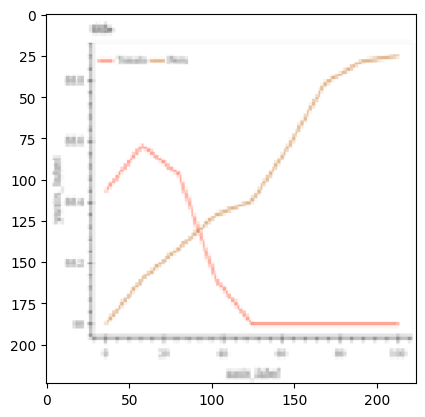

1/1 [==============================] - 0s 21ms/step
Prediction for 33.png: hbar_categorical


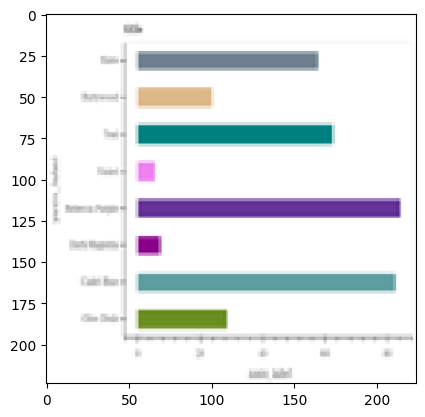

1/1 [==============================] - 0s 24ms/step
Prediction for 38.png: vbar_categorical


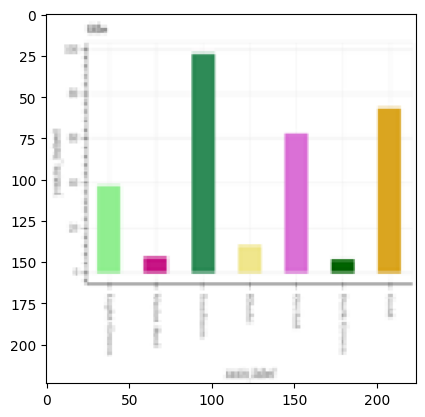

1/1 [==============================] - 0s 22ms/step
Prediction for 40.png: dot_line


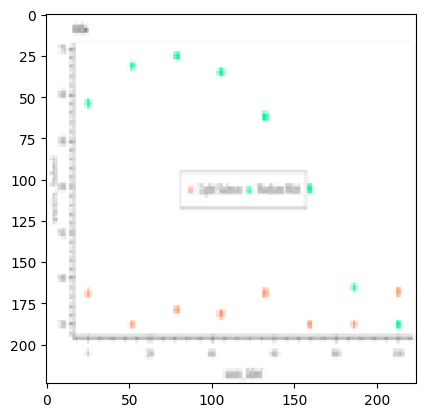

1/1 [==============================] - 0s 21ms/step
Prediction for 48.png: pie


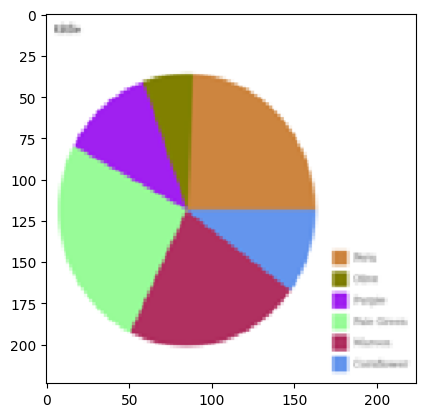

1/1 [==============================] - 0s 21ms/step
Prediction for 9.png: line


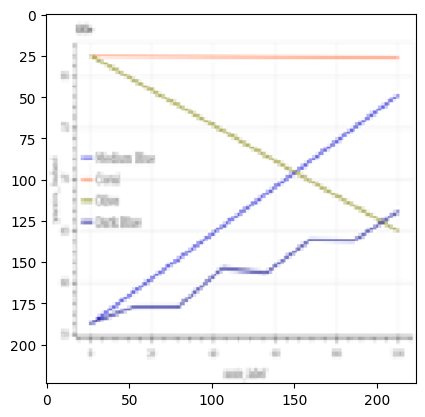

1/1 [==============================] - 0s 21ms/step
Prediction for 41.png: vbar_categorical


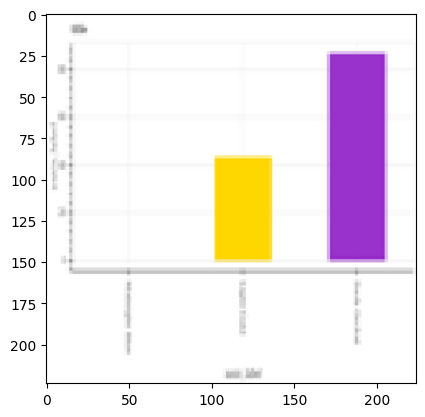

1/1 [==============================] - 0s 23ms/step
Prediction for 8.png: line


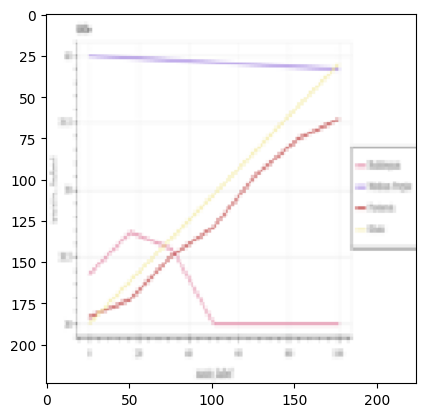

1/1 [==============================] - 0s 21ms/step
Prediction for 6.png: vbar_categorical


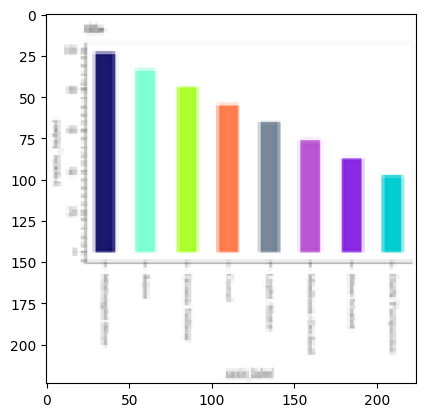

1/1 [==============================] - 0s 35ms/step
Prediction for 39.png: dot_line


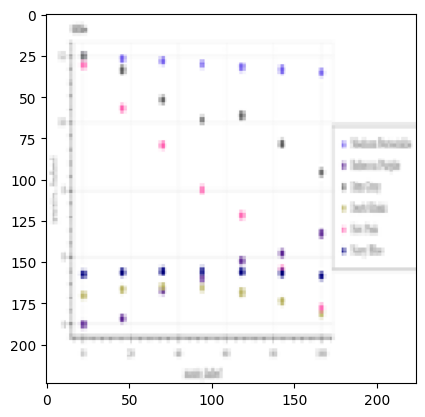

1/1 [==============================] - 0s 36ms/step
Prediction for 49.png: line


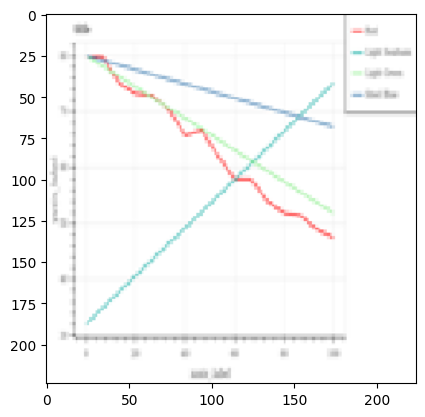

1/1 [==============================] - 0s 32ms/step
Prediction for 47.png: pie


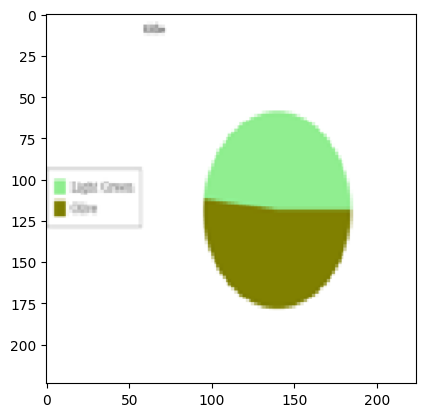

1/1 [==============================] - 0s 33ms/step
Prediction for 37.png: dot_line


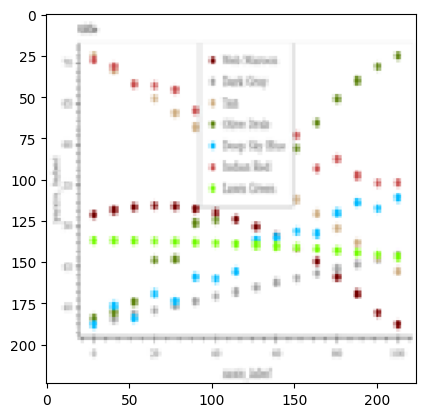

1/1 [==============================] - 0s 43ms/step
Prediction for 46.png: line


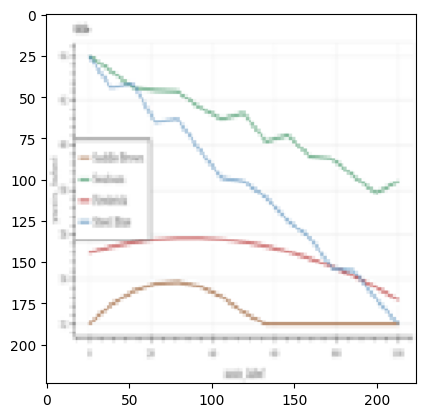

1/1 [==============================] - 0s 35ms/step
Prediction for 43.png: hbar_categorical


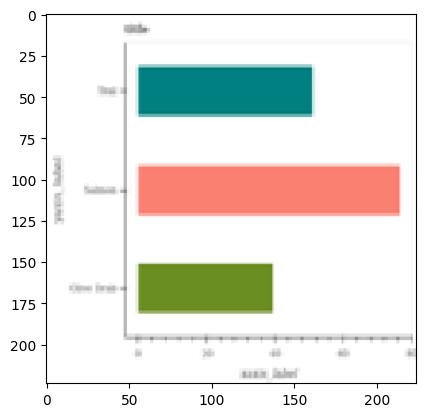

1/1 [==============================] - 0s 30ms/step
Prediction for 36.png: vbar_categorical


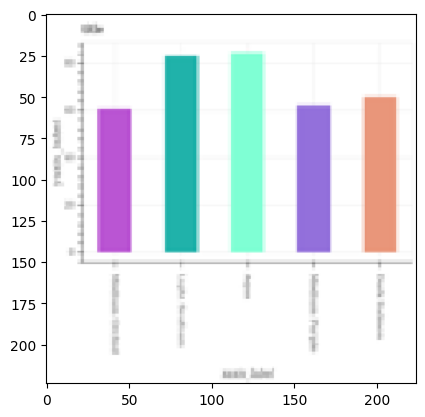

1/1 [==============================] - 0s 38ms/step
Prediction for 7.png: vbar_categorical


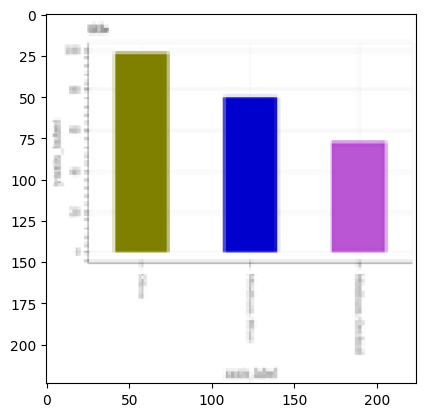

1/1 [==============================] - 0s 31ms/step
Prediction for 42.png: pie


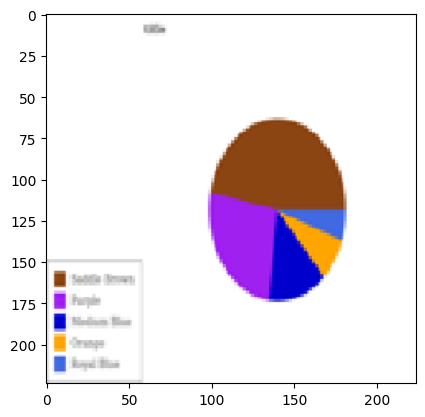

1/1 [==============================] - 0s 33ms/step
Prediction for 21.png: pie


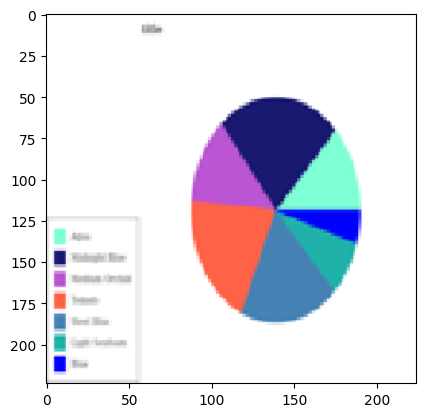

1/1 [==============================] - 0s 32ms/step
Prediction for 19.png: hbar_categorical


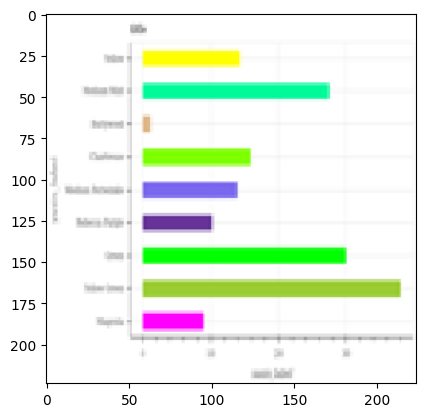

1/1 [==============================] - 0s 23ms/step
Prediction for 34.png: hbar_categorical


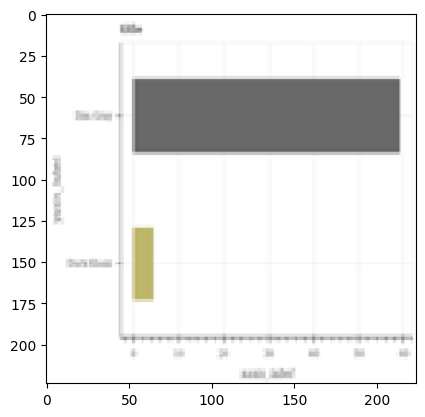

1/1 [==============================] - 0s 21ms/step
Prediction for 23.png: pie


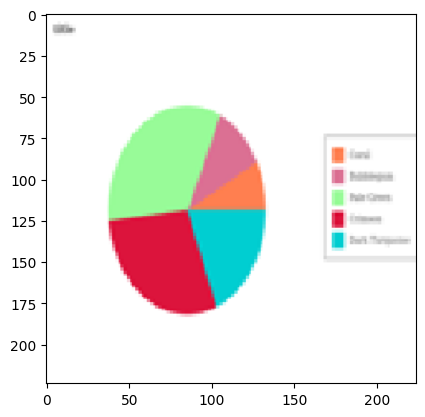

1/1 [==============================] - 0s 22ms/step
Prediction for 24.png: vbar_categorical


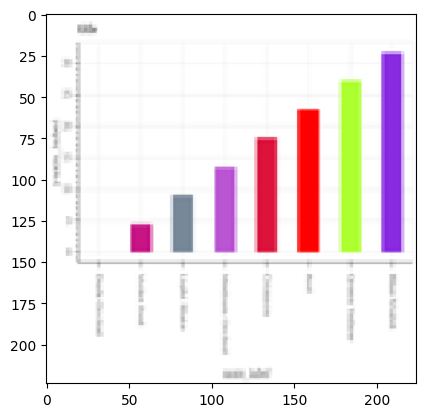

1/1 [==============================] - 0s 25ms/step
Prediction for 16.png: hbar_categorical


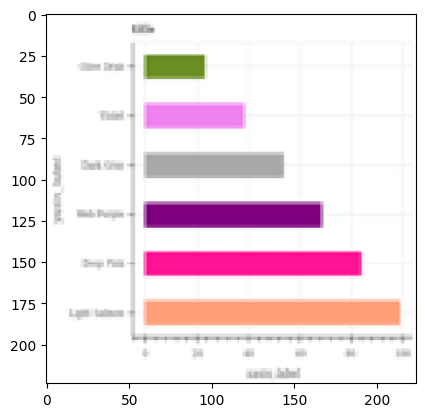

1/1 [==============================] - 0s 25ms/step
Prediction for 29.png: pie


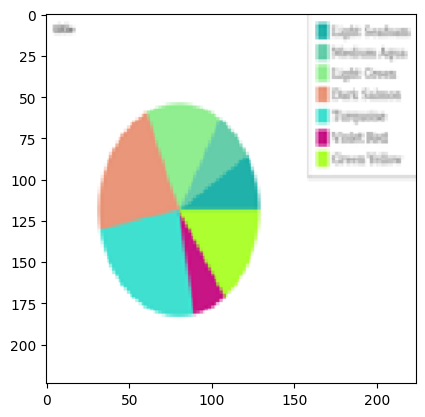

1/1 [==============================] - 0s 24ms/step
Prediction for 1.png: hbar_categorical


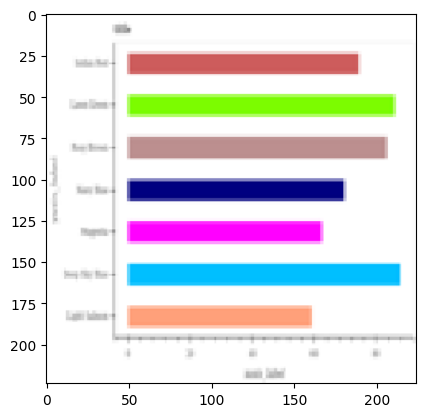

1/1 [==============================] - 0s 23ms/step
Prediction for 18.png: dot_line


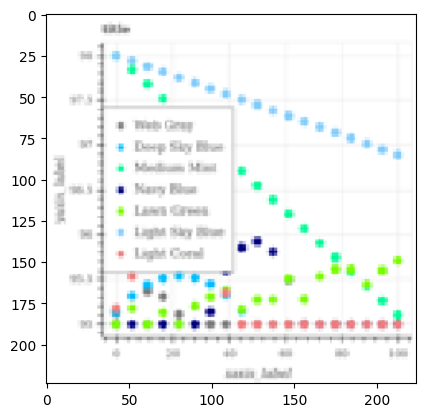

1/1 [==============================] - 0s 24ms/step
Prediction for 14.png: pie


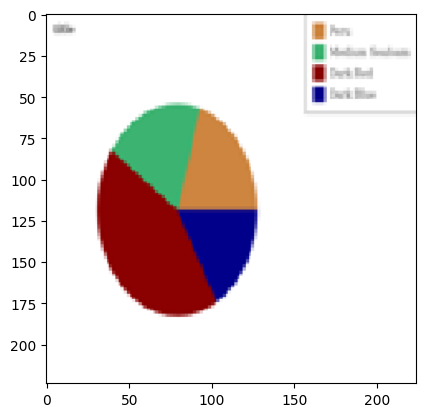

1/1 [==============================] - 0s 25ms/step
Prediction for 3.png: hbar_categorical


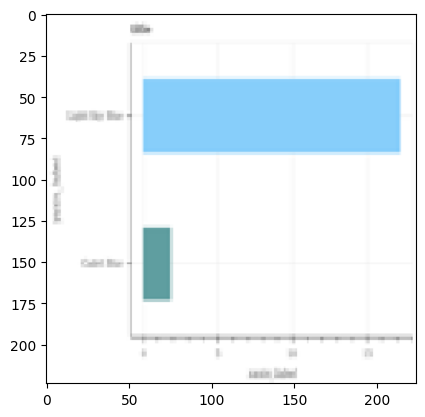

1/1 [==============================] - 0s 24ms/step
Prediction for 32.png: vbar_categorical


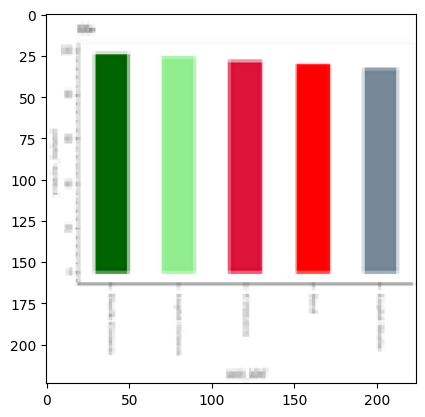

1/1 [==============================] - 0s 23ms/step
Prediction for 11.png: hbar_categorical


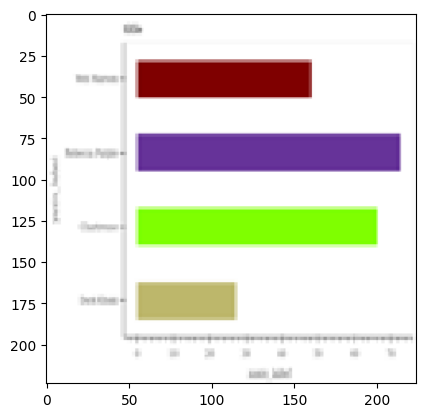

1/1 [==============================] - 0s 23ms/step
Prediction for 2.png: vbar_categorical


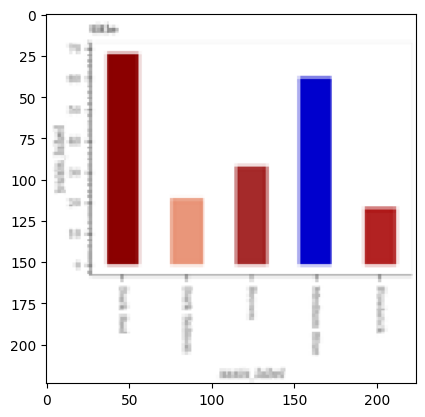

1/1 [==============================] - 0s 23ms/step
Prediction for 35.png: line


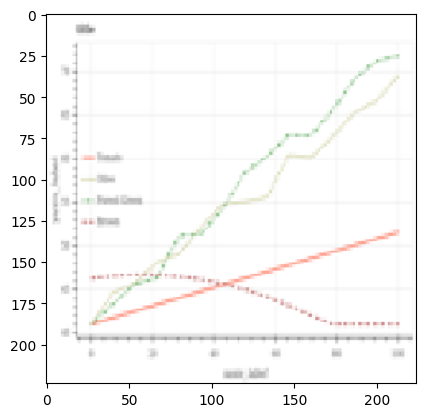

1/1 [==============================] - 0s 23ms/step
Prediction for 26.png: hbar_categorical


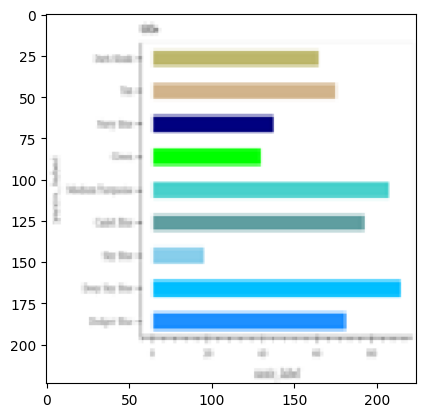

1/1 [==============================] - 0s 22ms/step
Prediction for 15.png: line


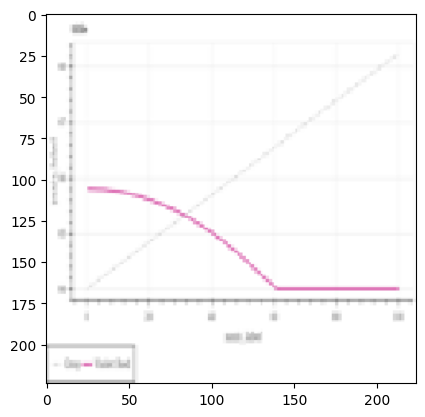

1/1 [==============================] - 0s 23ms/step
Prediction for 44.png: pie


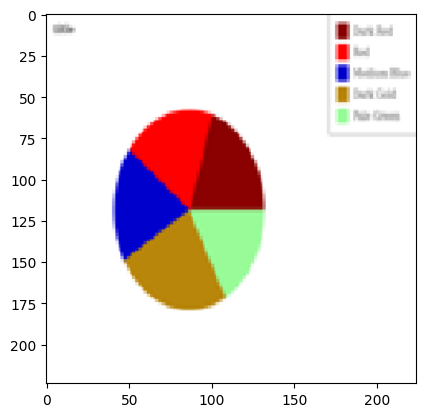

1/1 [==============================] - 0s 23ms/step
Prediction for 30.png: hbar_categorical


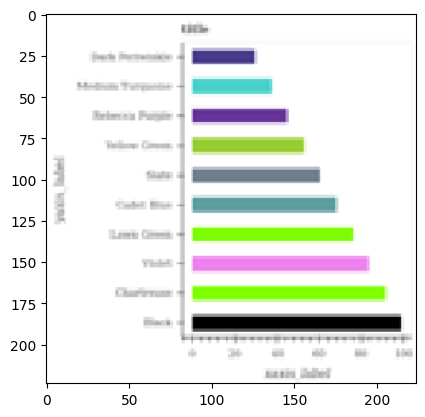

1/1 [==============================] - 0s 22ms/step
Prediction for 28.png: pie


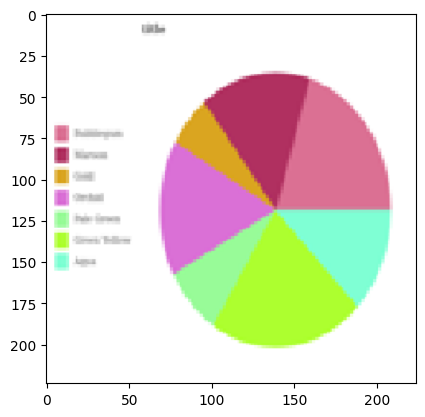

1/1 [==============================] - 0s 23ms/step
Prediction for 17.png: vbar_categorical


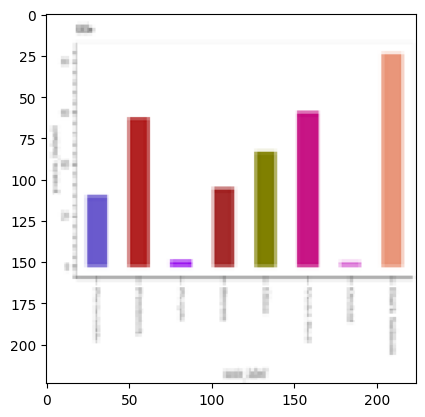

1/1 [==============================] - 0s 24ms/step
Prediction for 45.png: hbar_categorical


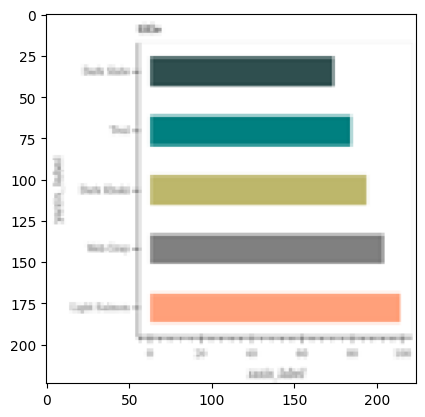

1/1 [==============================] - 0s 25ms/step
Prediction for 27.png: dot_line


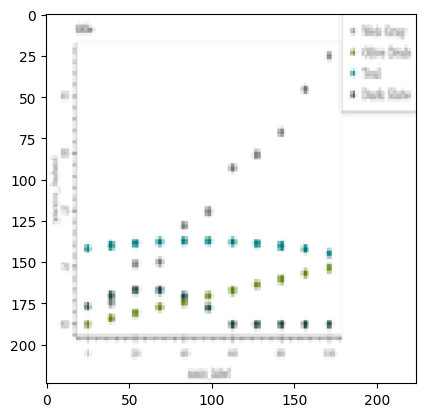

1/1 [==============================] - 0s 22ms/step
Prediction for 31.png: line


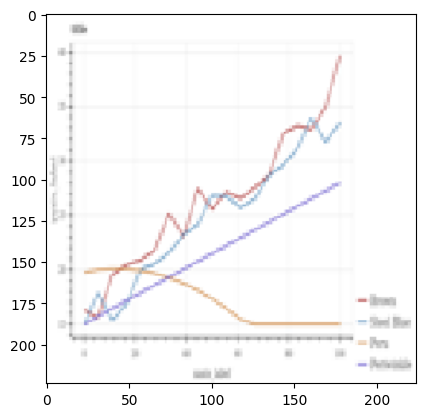

1/1 [==============================] - 0s 24ms/step
Prediction for 20.png: dot_line


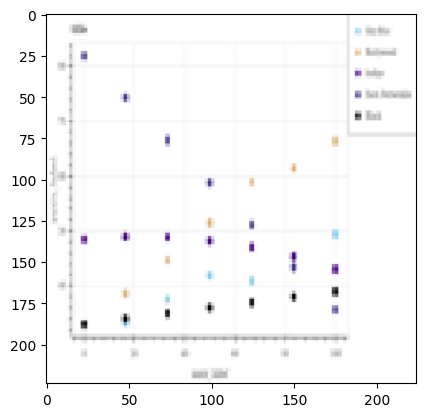

1/1 [==============================] - 0s 24ms/step
Prediction for 25.png: hbar_categorical


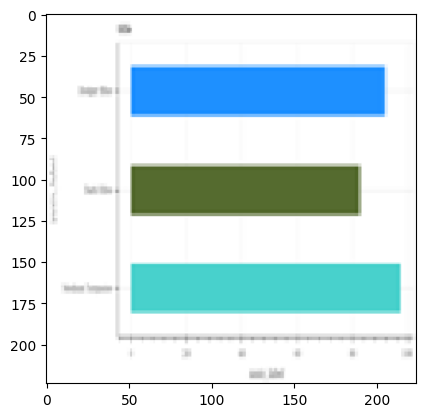

1/1 [==============================] - 0s 23ms/step
Prediction for 0.png: vbar_categorical


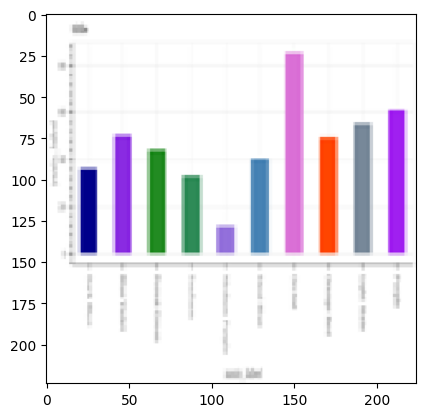

1/1 [==============================] - 0s 28ms/step
Prediction for 12.png: line


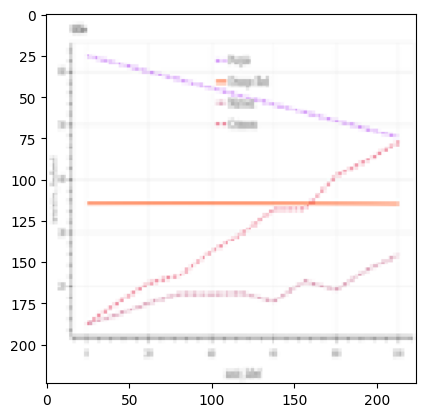

1/1 [==============================] - 0s 22ms/step
Prediction for 10.png: dot_line


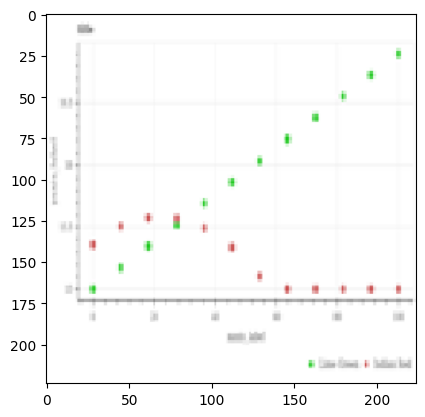

1/1 [==============================] - 0s 23ms/step
Prediction for 22.png: dot_line


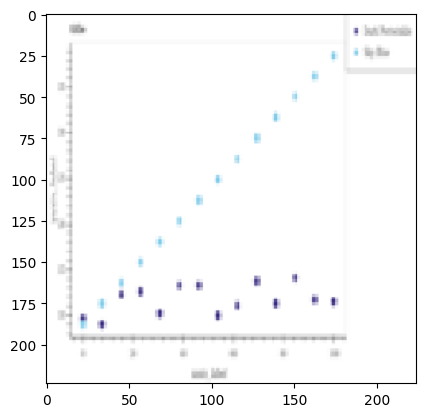

1/1 [==============================] - 0s 22ms/step
Prediction for 13.png: line


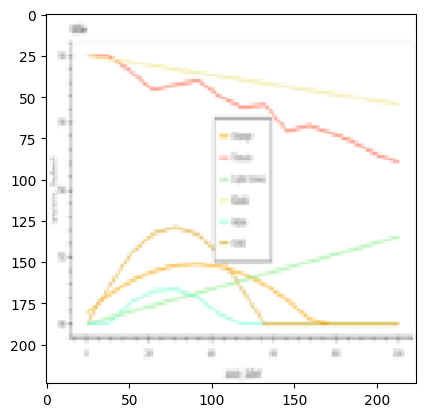

['line', 'line', 'hbar_categorical', 'vbar_categorical', 'dot_line', 'pie', 'line', 'vbar_categorical', 'line', 'vbar_categorical', 'dot_line', 'line', 'pie', 'dot_line', 'line', 'hbar_categorical', 'vbar_categorical', 'vbar_categorical', 'pie', 'pie', 'hbar_categorical', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'pie', 'hbar_categorical', 'dot_line', 'pie', 'hbar_categorical', 'vbar_categorical', 'hbar_categorical', 'vbar_categorical', 'line', 'hbar_categorical', 'line', 'pie', 'hbar_categorical', 'pie', 'vbar_categorical', 'hbar_categorical', 'dot_line', 'line', 'dot_line', 'hbar_categorical', 'vbar_categorical', 'line', 'dot_line', 'dot_line', 'line']


In [47]:
# Evaluate the model on the validation set
val_loss, val_acc = model.evaluate(val_data)
print('Validation Accuracy:', val_acc)
test_dir = '/content/drive/MyDrive/charts/charts/charts/test'
predict_labels(test_dir, model)